# Root Insurance DS assignment

create date: 02/09/2020
modify date: 02/15/2020


This notebook is to complete the DS task from Root Insurance. It splits into 3 big sessions: Data eploration and visualiztion; Calculate the similarity between pairs; Find matched subquences between two temporal sequences


### Data exploration and visualization
this session is mainly to explore the data framework and structure and make a series of plot shown in the pdf. Based on the results, it can help to detect the good strategy to clean/filter the data as well as scale the data into an approiate range for better comparison.

### Calculate the similarity between pairs
this session is to calculate all possible pairs measured in a Dynamic Time Warping (DTW) similarit and keep the top similar pairs for further analysis.

### Find matched subquences between two temporal sequences
this session is to follow up the results from above session to compute subsequence Dynamic Time Warping (DTW) similarity measure between a two time series and return both the path. Based on the returned path, I use it to find the start time and end time for the matched interval between two datasets and draw the plots mentioned in pdf.

reference links:

http://mlpy.sourceforge.net/docs/3.4/dtw.html

https://www.audiolabs-erlangen.de/resources/MIR/FMP/C7/C7S2_SubsequenceDTW.html

https://tslearn.readthedocs.io/en/latest/gen_modules/metrics/tslearn.metrics.dtw_subsequence_path.html

https://openproceedings.org/2017/conf/edbt/paper-369.pdf

In [9]:
import gzip
import json
import pandas as pd
import numpy as np

# plot lib
%matplotlib inline
import matplotlib.pyplot as plt

# datetime
import datetime
import time
fmt = "%a, %d %b %Y %H:%M:%S %Z"

# dynamic time warping
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw
from tslearn.metrics import dtw_subsequence_path

# stat lib
from scipy import stats

In [3]:
# working folder
path='/Users/mzhang/Desktop/SQL/code/telematics_work_sample/'

In [4]:
# load two json.gz datasets
with gzip.open(path+'mobile_trips.json.gz', "rb") as f:
    mobile = json.loads(f.read().decode("ascii"))
    
with gzip.open(path+'obd2_trips.json.gz', "rb") as f:
    obd2 = json.loads(f.read().decode("ascii"))

In [5]:
print('dim of mobile data', pd.DataFrame(mobile).shape)
print('dim of obd2 data', pd.DataFrame(obd2).shape )

dim of mobile data (44, 6740)
dim of obd2 data (41, 3817)


there are 44 trips recorded in mobile and 41 trips recorded in obd2

In [82]:
# view the example from mobile data
j=1
for i in range(5):
    print(mobile[j][i])

{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690662.0001, 'speed': 3.31, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690663, 'speed': 5.11, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690664.0001, 'speed': 6.83, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690665, 'speed': 9.79, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690666.0001, 'speed': 14.47, 'accuracy': 50}


there are 5 variables in mobile data: trip_id, created_at, timestamp, speed and accuracy

In [6]:
# check if 'created_at' values are identical given 'trip_id'
j=1
test= pd.DataFrame(columns=['created_at'], index=range(len(mobile[j])))
cnt=0
for i in range(len(mobile[j])):
    test.loc[cnt, 'created_at']=mobile[j][i]['created_at']
    cnt+=1

In [7]:
set(test.created_at) # it's identical

{1494706078.6895}

In [8]:
# create a list to load all accuracy values

accuracy_list= []

for i in range(len(mobile)):    
    accuracy= [value['accuracy'] for value in mobile[i]]
    accuracy_list = [*accuracy_list, *accuracy]    

In [10]:
# calculate Q3 and IOR

Q3= np.percentile(accuracy_list, 75)
IQR= stats.iqr(accuracy_list)

In [11]:
# calculate the upper bound for outliers, max= Q3 + 1.5*IQR 
accuracy_threshold= Q3 +1.5*IQR
accuracy_threshold

17.5

The max based on Q3+1.5*IQR is 17.5. Based on the description, lower value = more accurate I plan to drop mobile records with accuracy above 17.5 when I plot two time-speed scatter plots.

In [70]:
# view the example from obd2 data
j=1
for i in range(5):
    print(obd2[j][i])

{'trip_id': 'trip_TAU99985_000002', 'timestamp': 1.122, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 2.159, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 3.123, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 4.138, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 5.082, 'speed': 0}


there are only 3 variables in obd2 data: trip_id, timestamp and speed. The timestamp in the 2 data are relative to different reference.

In [12]:
# make the table to count how many records were taken given each trip_id for mobile data
mobile_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(mobile)))
cnt= 0

for i in range(len(mobile)):
    mobile_table.loc[cnt, 'trip_id']= mobile[i][0]['trip_id']
    mobile_table.loc[cnt, 'records']= len(mobile[i])
    cnt+=1

In [13]:
mobile_table.head()

,trip_id,records
0,5305845D-61F4-40EB-BE97-F304DFFD4C36,1119
1,C2AE5742-E987-4745-ADA1-2535BCB5AD3E,1004
2,629D24C3-A426-4F97-A83B-6BE9107DD681,1455
3,E65118A9-0673-4BE1-AB66-292DBEED99AD,857
4,A7B3488C-B851-48BA-B26E-E685F250AA99,995


In [14]:
# # make the table to count how many records were taken given each trip_id for obd2 data

obd2_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(obd2)))
cnt= 0

for i in range(len(obd2)):
    obd2_table.loc[cnt, 'trip_id']= obd2[i][1]['trip_id']
    obd2_table.loc[cnt, 'records']= len(obd2[i])
    cnt+=1

In [15]:
obd2_table.head()

,trip_id,records
0,trip_TAU99985_000000,1235
1,trip_TAU99985_000002,1302
2,trip_TAU99985_000003,1032
3,trip_TAU99985_000010,1105
4,trip_TAU99985_000011,652


the time records for both data are irregular

#### Find the right time reference

Since the timestamp is relative to different reference, I first need to convert to the same/close scale in order to find the matched interval. Based on the notice in the introduction pdf, it uses (epoch) second. So I convert epoch to human-readable date

In [16]:
j=1
for i in range(5):
    s= mobile[j][i]['timestamp']
    t = time.strftime("%a, %d %b %Y %H:%M:%S %Z", time.localtime(s))

    print('time: ', t)

time:  Sat, 13 May 2017 08:51:02 PDT
time:  Sat, 13 May 2017 08:51:03 PDT
time:  Sat, 13 May 2017 08:51:04 PDT
time:  Sat, 13 May 2017 08:51:05 PDT
time:  Sat, 13 May 2017 08:51:06 PDT


#### plot demo figures to visualize the data

plot first 4 pairs time-speed scatter plots to get a sense how I should match two datasets on the same scale and find the matched interval

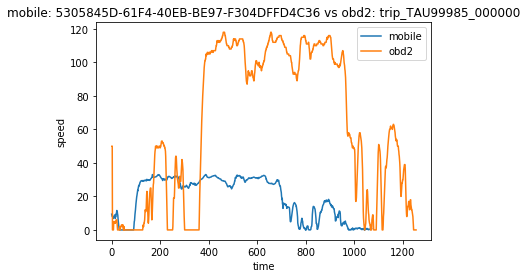

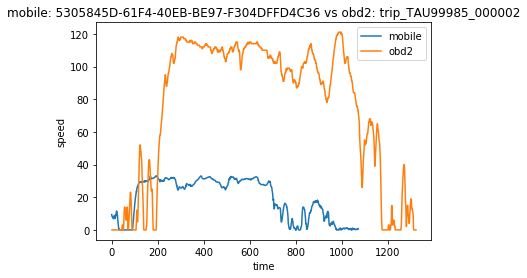

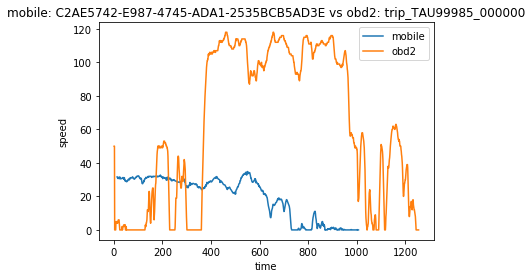

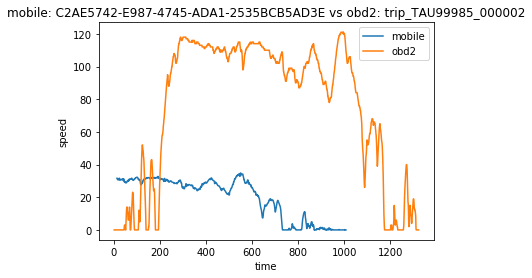

In [17]:
# draw a few plots to check if the two times are on the same scale now

for i in range(2):
    mobile_id= mobile[i][0]['trip_id']
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec', 'speed'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        
        if value['accuracy'] > 17.5:
            continue
        
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        mobile_time.loc[cnt, 'speed']= value['speed']
        cnt+=1
    
    x1= mobile_time['sec']
    y1= mobile_time['speed']
    
    
    for j in range(2):
        obd2_id= obd2[j][0]['trip_id']
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]

        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.show()


### Conclusion for data exploration

There are 44 trips recorded in mobile and 41 trips recorded in obd2; 

5 variables in mobile data: trip_id, created_at, timestamp, speed and accuracy; 3 variables in obd2 data: trip_id, timestamp and speed; the timestamp in the 2 data are relative to different reference.

timestamp in mobile data: use epoch time (seconds), which can transfer to real time.

timestamp in obd2 data: count the seconds after ignite the car, the starting point should be 0.

two times are roughly on the same scale and the speeds are not on the same scale.

Based on the accuracy columns in mobile data, 17.5 is a good strat threshold to filter out low-quality mobile speed record.
 
#### Next

1. normalize both time and speed and make sure they are on the scale 0-1.
2. use dynamic time warping (DTW, actually fastdtw) to compare the smiliarity of two signals
3. filter out low-similar (high-distance) pairs
4. find the matched subsequences among kept pairs

## Calculate the similarity between pairs

In [18]:
# there should be 44*41 possible pairs
# I also add a filtering layer to drop those time record in mobile data if the accuracy score above 17.5
# in addition, I drop those trips with zero speed all the time
# I normalize the speed into 0-1 scale in order to reduce the magnitude of overall distance

dist_table= pd.DataFrame(columns=['mobile_id', 'obd2_id', 'distance'], index=range(len(mobile)*len(obd2)))
cnt=0

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
       
    if sum(y1)==0:
        continue
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        y2= [value['speed'] for value in obd2[j]]
        
        if sum(y2)==0:
            continue
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        d, p = fastdtw(y1, y2, dist=euclidean)
        
        dist_table.loc[cnt, 'mobile_id']= mobile_id
        dist_table.loc[cnt, 'obd2_id']= obd2_id
        dist_table.loc[cnt, 'distance']= d
        
        cnt+=1

In [19]:
dist_table.head()

,mobile_id,obd2_id,distance
0,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000000,43.5121
1,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000002,63.125
2,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000003,58.4799
3,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000010,61.2481
4,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000011,72.3772


In [20]:
dist_table.tail()

,mobile_id,obd2_id,distance
1799,NaN,NaN,NaN
1800,NaN,NaN,NaN
1801,NaN,NaN,NaN
1802,NaN,NaN,NaN
1803,NaN,NaN,NaN


In [21]:
dist_table.dropna().shape

(1760, 3)

there are total 1760 pass the filtering and calculated the distance

In [22]:
# save the similarity distance table

dist_table= dist_table.dropna()
dist_table.to_csv(path+'DTW_dist_normalize_table.csv', index=None, sep=',')

### load DTW distance table

In [23]:
#dist_table= pd.read_csv(path+'DTW_dist_table.csv', sep=',')
dist_table= pd.read_csv(path+'DTW_dist_normalize_table.csv', sep=',')

In [24]:
dist_table.shape

(1760, 3)

based on the information, Some trips from each source may not have any match from the other source.
Moreover, some trips from one source might match to multiple trips from the other source because trip start / trip end events differ by source.
I assume there are roughly 60 matched trips so I calculate the percentile corresponds to 60 trips

In [38]:
cutoff= np.percentile(dist_table.distance, (60/dist_table.shape[0])*100  )
print(cutoff)
dist_table_top = dist_table[dist_table.distance<=cutoff]

47.331005484694366


In [39]:
dist_table_top.shape

(60, 3)

In [40]:
# select the top percentile mobile_id
mobile_select= set(dist_table_top.mobile_id)

mobile_list=[]

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id in mobile_select:
        mobile_list.append(mobile_id)

# select the top percentile obd2_id
obd2_select= set(dist_table_top.obd2_id)

obd2_list=[]

for i in range(len(obd2)):
    obd2_id= obd2[i][0]['trip_id']
    
    if obd2_id in obd2_select:
        obd2_list.append(obd2_id)

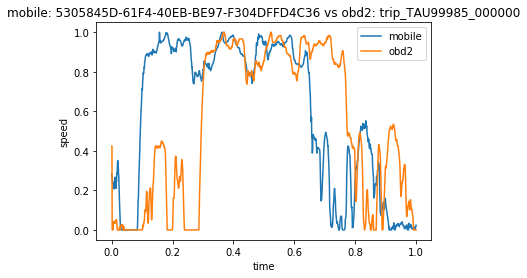

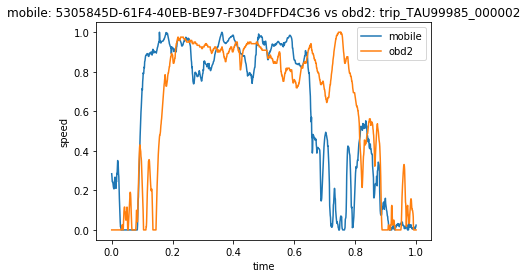

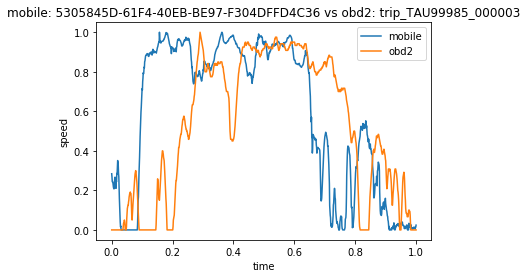

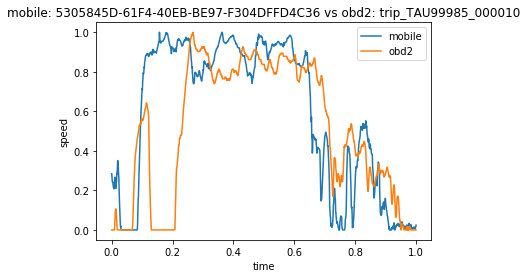

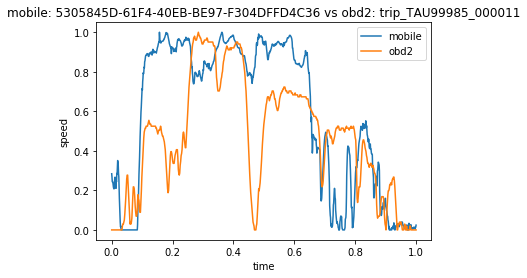

...

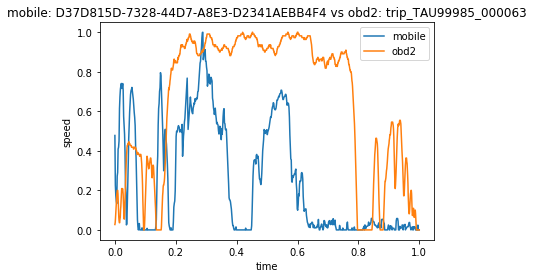

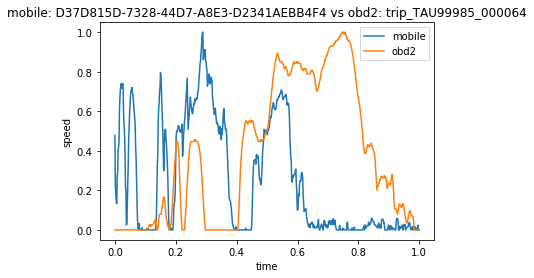

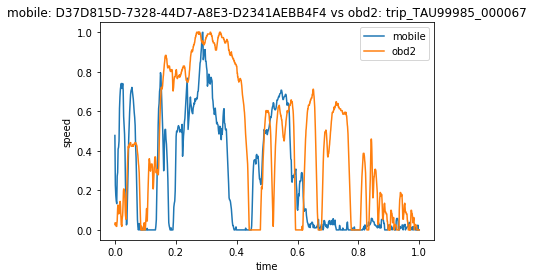

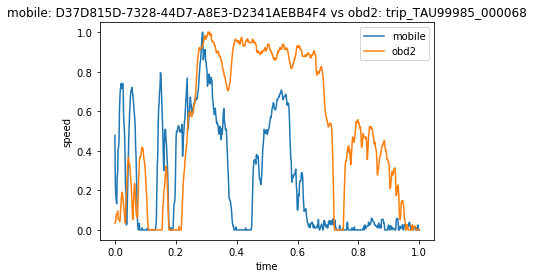

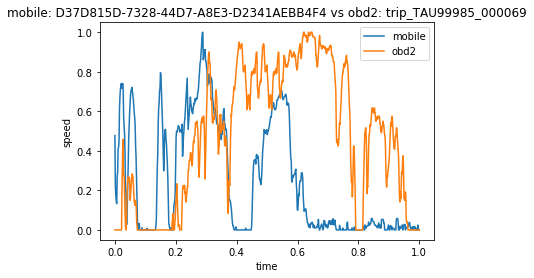

In [42]:
# draw the plots to check how two time series loo like after filtering and thresholding

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec', 'speed'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        
        if value['accuracy'] > 17.5:
            continue
        
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        mobile_time.loc[cnt, 'speed']= value['speed']
        cnt+=1
    
    x1= mobile_time['sec']
    y1= mobile_time['speed']
    if sum(y1)==0:
        continue
        
    x1= np.asarray(x1)
    x1= (x1-min(x1))/(max(x1)-min(x1))    
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed']/2 for value in obd2[j]]
        if sum(y2)==0:
            continue
        
        x2= np.asarray(x2)
        x2= (x2-min(x2))/(max(x2)-min(x2))
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.show()

Based on the figures, we can see some tirp pairs have high matched interval. Next I will find the matched subsequence

### Find matched subquences between two temporal sequences

In [45]:
# choose the highly similar pairs to do the demo by using subsequence DTW package

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    if mobile_id!= '629D24C3-A426-4F97-A83B-6BE9107DD681':
        continue
        
    y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
    
    if sum(y1)==0:
        continue
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        if obd2_id!= 'trip_TAU99985_000002':    
            continue
        y2= [value['speed'] for value in obd2[j]]
        
        if sum(y2)==0:
            continue
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        p, d = dtw_subsequence_path(y1, y2) 

In [46]:
# take the index
mobile_index= [o[0] for o in p]
obd2_index= [o[1] for o in p]

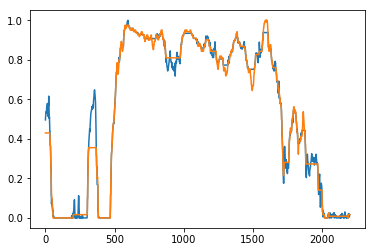

In [47]:
plt.plot([y1[i] for i in mobile_index] , label='mobile')
plt.plot([y2[i] for i in obd2_index], label='obd2')

now the plot looks pretty good and next I optimize my code and turn the searching matched subsequences precoss into an automatic framework. Due to the fact I drop time records based on accuracy score 17.5, it makes some mobile temporal subsequnces are little flat. Therefore, I loss my threshold to 100 and check the plots. Again, I made the assumption that the obd2 speed should be accuracy and treat it as the baseline. 

In addition, I print out the start point and end point as requested. I also print out the similaritydistance measure for reference. Ideally, the similarity distance should be 0. 

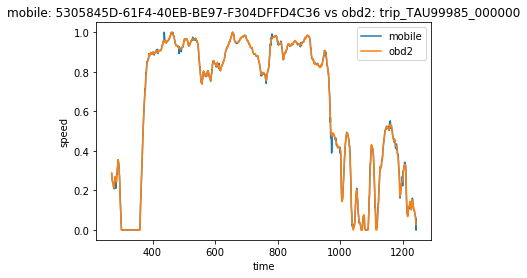

start point 1494683921 269.429
end point 1494685017 1243.374
similarity distance 0.30503007606319826


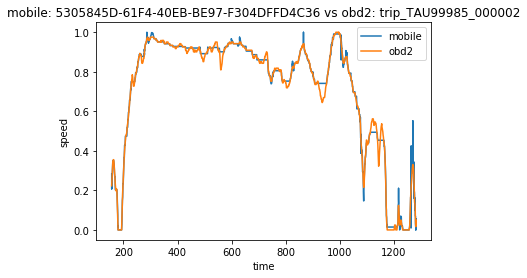

start point 1494683921 156.706
end point 1494685017 1281.418
similarity distance 1.6084804711411915


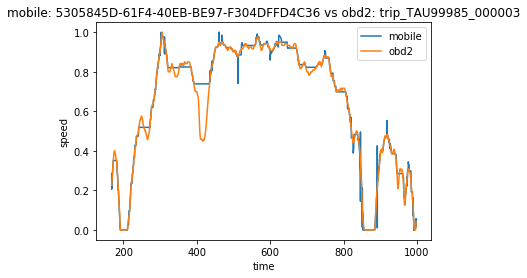

start point 1494683921 168.358
end point 1494685017 997.451
similarity distance 1.8383585229298538


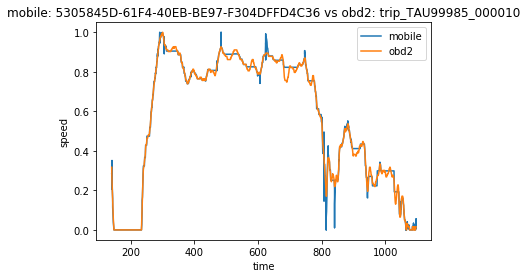

start point 1494683921 139.991
end point 1494685017 1096.85
similarity distance 1.6046896048918455


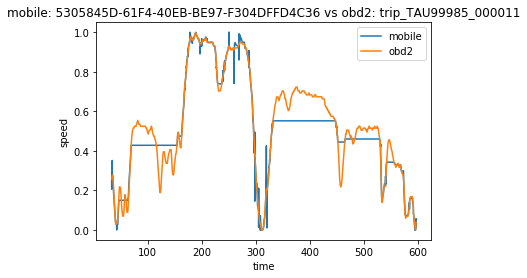

start point 1494683921 33.652
end point 1494685017 596.664
similarity distance 2.2364686907407


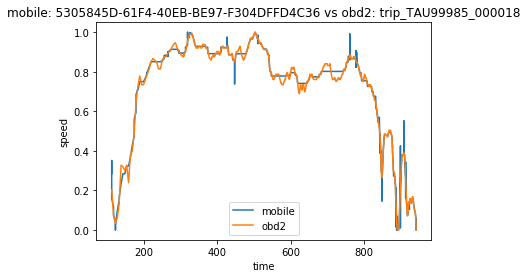

start point 1494683921 112.225
end point 1494685017 940.843
similarity distance 1.6571852623996113


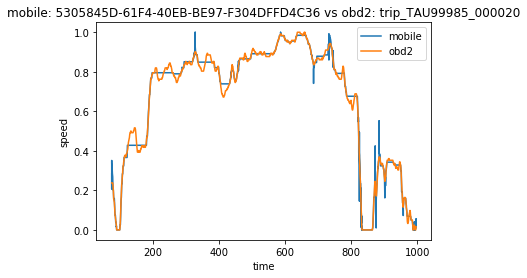

start point 1494683921 75.465
end point 1494685017 996.746
similarity distance 1.643197373084147


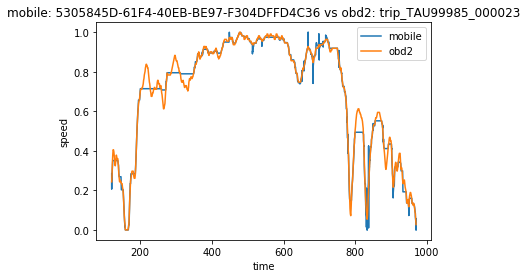

start point 1494683921 120.553
end point 1494685017 969.926
similarity distance 1.3936327626902036


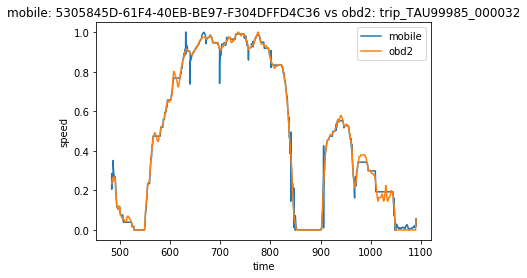

start point 1494683921 483.763
end point 1494685017 1090.45
similarity distance 1.6887899899748984


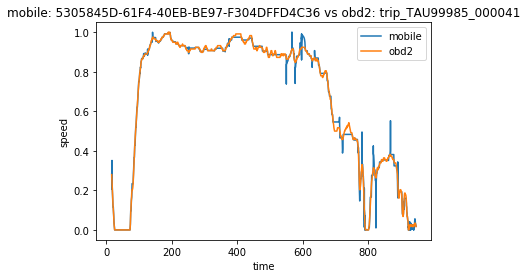

start point 1494683921 16.38
end point 1494685017 945.44
similarity distance 1.6199540794014504


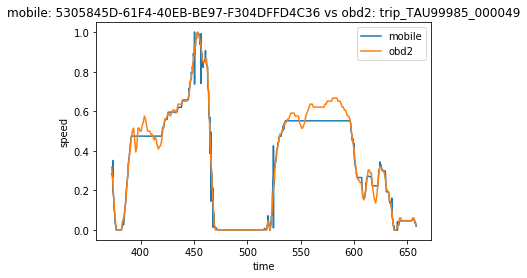

start point 1494683921 373.011
end point 1494685017 658.051
similarity distance 1.9701172472425084


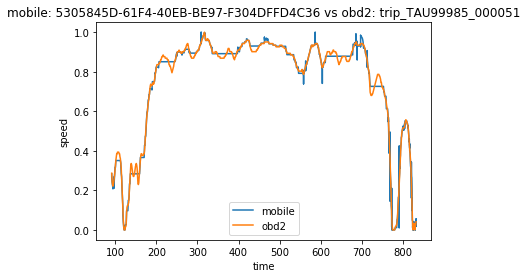

start point 1494683921 91.413
end point 1494685017 831.561
similarity distance 1.3360862706099563


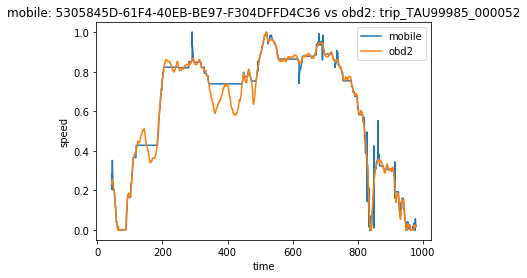

start point 1494683921 44.306
end point 1494685017 978.644
similarity distance 2.136192356474404


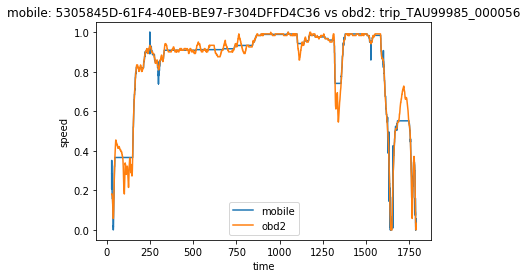

start point 1494683921 28.868
end point 1494685017 1789.112
similarity distance 1.9758647037577612


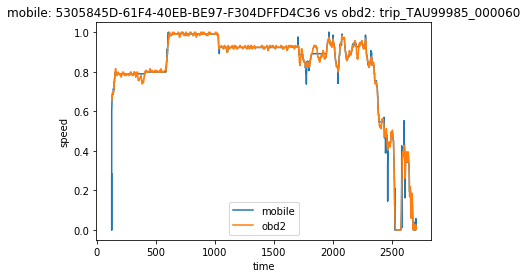

start point 1494683921 127.827
end point 1494685017 2702.061
similarity distance 5.923148861646207


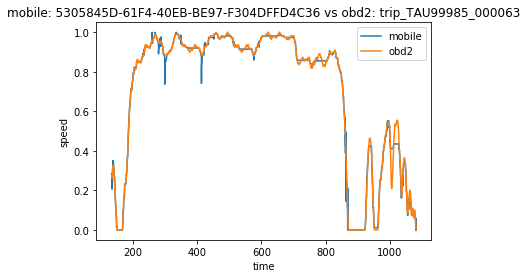

start point 1494683921 133.902
end point 1494685017 1081.929
similarity distance 1.3865369892499684


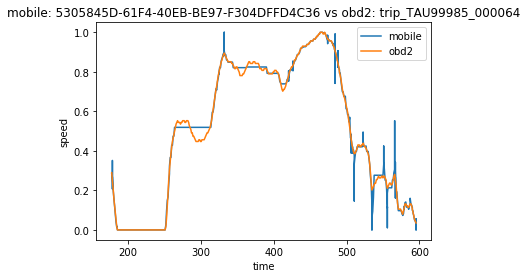

start point 1494683921 177.86
end point 1494685017 595.348
similarity distance 2.4218127055548653


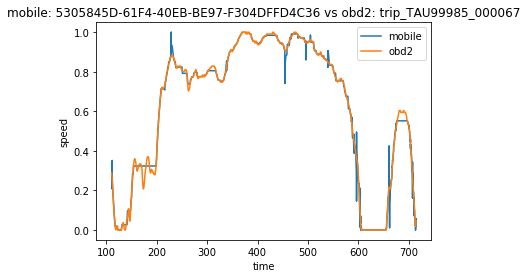

start point 1494683921 110.687
end point 1494685017 714.382
similarity distance 1.6459928299765754


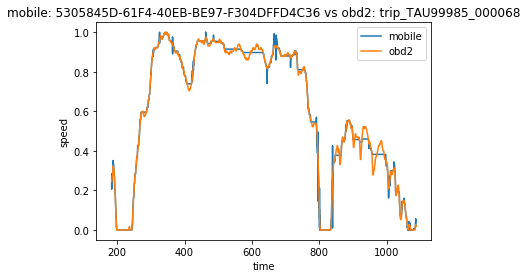

start point 1494683921 183.639
end point 1494685017 1087.736
similarity distance 1.335983288641922


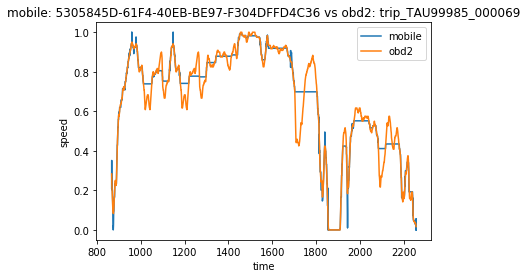

start point 1494683921 867.303
end point 1494685017 2256.314
similarity distance 2.362319509038925


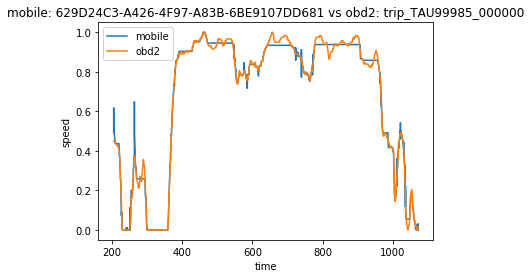

start point 1494700273.9997 205.351
end point 1494701728.0002 1071.789
similarity distance 1.71446448417989


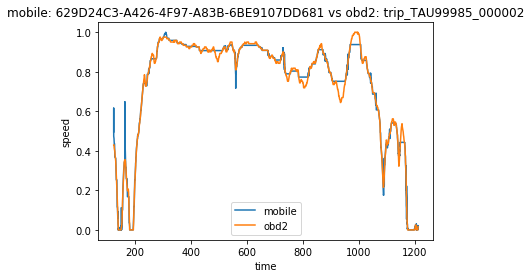

start point 1494700273.9997 122.946
end point 1494701728.0002 1211.807
similarity distance 1.845770421714511


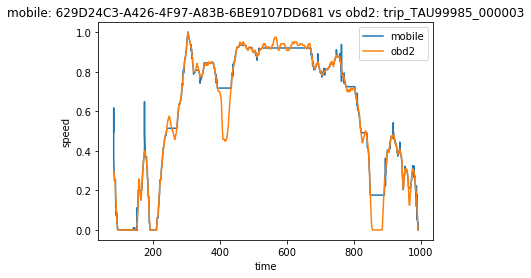

start point 1494700273.9997 83.656
end point 1494701728.0002 992.377
similarity distance 2.4625218334209604


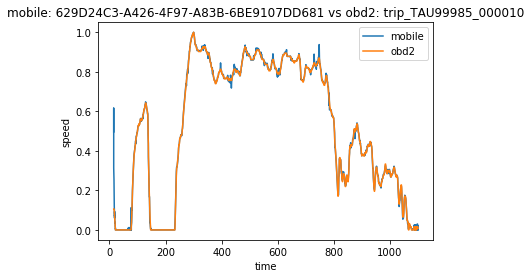

start point 1494700273.9997 15.438
end point 1494701728.0002 1099.923
similarity distance 2.558928736085207


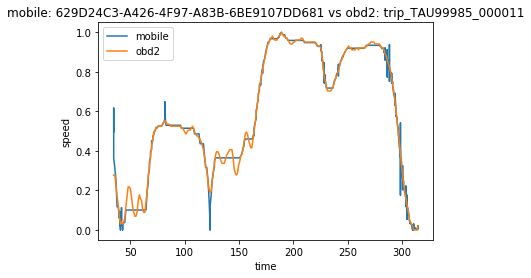

start point 1494700273.9997 34.689
end point 1494701728.0002 314.622
similarity distance 2.715648388139818


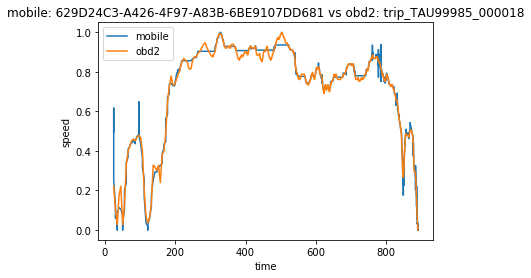

start point 1494700273.9997 25.631
end point 1494701728.0002 889.962
similarity distance 2.212163899865625


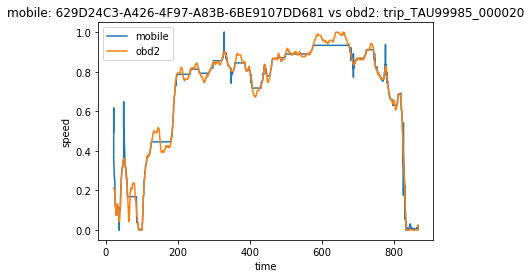

start point 1494700273.9997 21.488
end point 1494701728.0002 865.838
similarity distance 2.815567993409291


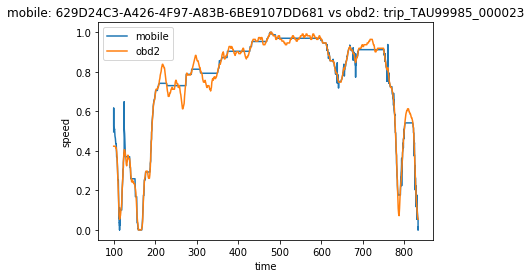

start point 1494700273.9997 99.211
end point 1494701728.0002 833.395
similarity distance 1.9204641004896967


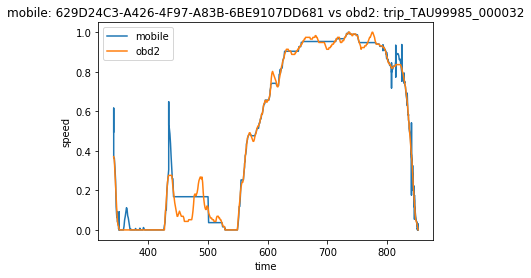

start point 1494700273.9997 341.925
end point 1494701728.0002 851.8
similarity distance 2.74086233371936


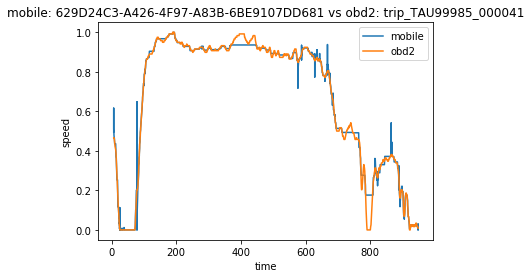

start point 1494700273.9997 6.423
end point 1494701728.0002 948.35
similarity distance 3.5060413286916385


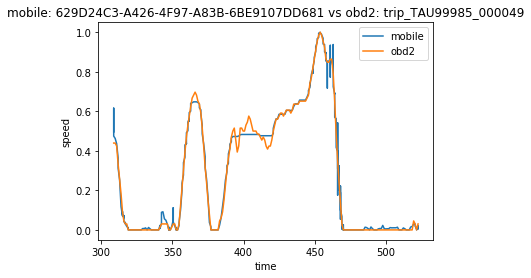

start point 1494700273.9997 308.862
end point 1494701728.0002 522.407
similarity distance 1.7259416463628228


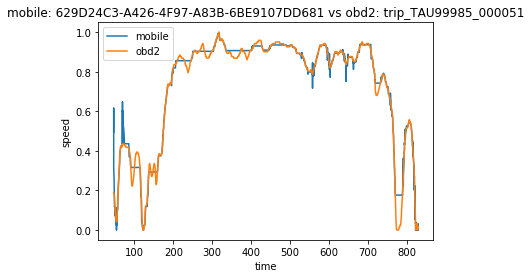

start point 1494700273.9997 46.617
end point 1494701728.0002 829.49
similarity distance 2.5585198658032833


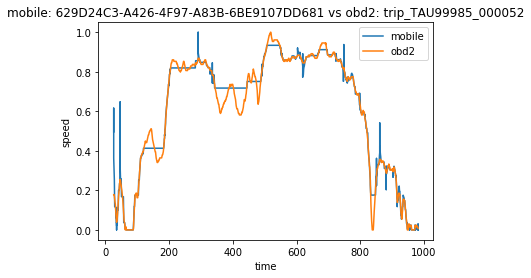

start point 1494700273.9997 25.992
end point 1494701728.0002 981.73
similarity distance 3.4646905302435536


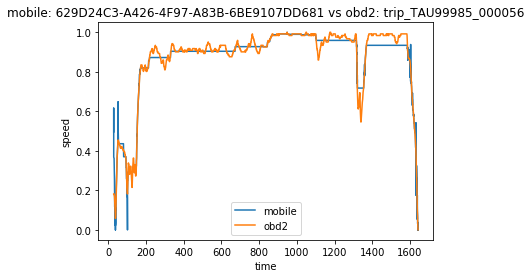

start point 1494700273.9997 28.868
end point 1494701728.0002 1642.564
similarity distance 3.4101912344436607


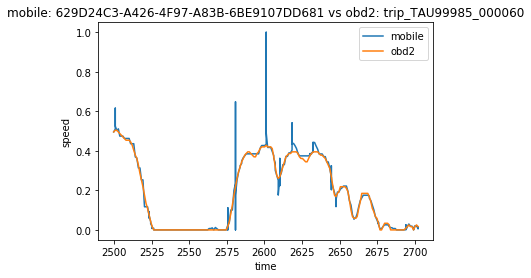

start point 1494700273.9997 2499.813
end point 1494701728.0002 2702.061
similarity distance 10.115685216913123


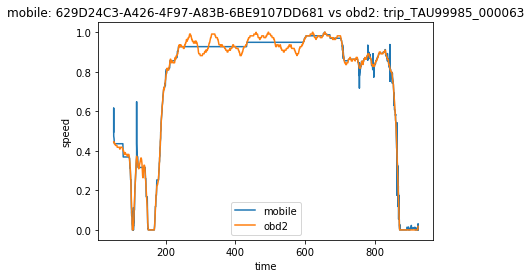

start point 1494700273.9997 50.947
end point 1494701728.0002 923.626
similarity distance 2.054514414790278


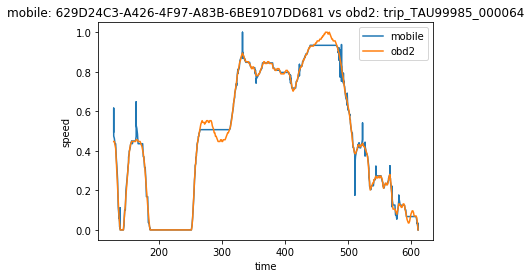

start point 1494700273.9997 127.9
end point 1494701728.0002 610.745
similarity distance 1.5886189826233499


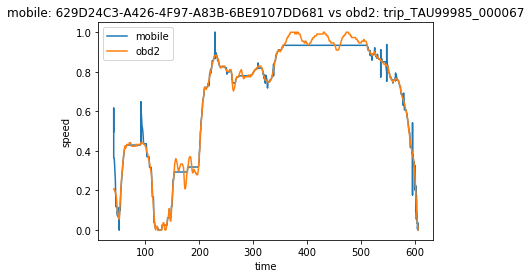

start point 1494700273.9997 41.053
end point 1494701728.0002 605.576
similarity distance 2.69283311945548


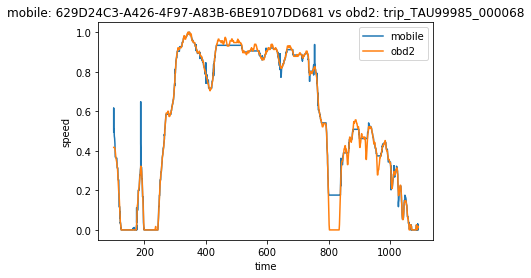

start point 1494700273.9997 99.626
end point 1494701728.0002 1091.848
similarity distance 2.2099406476463184


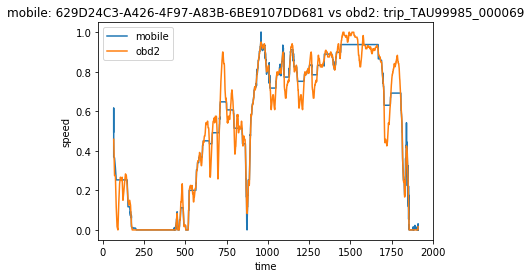

start point 1494700273.9997 66.688
end point 1494701728.0002 1910.254
similarity distance 2.588178900516607


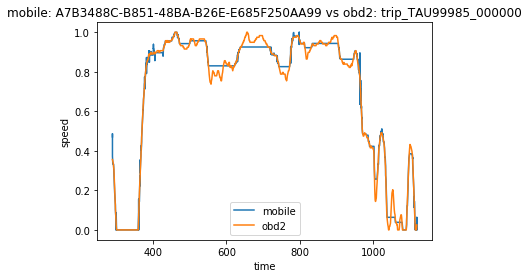

start point 1494787811.0002 289.55
end point 1494788810.9996 1118.994
similarity distance 1.2604253052196563


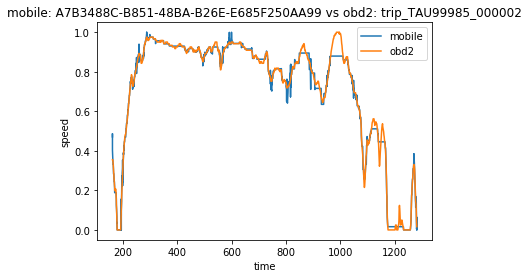

start point 1494787811.0002 162.888
end point 1494788810.9996 1280.375
similarity distance 1.0678398657958437


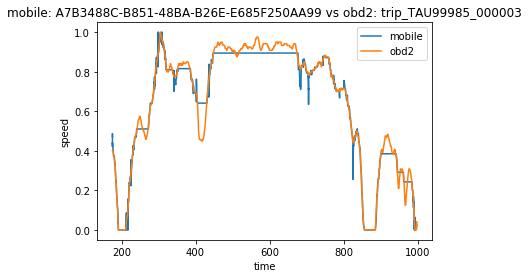

start point 1494787811.0002 175.565
end point 1494788810.9996 997.451
similarity distance 1.412022439937001


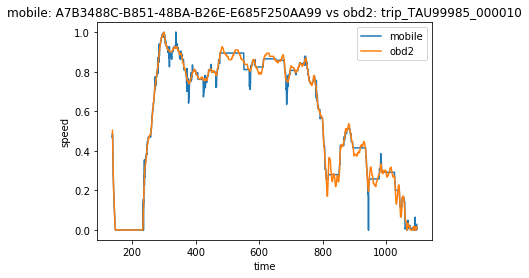

start point 1494787811.0002 137.939
end point 1494788810.9996 1096.85
similarity distance 1.0389471427385344


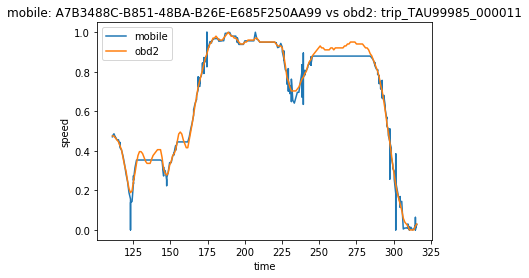

start point 1494787811.0002 111.163
end point 1494788810.9996 315.566
similarity distance 1.3541460435066146


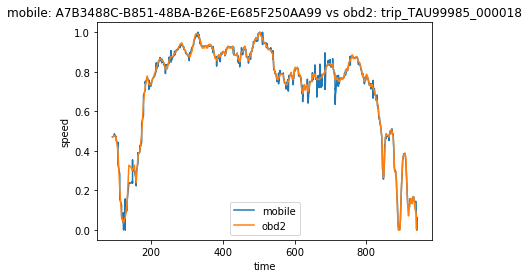

start point 1494787811.0002 91.856
end point 1494788810.9996 940.843
similarity distance 0.6365140965213439


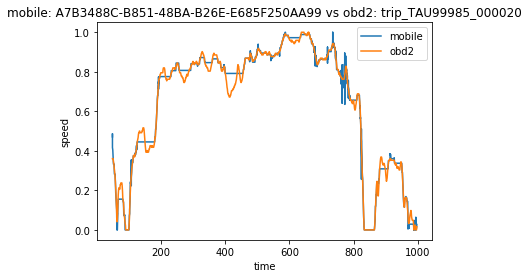

start point 1494787811.0002 49.172
end point 1494788810.9996 996.746
similarity distance 1.2283057525862993


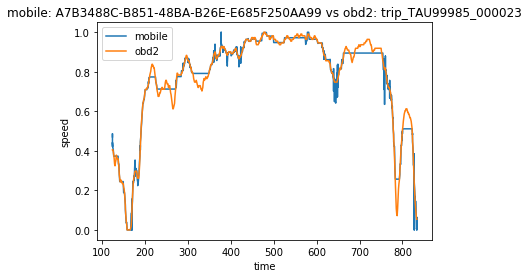

start point 1494787811.0002 124.514
end point 1494788810.9996 833.395
similarity distance 1.4556124255214982


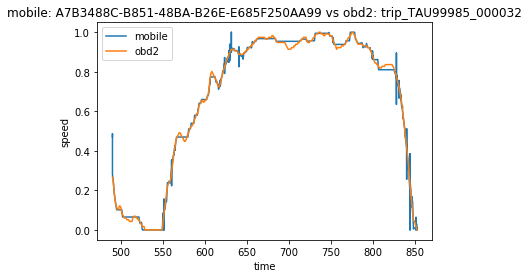

start point 1494787811.0002 489.844
end point 1494788810.9996 851.8
similarity distance 1.482838012724287


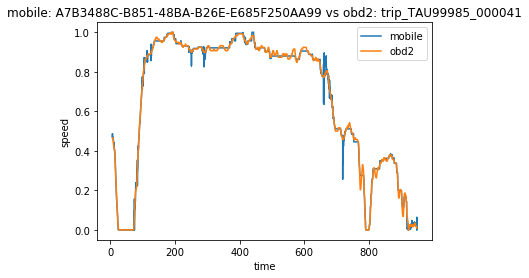

start point 1494787811.0002 6.423
end point 1494788810.9996 948.35
similarity distance 1.0508208307197262


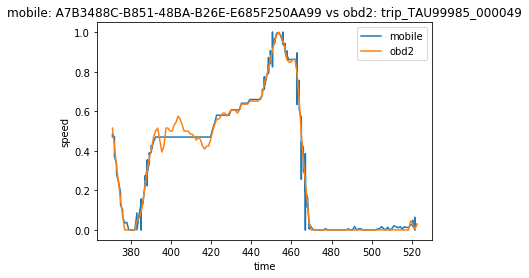

start point 1494787811.0002 370.973
end point 1494788810.9996 522.407
similarity distance 1.5025502880904906


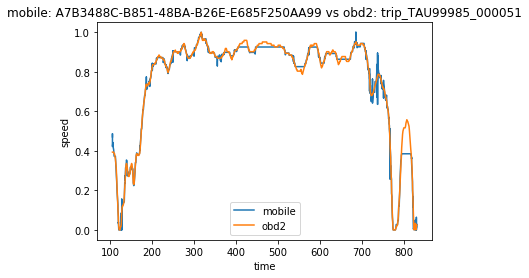

start point 1494787811.0002 105.513
end point 1494788810.9996 830.526
similarity distance 1.1087891888506136


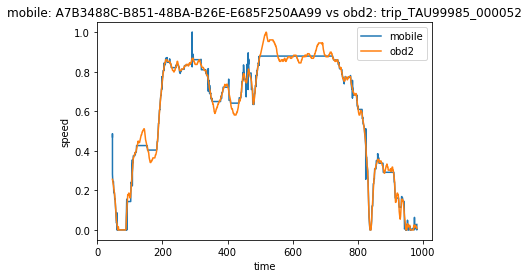

start point 1494787811.0002 46.345
end point 1494788810.9996 981.73
similarity distance 1.5037691920434595


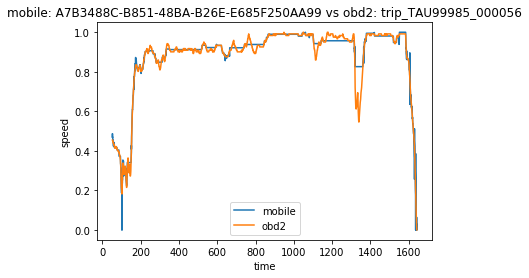

start point 1494787811.0002 52.215
end point 1494788810.9996 1642.564
similarity distance 1.8687505706944456


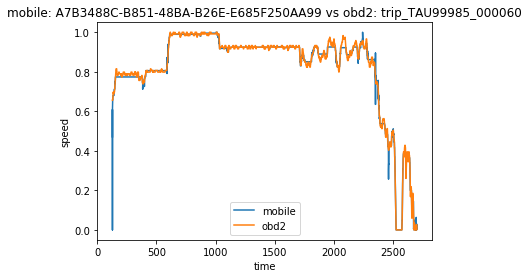

start point 1494787811.0002 127.827
end point 1494788810.9996 2701.024
similarity distance 3.795609534476173


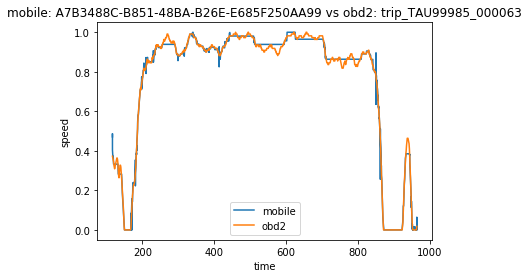

start point 1494787811.0002 116.676
end point 1494788810.9996 963.46
similarity distance 1.1735401410270732


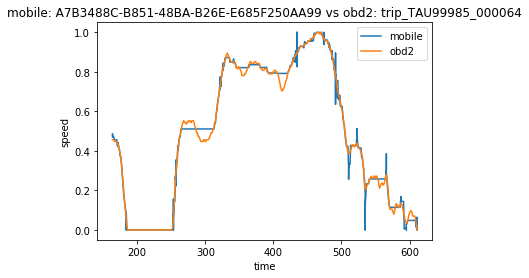

start point 1494787811.0002 163.516
end point 1494788810.9996 610.745
similarity distance 1.3301088977103004


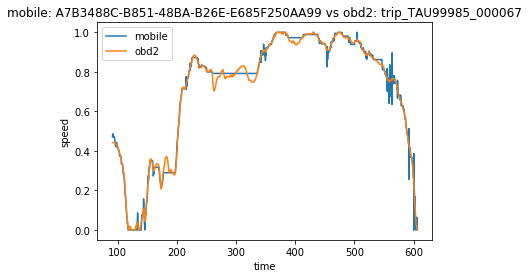

start point 1494787811.0002 91.424
end point 1494788810.9996 605.576
similarity distance 1.3678488004731524


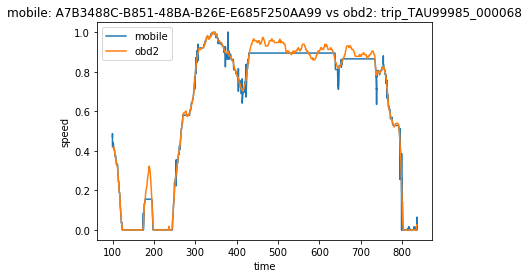

start point 1494787811.0002 99.626
end point 1494788810.9996 835.545
similarity distance 1.4175467659227083


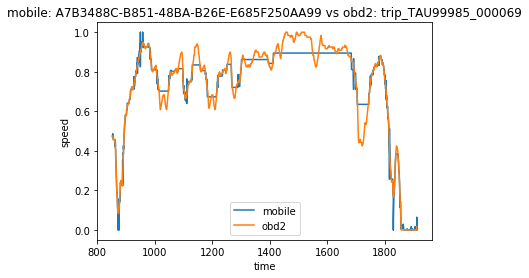

start point 1494787811.0002 854.098
end point 1494788810.9996 1910.254
similarity distance 1.7761381095466755


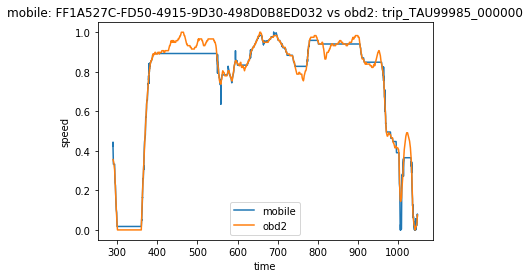

start point 1494792475.9997 289.55
end point 1494793456.0001 1048.226
similarity distance 1.1641592306521114


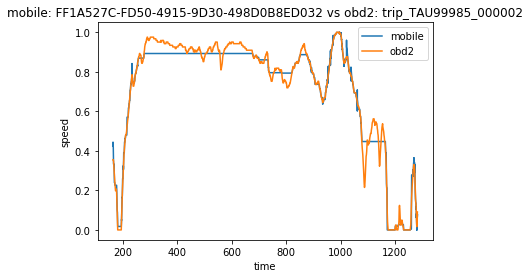

start point 1494792475.9997 162.888
end point 1494793456.0001 1282.433
similarity distance 1.4002901042094087


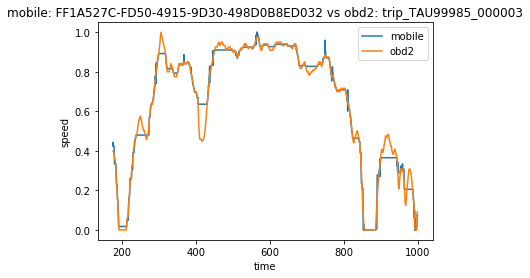

start point 1494792475.9997 175.565
end point 1494793456.0001 998.396
similarity distance 1.1929696292921412


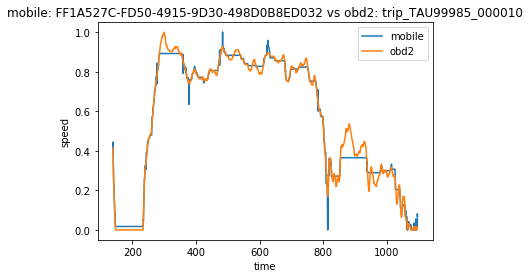

start point 1494792475.9997 138.953
end point 1494793456.0001 1096.85
similarity distance 1.3335036079096374


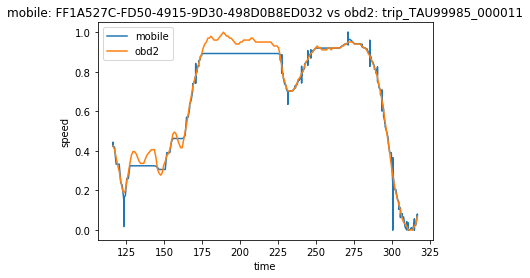

start point 1494792475.9997 116.217
end point 1494793456.0001 316.602
similarity distance 1.3046786700768076


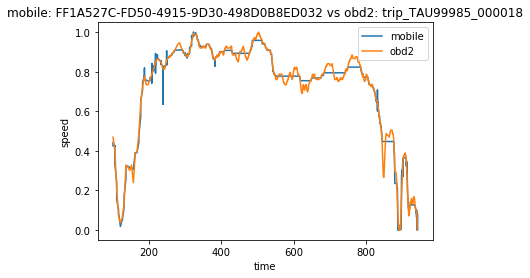

start point 1494792475.9997 102.04
end point 1494793456.0001 940.843
similarity distance 1.1244856195256012


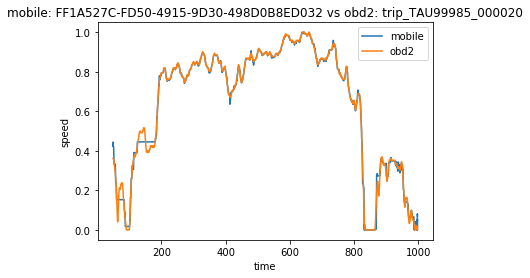

start point 1494792475.9997 49.172
end point 1494793456.0001 996.746
similarity distance 0.6447147856455313


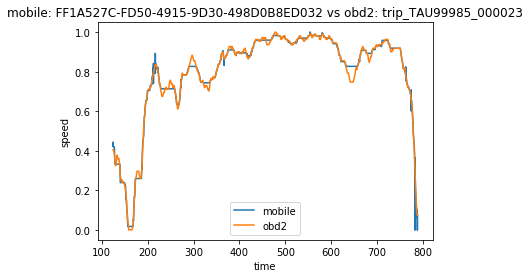

start point 1494792475.9997 124.514
end point 1494793456.0001 787.614
similarity distance 1.3191627942943025


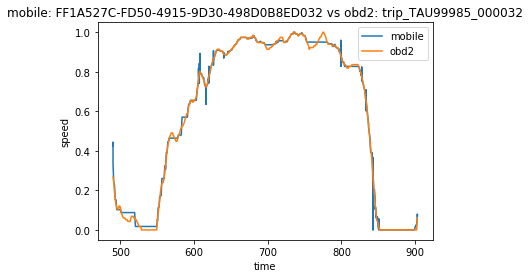

start point 1494792475.9997 489.844
end point 1494793456.0001 903.091
similarity distance 1.2720036793569853


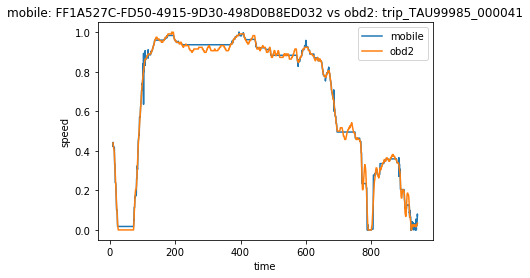

start point 1494792475.9997 9.441
end point 1494793456.0001 941.4
similarity distance 1.042819326552736


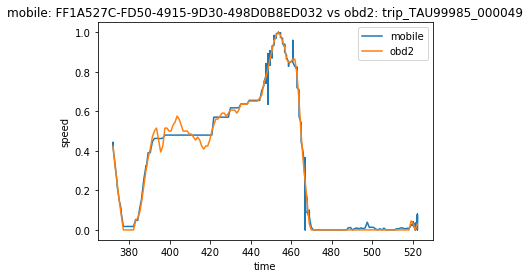

start point 1494792475.9997 371.975
end point 1494793456.0001 522.407
similarity distance 1.4315974856649307


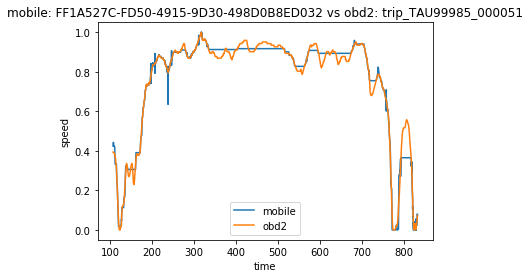

start point 1494792475.9997 106.475
end point 1494793456.0001 832.563
similarity distance 1.1731836590578693


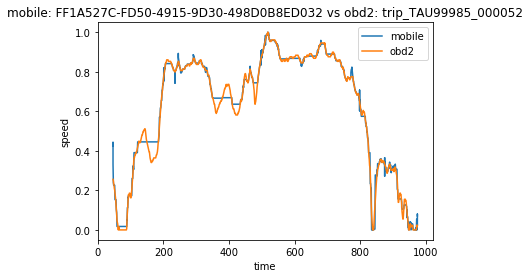

start point 1494792475.9997 46.345
end point 1494793456.0001 974.513
similarity distance 0.949664880777248


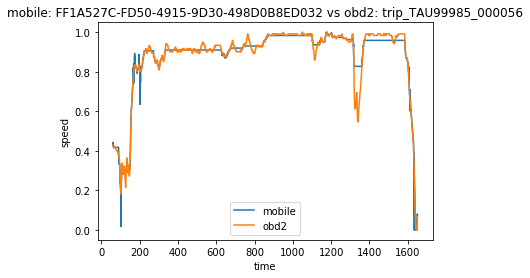

start point 1494792475.9997 60.401
end point 1494793456.0001 1650.657
similarity distance 1.832776611561474


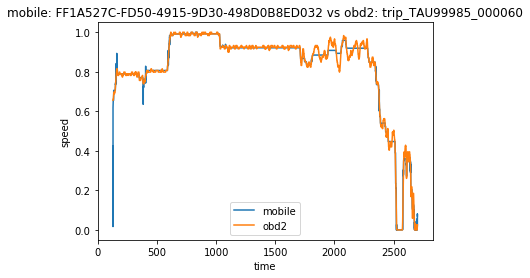

start point 1494792475.9997 127.827
end point 1494793456.0001 2701.024
similarity distance 2.574791264384949


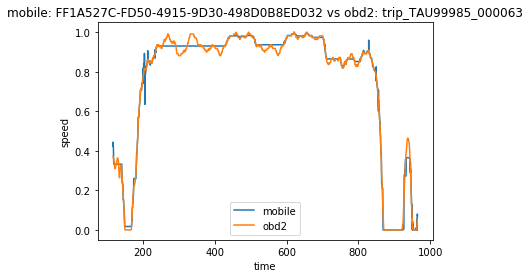

start point 1494792475.9997 116.676
end point 1494793456.0001 964.488
similarity distance 1.0724948514979629


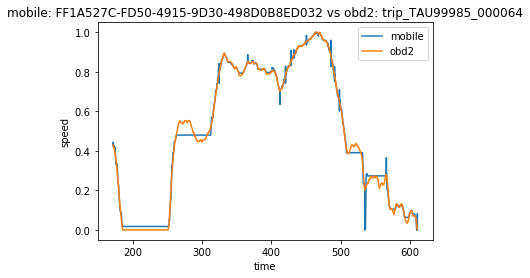

start point 1494792475.9997 171.748
end point 1494793456.0001 610.745
similarity distance 1.0071898183447465


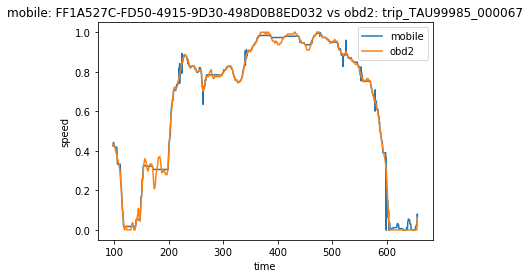

start point 1494792475.9997 97.506
end point 1494793456.0001 656.687
similarity distance 1.145578343795589


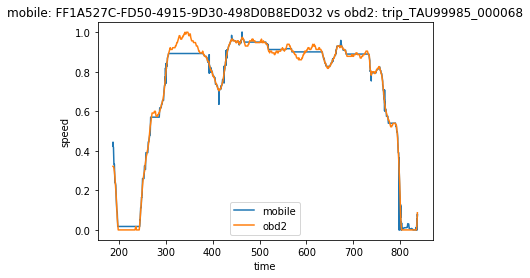

start point 1494792475.9997 187.64
end point 1494793456.0001 836.567
similarity distance 1.273373752716106


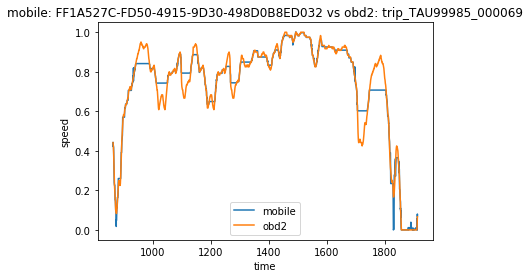

start point 1494792475.9997 863.192
end point 1494793456.0001 1911.289
similarity distance 1.6364336082304285


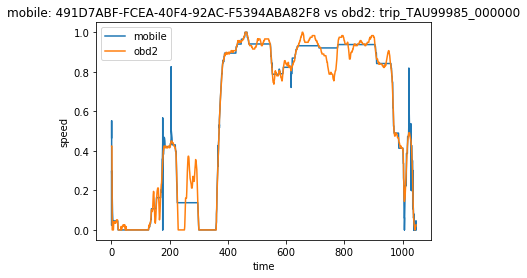

start point 1494874456.0001 1.141
end point 1494875185.0001 1046.167
similarity distance 3.521471043765859


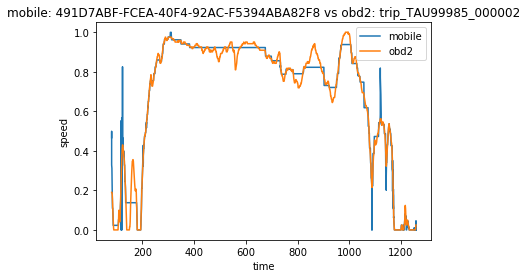

start point 1494874456.0001 80.902
end point 1494875185.0001 1258.221
similarity distance 3.514185454561841


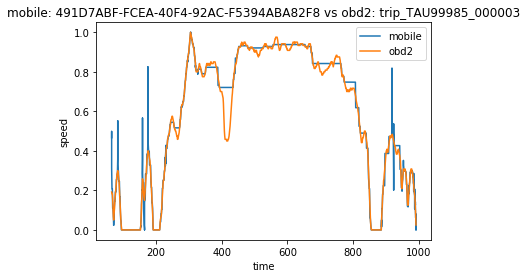

start point 1494874456.0001 65.108
end point 1494875185.0001 991.433
similarity distance 3.6121355819934426


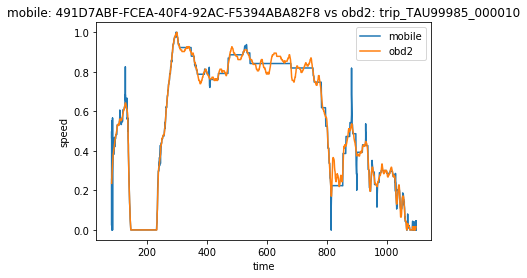

start point 1494874456.0001 83.251
end point 1494875185.0001 1096.85
similarity distance 2.6680545682559393


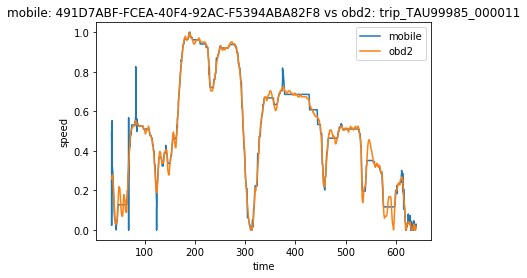

start point 1494874456.0001 33.652
end point 1494875185.0001 640.359
similarity distance 2.5160107062590913


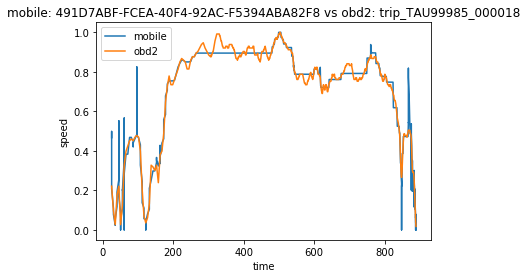

start point 1494874456.0001 25.631
end point 1494875185.0001 888.948
similarity distance 3.3341421629851817


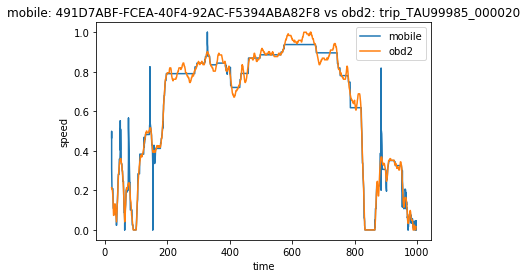

start point 1494874456.0001 21.488
end point 1494875185.0001 996.746
similarity distance 4.229336546375364


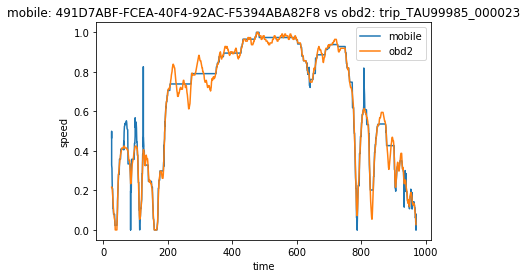

start point 1494874456.0001 26.321
end point 1494875185.0001 969.926
similarity distance 2.9382466729287957


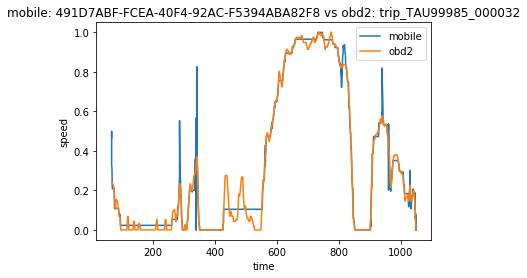

start point 1494874456.0001 66.97
end point 1494875185.0001 1049.473
similarity distance 3.621396998194225


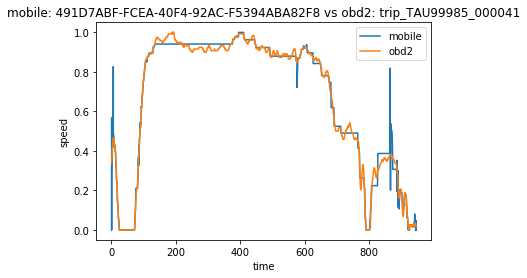

start point 1494874456.0001 1.356
end point 1494875185.0001 945.44
similarity distance 3.7224603760298107


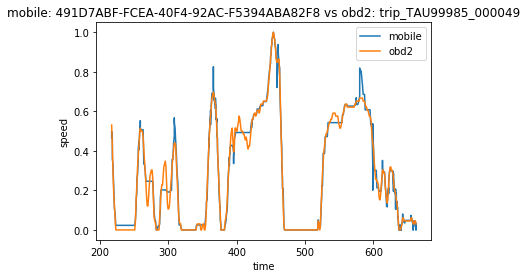

start point 1494874456.0001 217.26
end point 1494875185.0001 662.183
similarity distance 1.2385651993343467


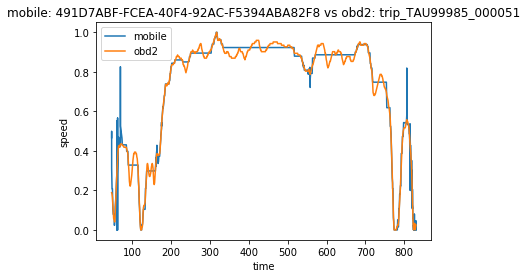

start point 1494874456.0001 46.617
end point 1494875185.0001 830.526
similarity distance 3.247550854514549


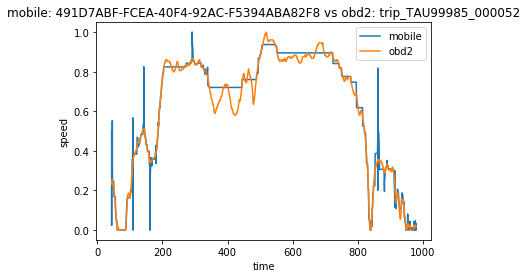

start point 1494874456.0001 44.306
end point 1494875185.0001 978.644
similarity distance 4.26596850541189


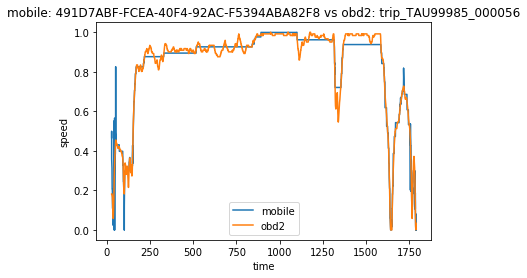

start point 1494874456.0001 28.868
end point 1494875185.0001 1789.112
similarity distance 3.3194315832794543


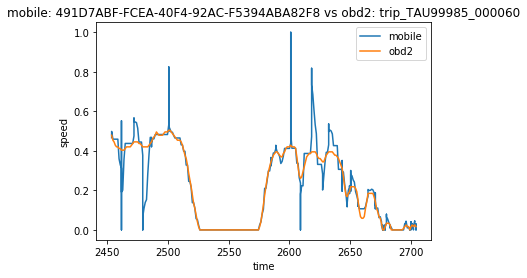

start point 1494874456.0001 2453.9
end point 1494875185.0001 2704.133
similarity distance 5.289159758033857


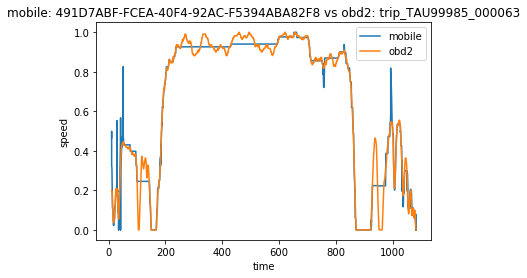

start point 1494874456.0001 10.416
end point 1494875185.0001 1081.929
similarity distance 3.406717918586747


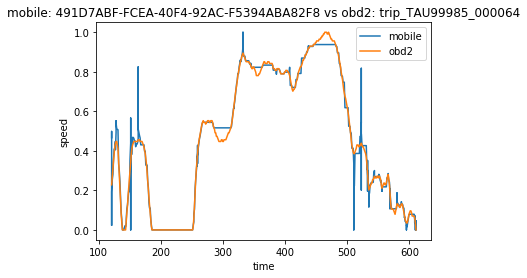

start point 1494874456.0001 120.782
end point 1494875185.0001 610.745
similarity distance 3.6800214604580406


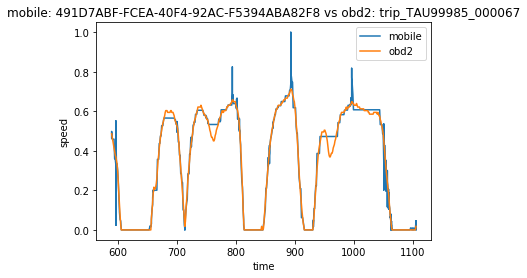

start point 1494874456.0001 589.181
end point 1494875185.0001 1105.381
similarity distance 2.0907945524882843


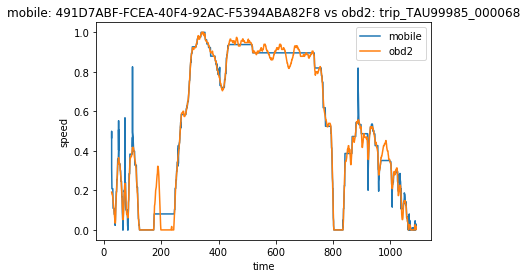

start point 1494874456.0001 26.734
end point 1494875185.0001 1089.777
similarity distance 3.203287106640038


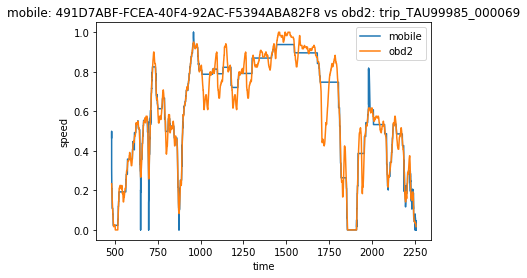

start point 1494874456.0001 481.709
end point 1494875185.0001 2256.314
similarity distance 2.9301787251618934


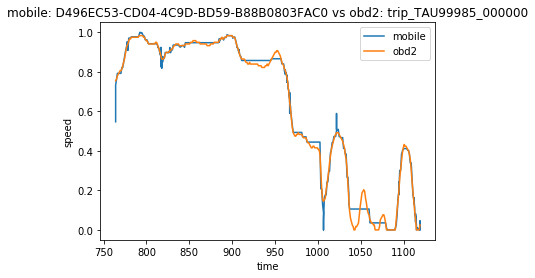

start point 1494943576 764.012
end point 1494944219.0001 1118.994
similarity distance 1.3242694442927434


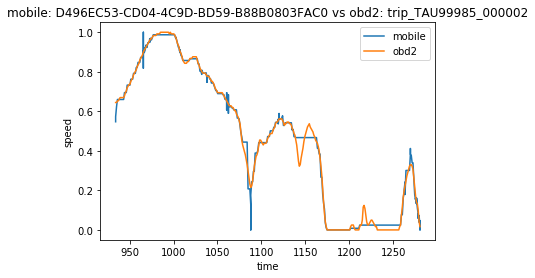

start point 1494943576 934.159
end point 1494944219.0001 1280.375
similarity distance 1.7967060859321142


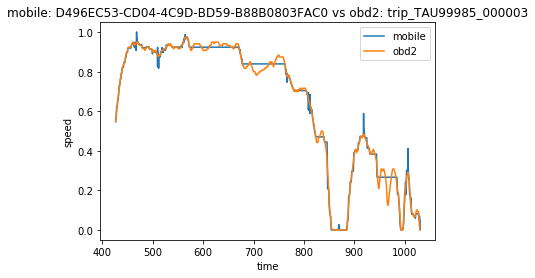

start point 1494943576 426.54
end point 1494944219.0001 1030.204
similarity distance 0.8929906336267242


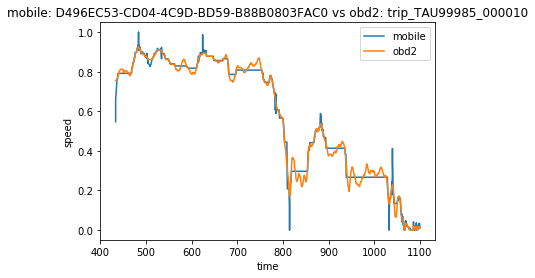

start point 1494943576 433.678
end point 1494944219.0001 1099.923
similarity distance 1.6776255879295836


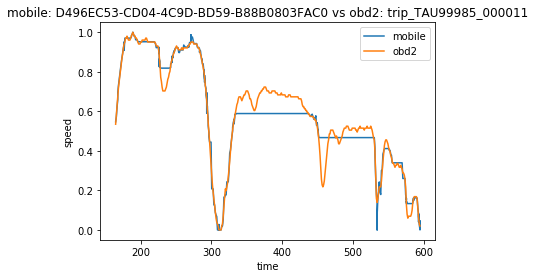

start point 1494943576 164.642
end point 1494944219.0001 594.627
similarity distance 1.347826510747295


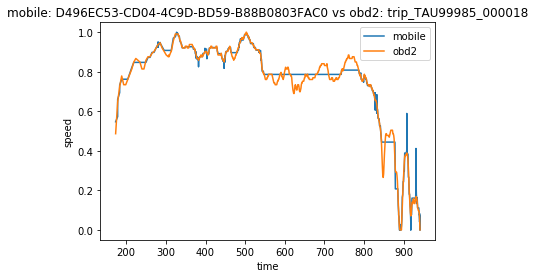

start point 1494943576 173.356
end point 1494944219.0001 940.843
similarity distance 1.5306341946458597


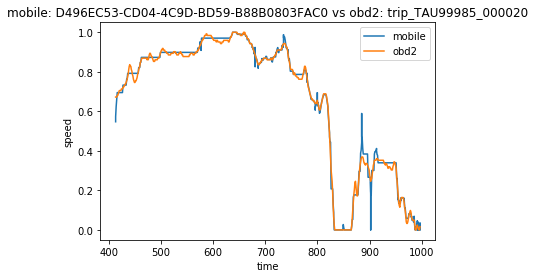

start point 1494943576 412.924
end point 1494944219.0001 996.746
similarity distance 1.5310741030849035


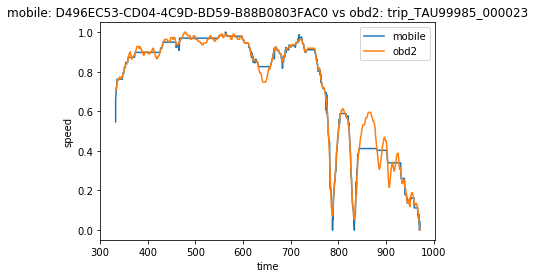

start point 1494943576 332.94
end point 1494944219.0001 970.948
similarity distance 1.195969912189787


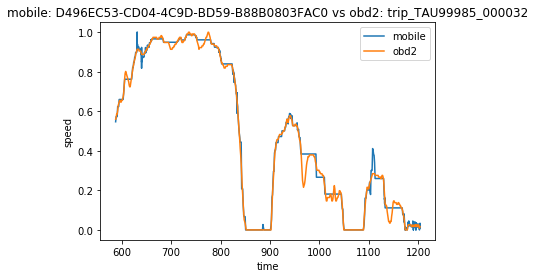

start point 1494943576 587.669
end point 1494944219.0001 1203.657
similarity distance 0.83972799862915


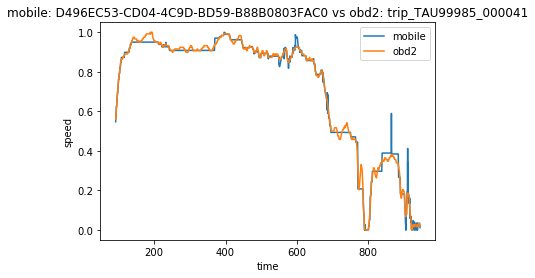

start point 1494943576 91.699
end point 1494944219.0001 945.44
similarity distance 1.41993038171128


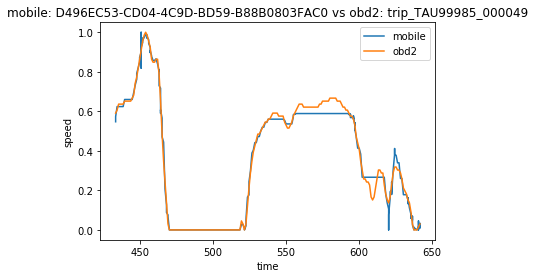

start point 1494943576 433.127
end point 1494944219.0001 641.639
similarity distance 0.9317642030038974


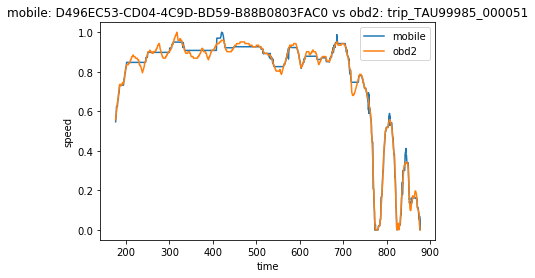

start point 1494943576 176.14
end point 1494944219.0001 877.032
similarity distance 0.6310242034934389


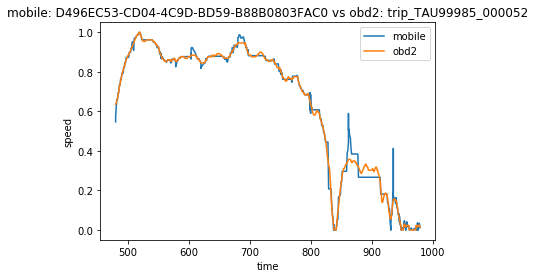

start point 1494943576 479.551
end point 1494944219.0001 978.644
similarity distance 1.5386329959144154


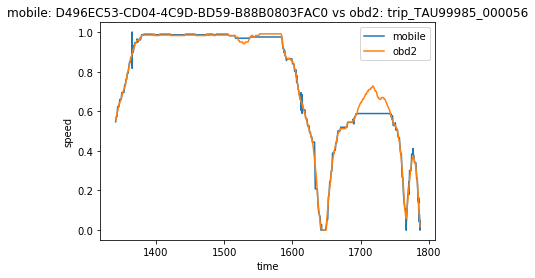

start point 1494943576 1340.764
end point 1494944219.0001 1787.039
similarity distance 0.9193542201730167


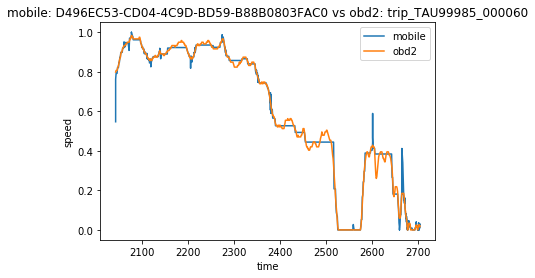

start point 1494943576 2042.393
end point 1494944219.0001 2704.133
similarity distance 1.2588996531800767


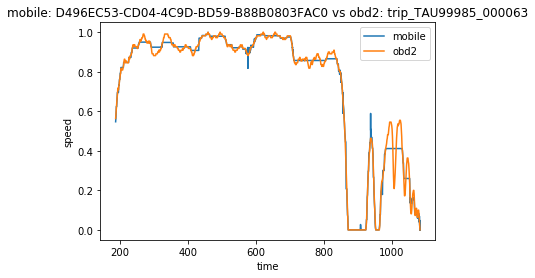

start point 1494943576 187.671
end point 1494944219.0001 1081.929
similarity distance 1.1890982764142384


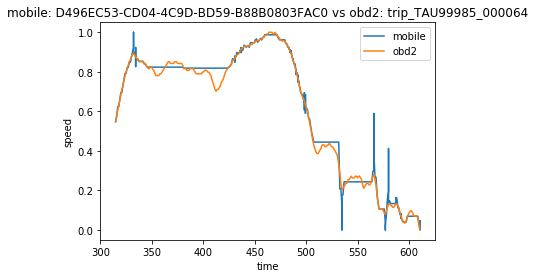

start point 1494943576 314.817
end point 1494944219.0001 610.745
similarity distance 2.5362309996123815


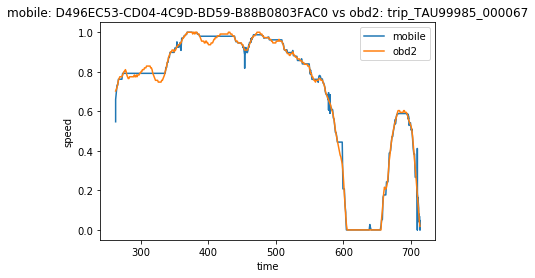

start point 1494943576 263.213
end point 1494944219.0001 713.367
similarity distance 1.1599499731444054


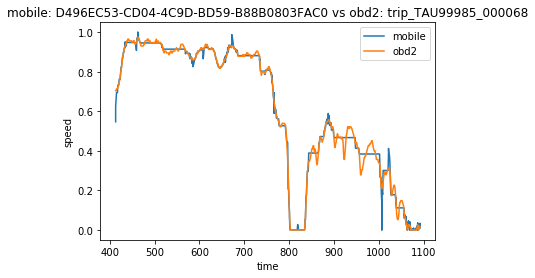

start point 1494943576 413.268
end point 1494944219.0001 1091.848
similarity distance 1.037233300834151


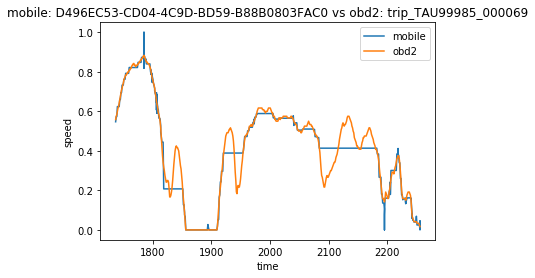

start point 1494943576 1736.341
end point 1494944219.0001 2256.314
similarity distance 1.6540436818606654


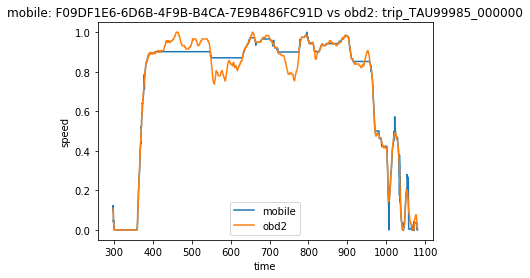

start point 1494946644.3497 297.62
end point 1494947499.9999 1079.914
similarity distance 1.6558157283245456


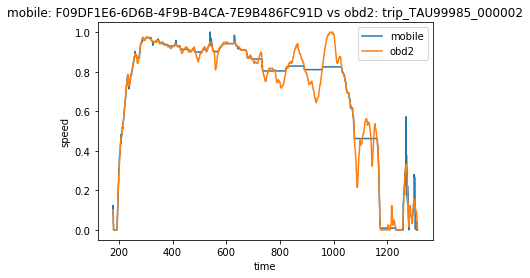

start point 1494946644.3497 178.125
end point 1494947499.9999 1311.954
similarity distance 2.2407117395614753


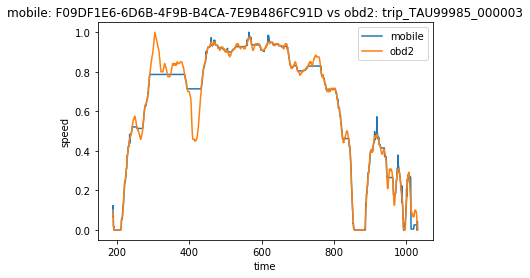

start point 1494946644.3497 189.699
end point 1494947499.9999 1030.204
similarity distance 1.5312770323032268


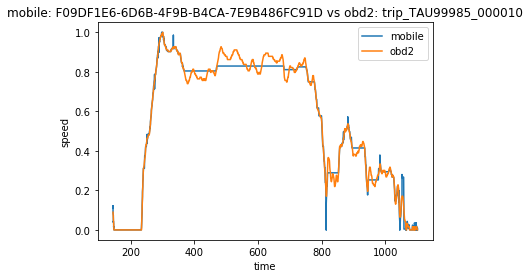

start point 1494946644.3497 144.022
end point 1494947499.9999 1100.959
similarity distance 1.712115439392762


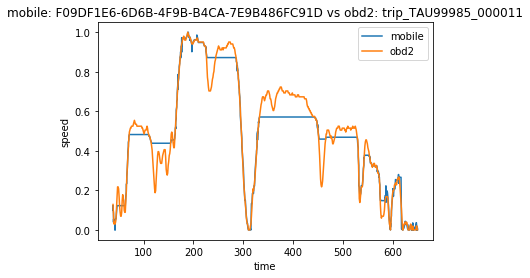

start point 1494946644.3497 38.82
end point 1494947499.9999 649.657
similarity distance 1.675596141022276


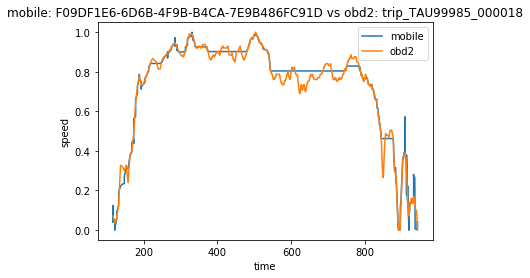

start point 1494946644.3497 117.317
end point 1494947499.9999 940.843
similarity distance 1.5177422110962588


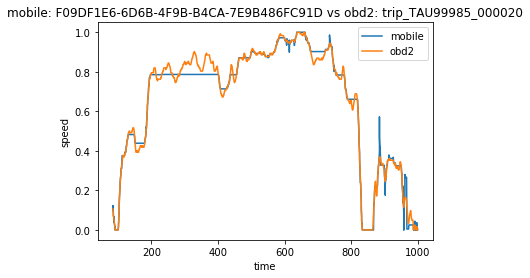

start point 1494946644.3497 84.508
end point 1494947499.9999 998.784
similarity distance 1.6475753317736759


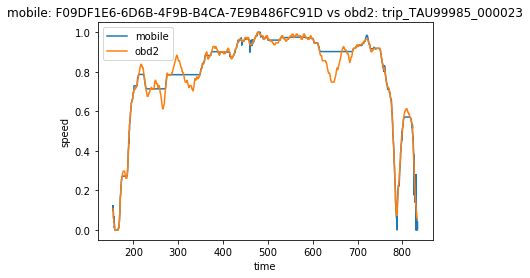

start point 1494946644.3497 154.626
end point 1494947499.9999 833.395
similarity distance 1.664332274922073


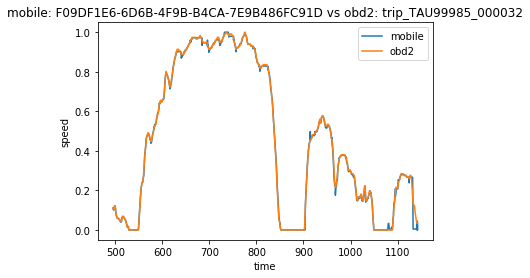

start point 1494946644.3497 494.92
end point 1494947499.9999 1142.216
similarity distance 0.4671657732088425


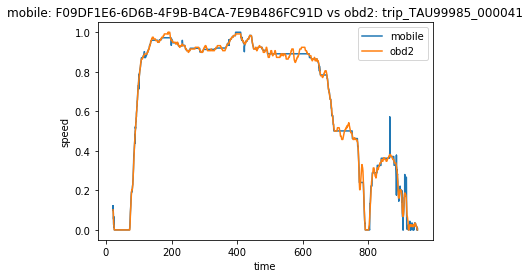

start point 1494946644.3497 21.277
end point 1494947499.9999 949.386
similarity distance 1.2558770002307353


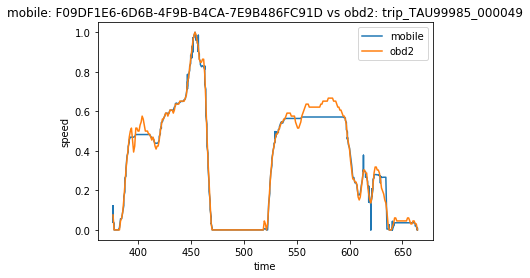

start point 1494946644.3497 376.029
end point 1494947499.9999 664.254
similarity distance 1.157130267542158


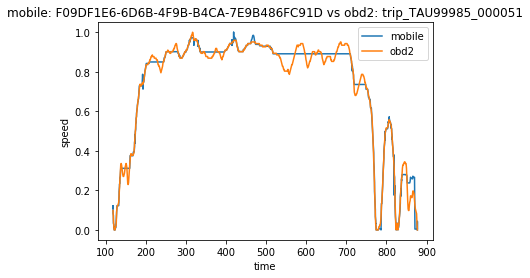

start point 1494946644.3497 118.602
end point 1494947499.9999 877.032
similarity distance 0.9997797292976444


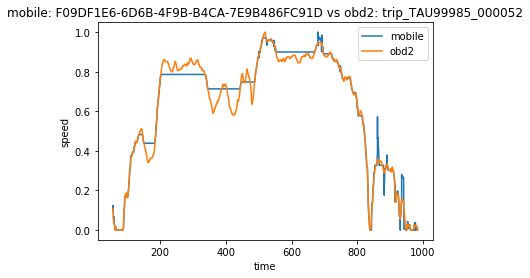

start point 1494946644.3497 56.465
end point 1494947499.9999 982.754
similarity distance 1.7732344592359608


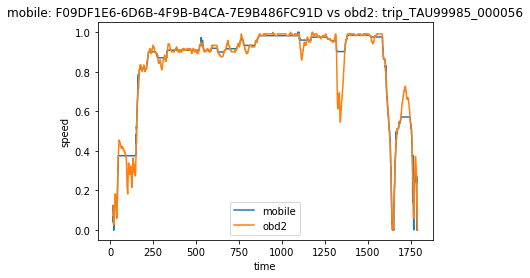

start point 1494946644.3497 16.531
end point 1494947499.9999 1788.075
similarity distance 2.0942347948859905


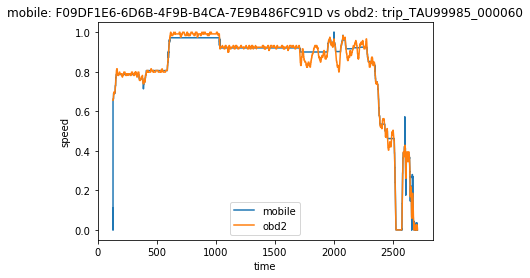

start point 1494946644.3497 127.827
end point 1494947499.9999 2707.229
similarity distance 5.135742648586746


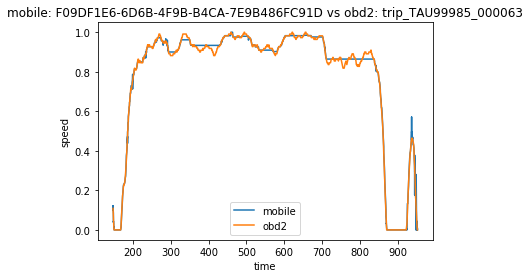

start point 1494946644.3497 147.141
end point 1494947499.9999 952.082
similarity distance 1.3279933737078329


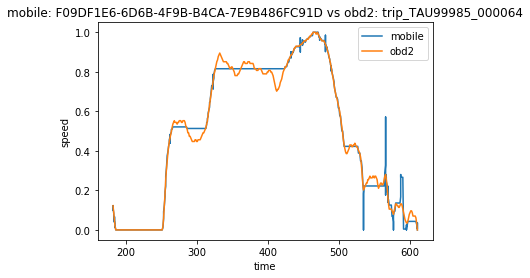

start point 1494946644.3497 181.829
end point 1494947499.9999 610.745
similarity distance 2.5198207318449906


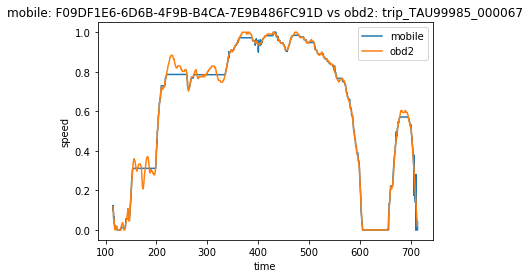

start point 1494946644.3497 114.718
end point 1494947499.9999 713.367
similarity distance 1.327360488136788


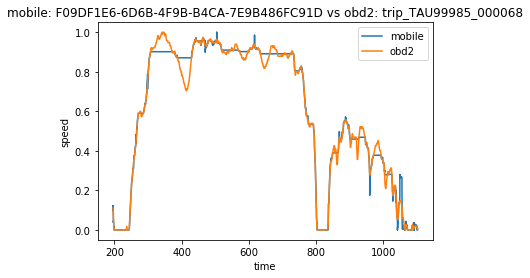

start point 1494946644.3497 195.627
end point 1494947499.9999 1101.148
similarity distance 1.2848813045381204


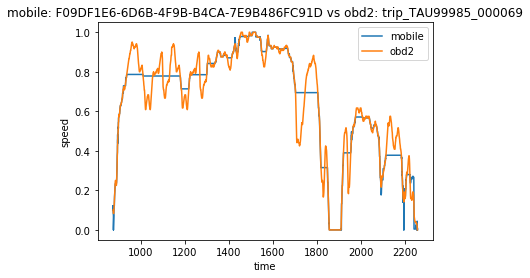

start point 1494946644.3497 872.39
end point 1494947499.9999 2257.28
similarity distance 2.836717190195466


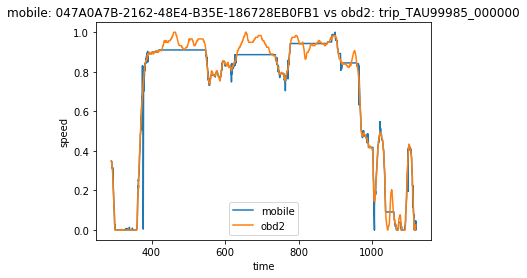

start point 1495203347.0001 290.516
end point 1495204754.0058 1118.994
similarity distance 1.5978863359626814


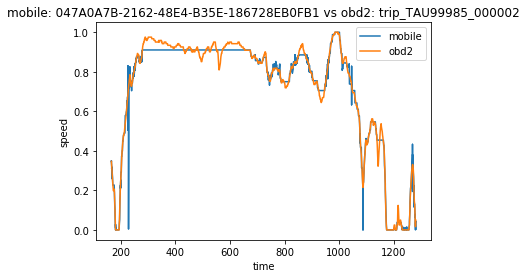

start point 1495203347.0001 164.868
end point 1495204754.0058 1281.418
similarity distance 1.6626246954864106


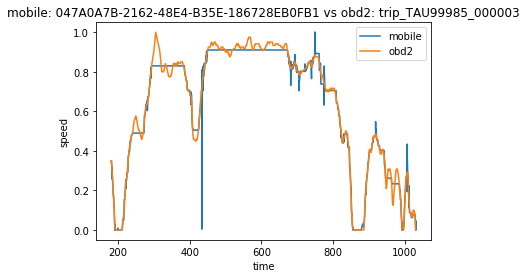

start point 1495203347.0001 181.628
end point 1495204754.0058 1030.204
similarity distance 1.4611324491197708


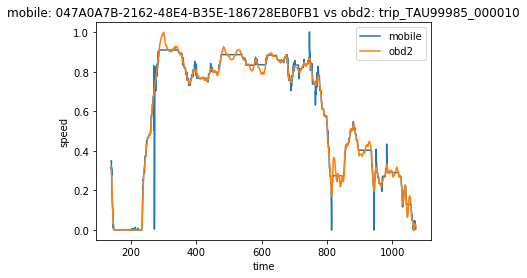

start point 1495203347.0001 139.991
end point 1495204754.0058 1072.22
similarity distance 1.985196288090048


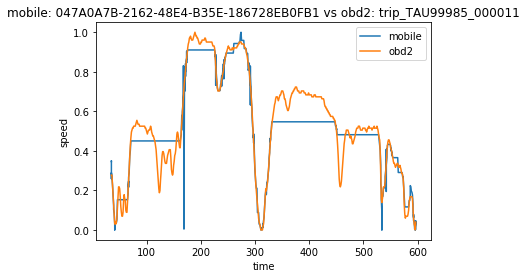

start point 1495203347.0001 34.689
end point 1495204754.0058 596.664
similarity distance 2.376247014430469


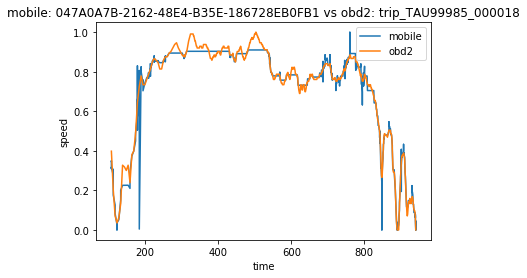

start point 1495203347.0001 107.133
end point 1495204754.0058 940.843
similarity distance 1.7668300416522775


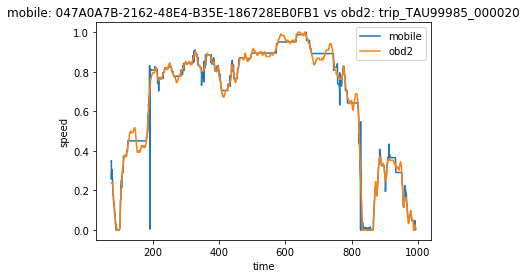

start point 1495203347.0001 75.465
end point 1495204754.0058 993.637
similarity distance 2.0110587304201233


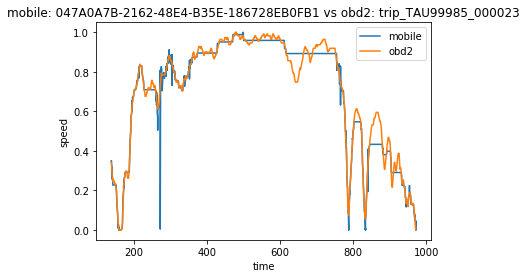

start point 1495203347.0001 138.499
end point 1495204754.0058 970.948
similarity distance 1.5798106068750744


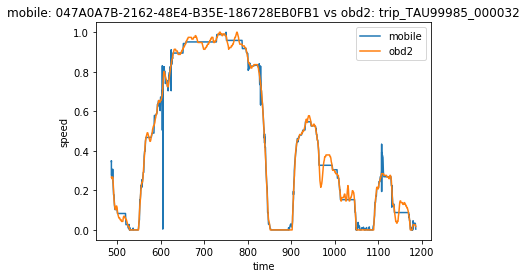

start point 1495203347.0001 486.827
end point 1495204754.0058 1186.095
similarity distance 1.5753004641863706


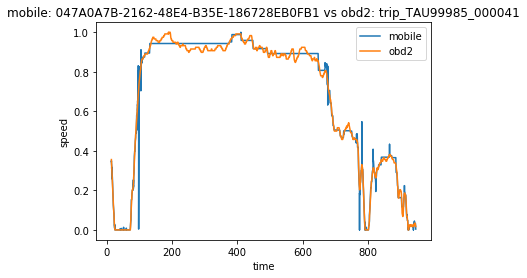

start point 1495203347.0001 14.409
end point 1495204754.0058 945.44
similarity distance 1.808492492566957


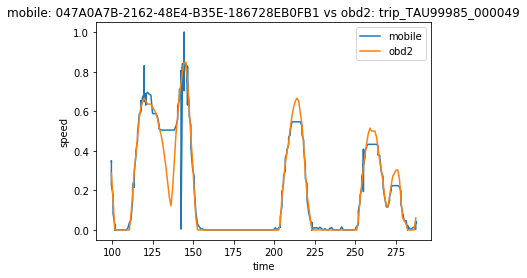

start point 1495203347.0001 99.572
end point 1495204754.0058 287.483
similarity distance 1.5698664983644375


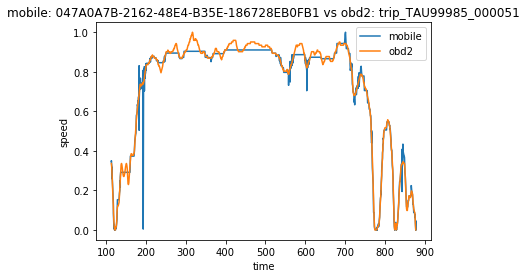

start point 1495203347.0001 113.531
end point 1495204754.0058 877.032
similarity distance 1.3581037857402025


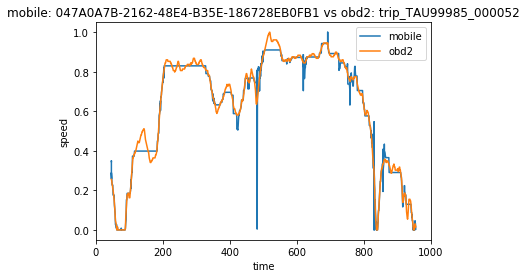

start point 1495203347.0001 46.345
end point 1495204754.0058 955.186
similarity distance 2.0590056666217387


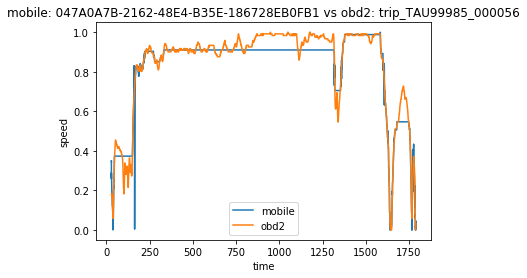

start point 1495203347.0001 28.868
end point 1495204754.0058 1789.112
similarity distance 2.488040473568857


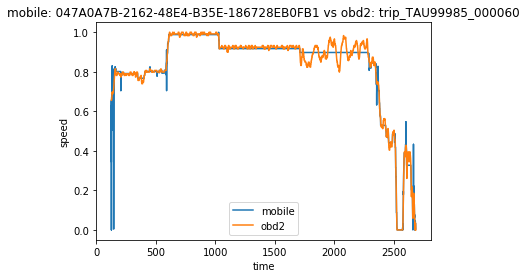

start point 1495203347.0001 127.827
end point 1495204754.0058 2683.814
similarity distance 5.247096839405311


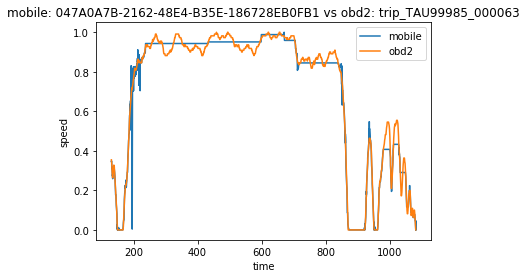

start point 1495203347.0001 130.886
end point 1495204754.0058 1081.929
similarity distance 1.6116294436749627


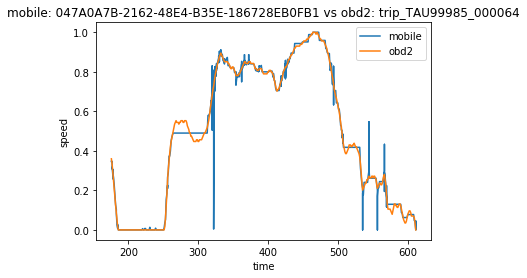

start point 1495203347.0001 175.788
end point 1495204754.0058 610.745
similarity distance 2.4337311167126727


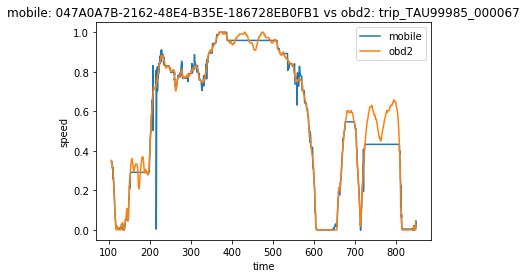

start point 1495203347.0001 106.622
end point 1495204754.0058 847.694
similarity distance 1.892912598195752


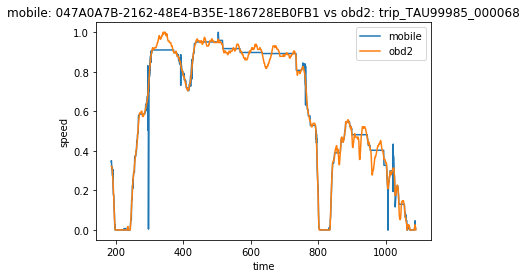

start point 1495203347.0001 187.64
end point 1495204754.0058 1088.739
similarity distance 2.102112234927404


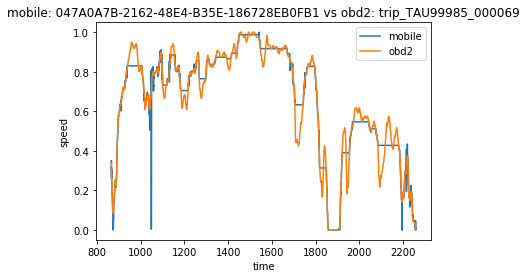

start point 1495203347.0001 866.288
end point 1495204754.0058 2257.28
similarity distance 2.341480488924934


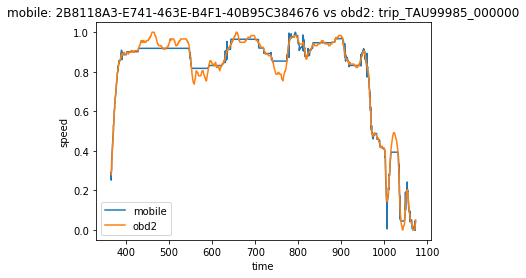

start point 1495388184.0058 365.076
end point 1495388986.0001 1072.733
similarity distance 0.9352261110115097


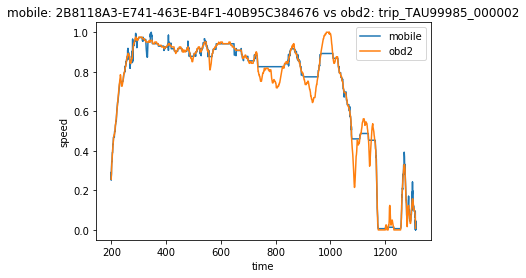

start point 1495388184.0058 199.227
end point 1495388986.0001 1310.964
similarity distance 1.3405818030714696


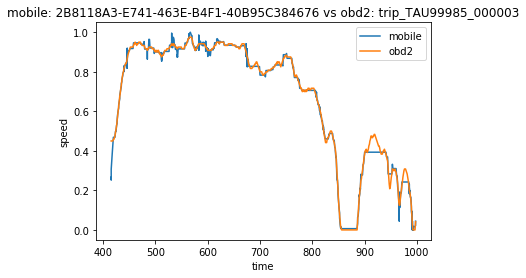

start point 1495388184.0058 415.337
end point 1495388986.0001 997.451
similarity distance 0.8288673030786604


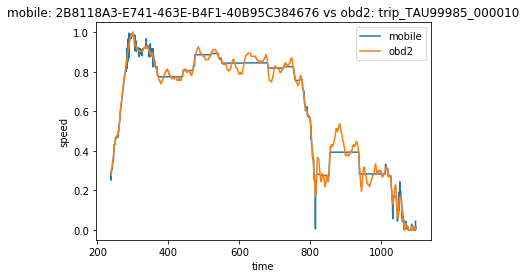

start point 1495388184.0058 238.654
end point 1495388986.0001 1096.85
similarity distance 1.1262230311972774


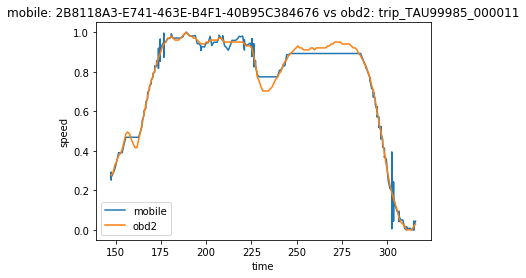

start point 1495388184.0058 147.58
end point 1495388986.0001 315.566
similarity distance 1.0504535168412148


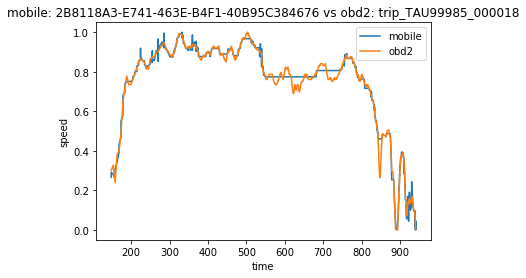

start point 1495388184.0058 147.894
end point 1495388986.0001 940.843
similarity distance 0.8329392344584418


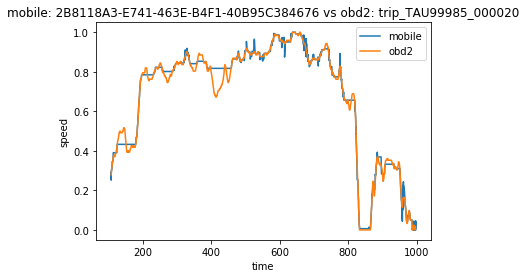

start point 1495388184.0058 107.78
end point 1495388986.0001 996.746
similarity distance 0.956309658298588


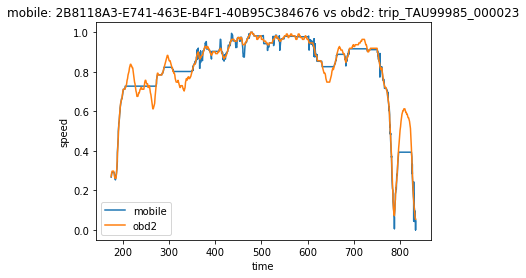

start point 1495388184.0058 175.171
end point 1495388986.0001 833.395
similarity distance 1.3331100021144304


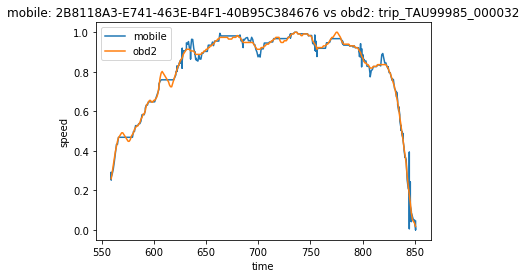

start point 1495388184.0058 559.179
end point 1495388986.0001 850.81
similarity distance 0.9914174153599443


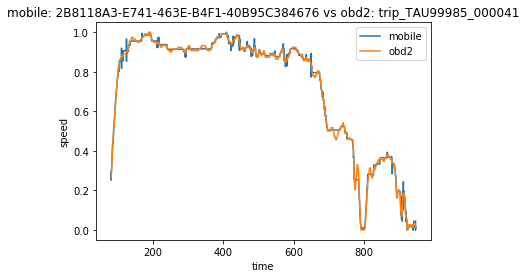

start point 1495388184.0058 82.674
end point 1495388986.0001 945.44
similarity distance 0.5667401167692762


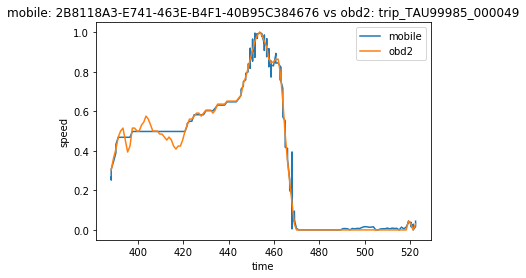

start point 1495388184.0058 388.299
end point 1495388986.0001 522.407
similarity distance 1.1462397825826875


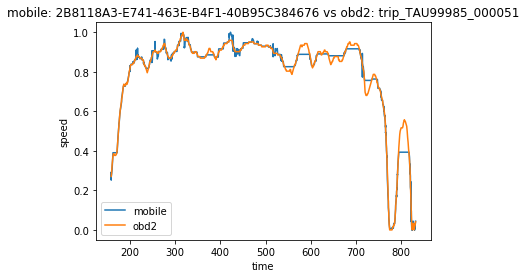

start point 1495388184.0058 158.215
end point 1495388986.0001 831.561
similarity distance 0.8573480565908529


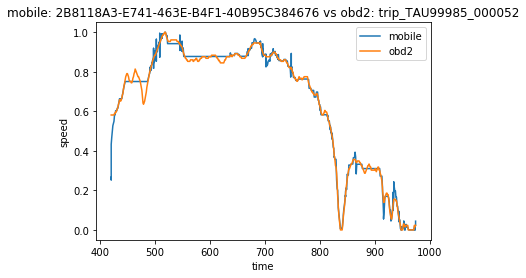

start point 1495388184.0058 420.805
end point 1495388986.0001 974.513
similarity distance 1.1891394404095084


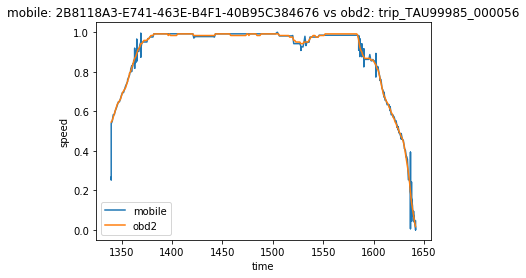

start point 1495388184.0058 1339.739
end point 1495388986.0001 1641.541
similarity distance 1.3254492874560513


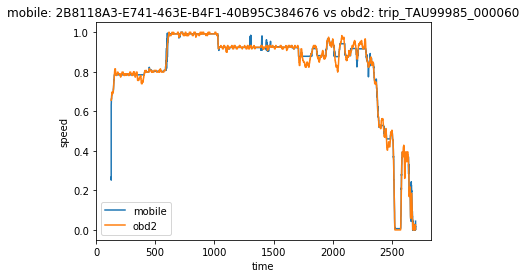

start point 1495388184.0058 127.827
end point 1495388986.0001 2701.024
similarity distance 1.5411896688147468


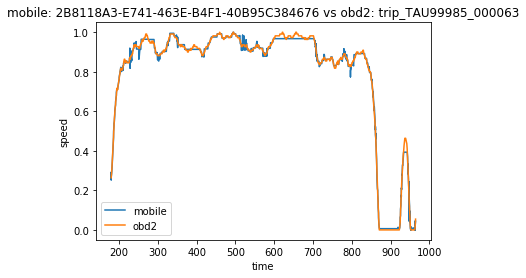

start point 1495388184.0058 179.499
end point 1495388986.0001 964.488
similarity distance 0.6000565661909499


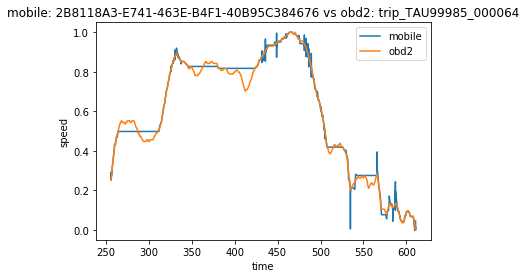

start point 1495388184.0058 256.092
end point 1495388986.0001 610.745
similarity distance 1.0308212724351133


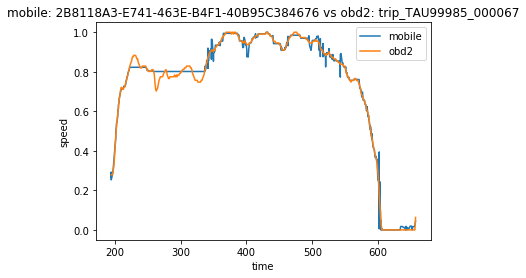

start point 1495388184.0058 194.712
end point 1495388986.0001 656.687
similarity distance 1.0667829894287841


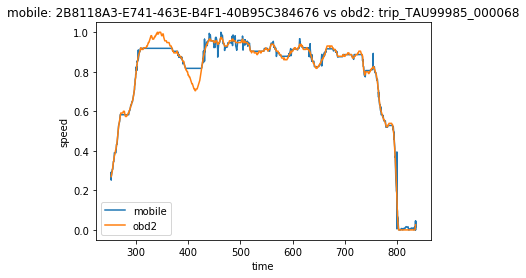

start point 1495388184.0058 252.687
end point 1495388986.0001 835.545
similarity distance 1.1069605353980732


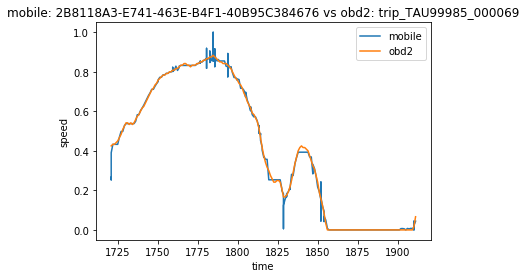

start point 1495388184.0058 1721.051
end point 1495388986.0001 1911.289
similarity distance 1.1869755329894902


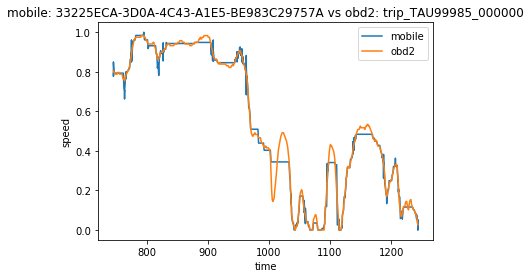

start point 1495391984.0001 745.861
end point 1495393088.0001 1243.374
similarity distance 0.9721752322107349


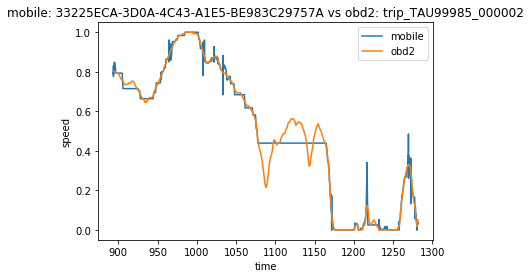

start point 1495391984.0001 893.745
end point 1495393088.0001 1281.418
similarity distance 1.6026493560746353


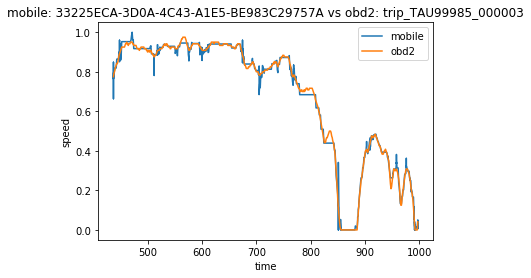

start point 1495391984.0001 436.751
end point 1495393088.0001 997.451
similarity distance 1.2662178045914088


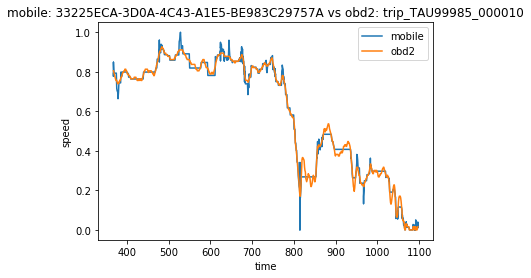

start point 1495391984.0001 367.736
end point 1495393088.0001 1096.85
similarity distance 2.253775667782294


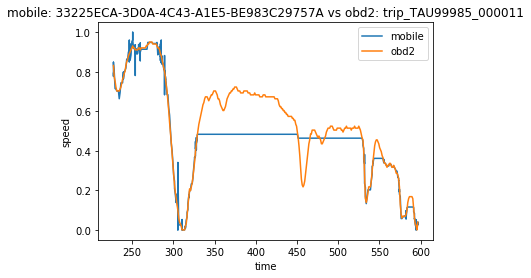

start point 1495391984.0001 227.285
end point 1495393088.0001 596.664
similarity distance 2.4273289695413687


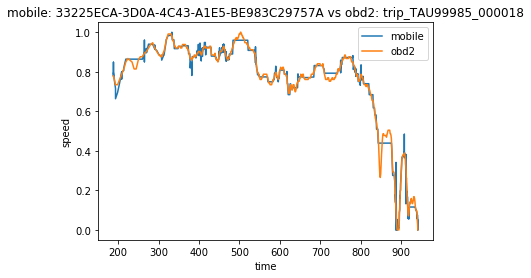

start point 1495391984.0001 188.634
end point 1495393088.0001 940.843
similarity distance 1.4088877954606531


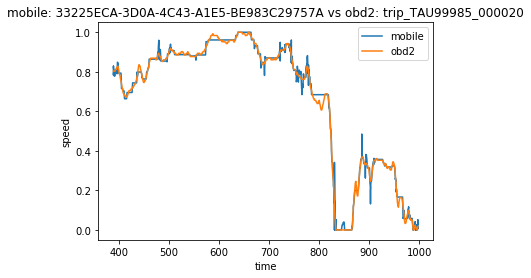

start point 1495391984.0001 388.796
end point 1495393088.0001 996.746
similarity distance 1.3571034352145175


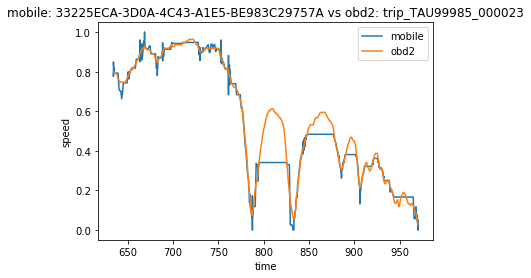

start point 1495391984.0001 634.465
end point 1495393088.0001 969.926
similarity distance 1.5684334587155864


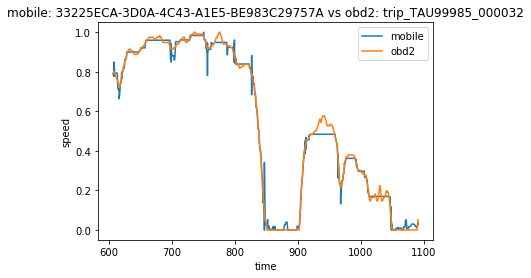

start point 1495391984.0001 606.996
end point 1495393088.0001 1090.45
similarity distance 1.314277225491161


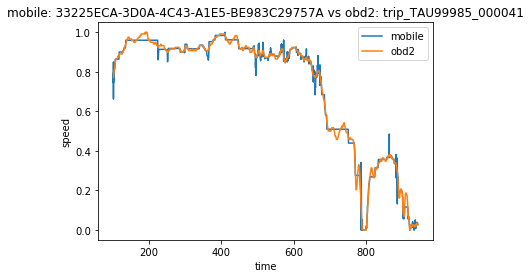

start point 1495391984.0001 100.875
end point 1495393088.0001 944.403
similarity distance 1.3889841615212368


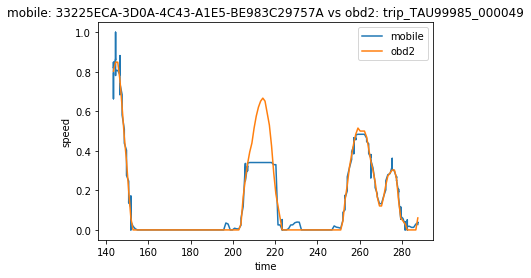

start point 1495391984.0001 143.498
end point 1495393088.0001 287.483
similarity distance 1.3851156296049518


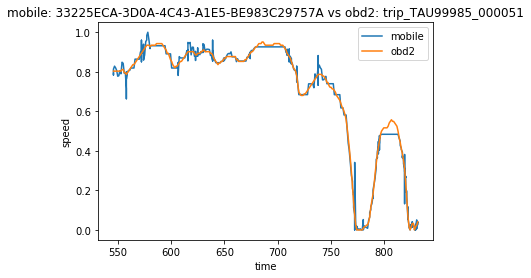

start point 1495391984.0001 545.906
end point 1495393088.0001 831.561
similarity distance 1.3191395760405986


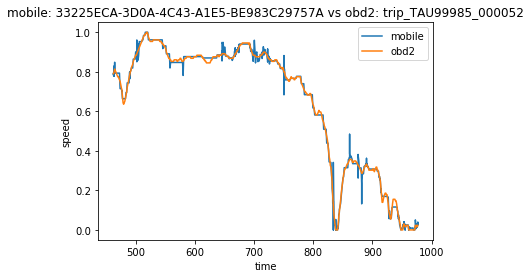

start point 1495391984.0001 462.365
end point 1495393088.0001 976.586
similarity distance 1.4115370072730842


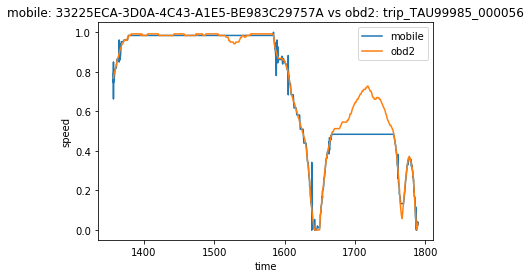

start point 1495391984.0001 1356.994
end point 1495393088.0001 1789.112
similarity distance 1.8547230786266957


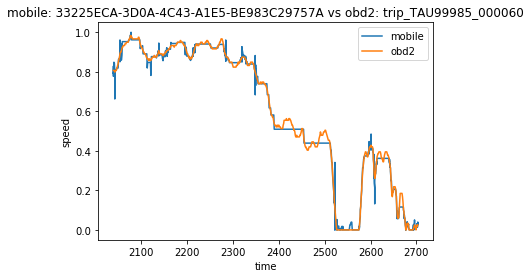

start point 1495391984.0001 2039.398
end point 1495393088.0001 2703.097
similarity distance 1.3189051217952932


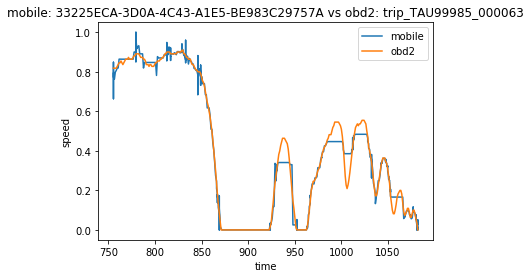

start point 1495391984.0001 755.399
end point 1495393088.0001 1081.929
similarity distance 0.9923864271773294


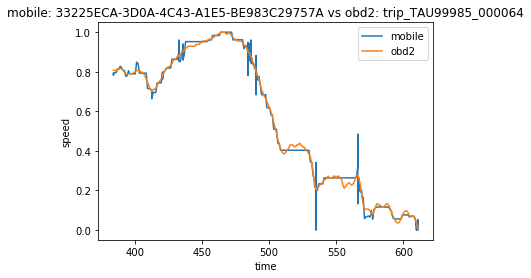

start point 1495391984.0001 383.974
end point 1495393088.0001 610.745
similarity distance 2.8975394192039237


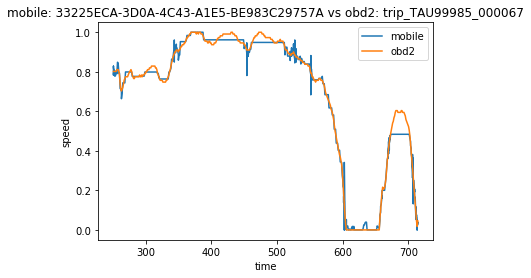

start point 1495391984.0001 251.054
end point 1495393088.0001 714.382
similarity distance 1.416031837405726


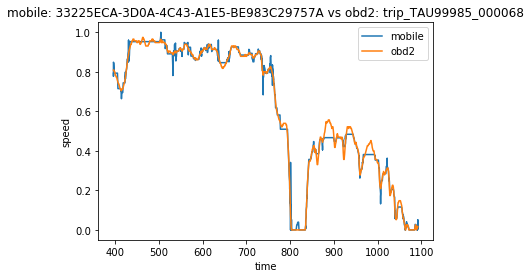

start point 1495391984.0001 395.941
end point 1495393088.0001 1091.848
similarity distance 1.290259878044054


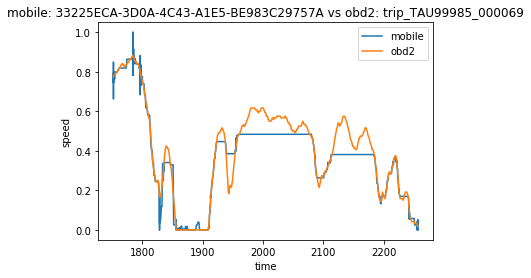

start point 1495391984.0001 1752.449
end point 1495393088.0001 2256.314
similarity distance 1.902705420760893


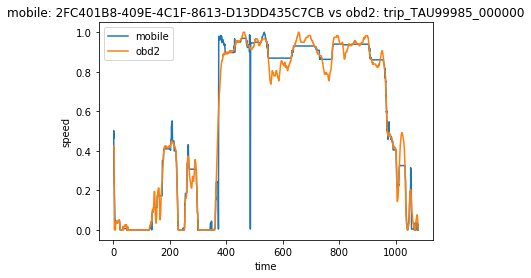

start point 1495494020.0001 1.141
end point 1495495268.0002 1079.914
similarity distance 2.0070251005535265


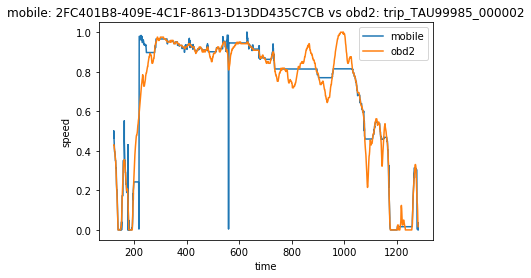

start point 1495494020.0001 122.946
end point 1495495268.0002 1280.375
similarity distance 2.7870244810908384


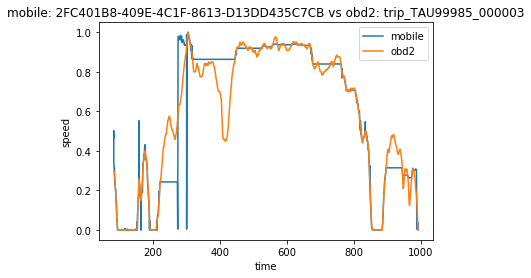

start point 1495494020.0001 83.656
end point 1495495268.0002 992.377
similarity distance 3.52080448937881


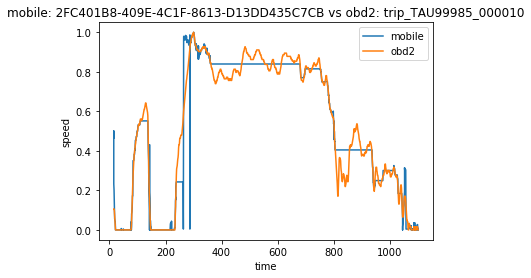

start point 1495494020.0001 15.438
end point 1495495268.0002 1100.959
similarity distance 3.0512577122074234


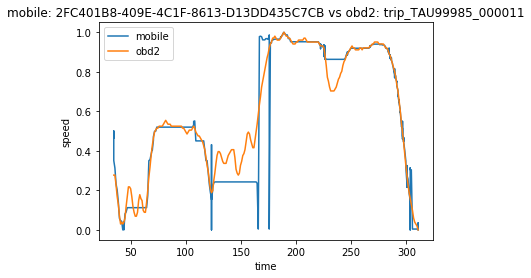

start point 1495494020.0001 34.689
end point 1495495268.0002 310.583
similarity distance 2.726432782127956


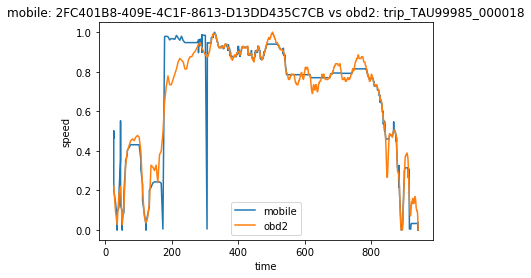

start point 1495494020.0001 25.631
end point 1495495268.0002 940.843
similarity distance 2.1733825013257517


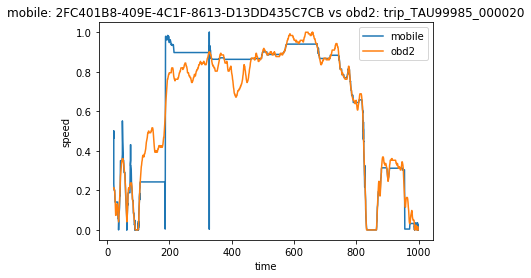

start point 1495494020.0001 21.488
end point 1495495268.0002 998.784
similarity distance 3.1402661530189127


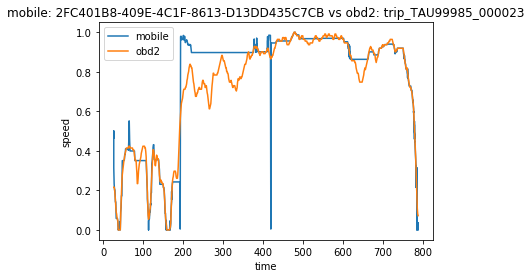

start point 1495494020.0001 26.321
end point 1495495268.0002 787.614
similarity distance 3.0438107787944215


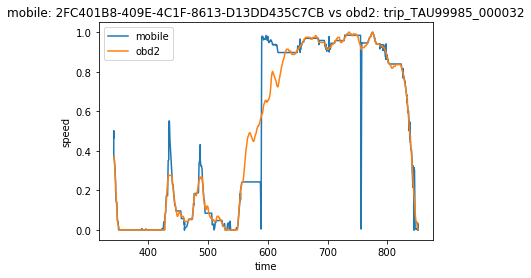

start point 1495494020.0001 341.925
end point 1495495268.0002 851.8
similarity distance 2.580680057090434


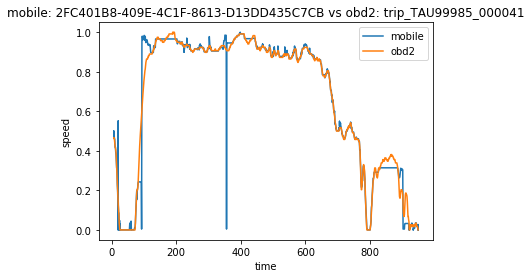

start point 1495494020.0001 6.423
end point 1495495268.0002 949.386
similarity distance 2.5419952433480035


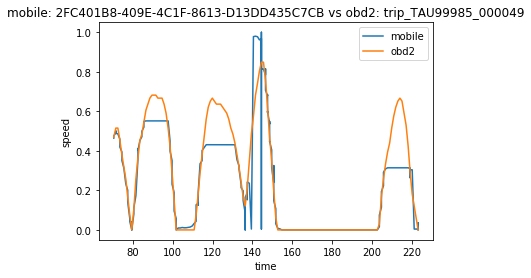

start point 1495494020.0001 70.258
end point 1495495268.0002 223.319
similarity distance 2.4169150076613386


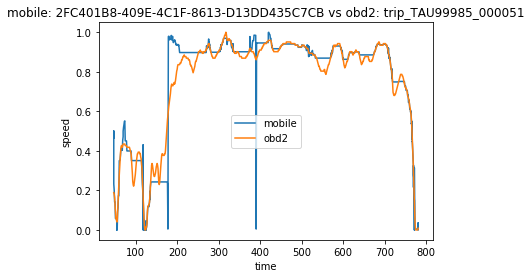

start point 1495494020.0001 46.617
end point 1495495268.0002 780.399
similarity distance 2.6642082417508153


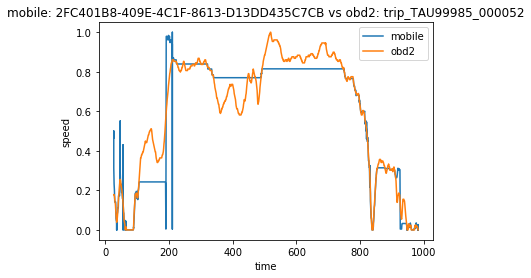

start point 1495494020.0001 25.992
end point 1495495268.0002 982.754
similarity distance 3.681104796269913


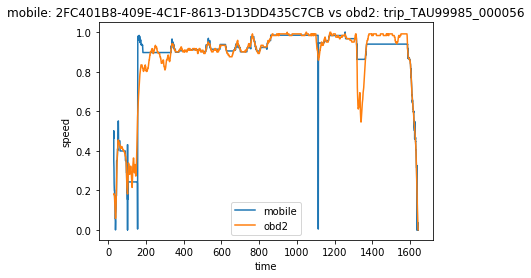

start point 1495494020.0001 28.868
end point 1495495268.0002 1642.564
similarity distance 3.2790585116915416


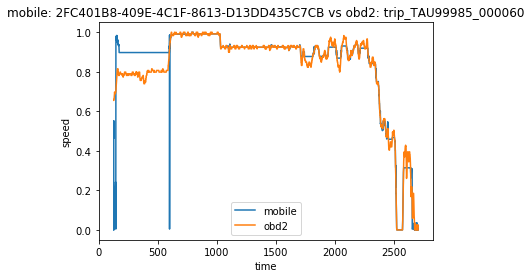

start point 1495494020.0001 127.827
end point 1495495268.0002 2707.229
similarity distance 8.45238540540796


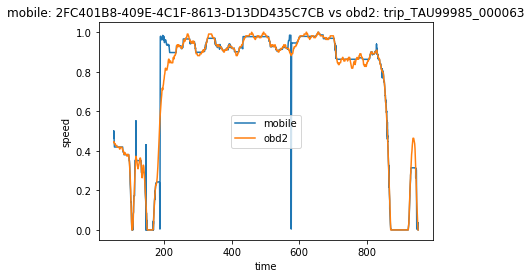

start point 1495494020.0001 50.947
end point 1495495268.0002 952.082
similarity distance 2.0683728592049966


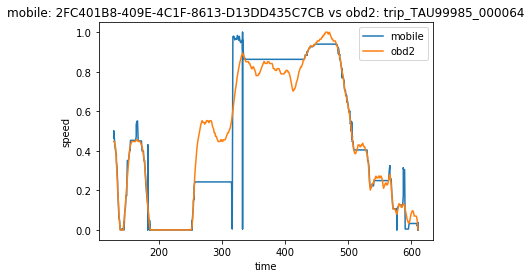

start point 1495494020.0001 127.9
end point 1495495268.0002 610.745
similarity distance 2.9174594920380037


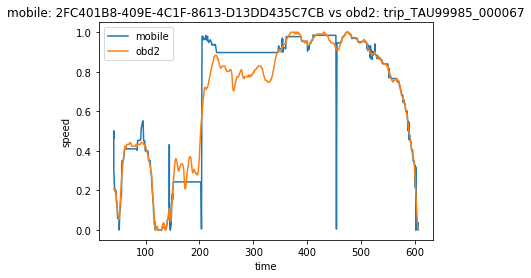

start point 1495494020.0001 41.053
end point 1495495268.0002 605.576
similarity distance 2.7004965556248326


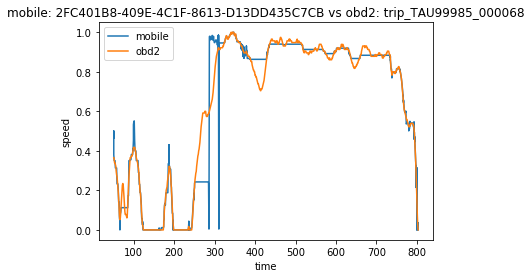

start point 1495494020.0001 51.04
end point 1495495268.0002 802.932
similarity distance 2.6382842414976446


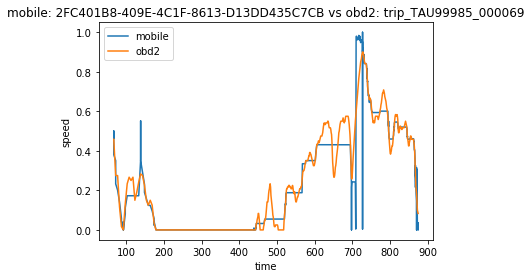

start point 1495494020.0001 66.688
end point 1495495268.0002 874.37
similarity distance 3.1671128137416265


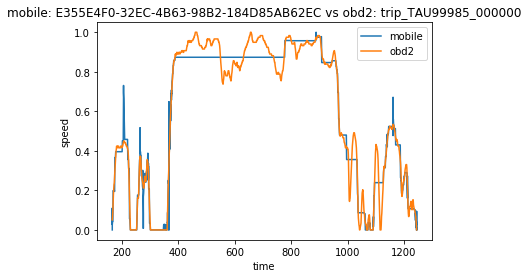

start point 1495814628.0021 165.39
end point 1495815467.0001 1244.412
similarity distance 2.587594645105297


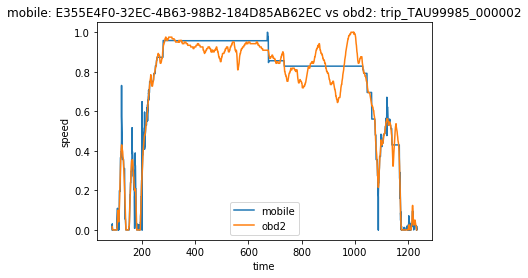

start point 1495814628.0021 88.05
end point 1495815467.0001 1231.845
similarity distance 2.9201703249895634


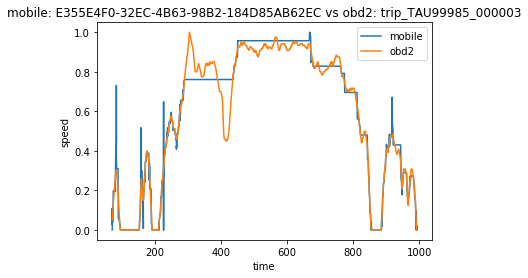

start point 1495814628.0021 71.29
end point 1495815467.0001 992.377
similarity distance 2.782628452581034


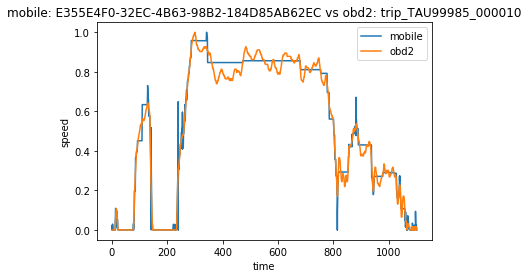

start point 1495814628.0021 1.144
end point 1495815467.0001 1100.959
similarity distance 2.6945112529339155


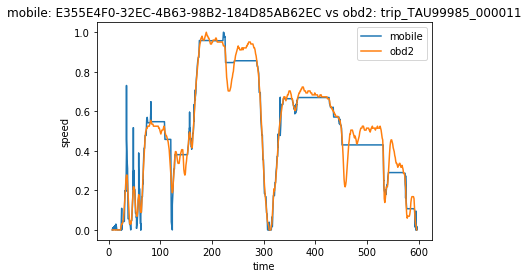

start point 1495814628.0021 7.181
end point 1495815467.0001 595.642
similarity distance 2.13385805138178


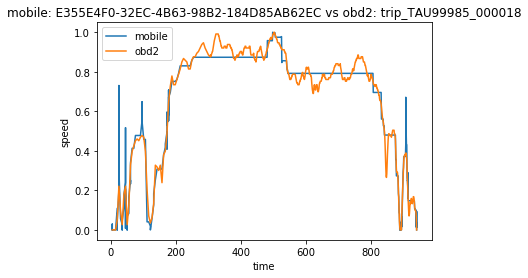

start point 1495814628.0021 5.261
end point 1495815467.0001 940.843
similarity distance 2.7074630016523042


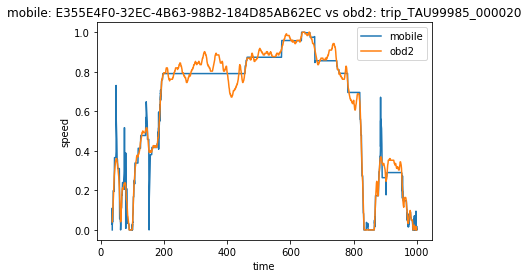

start point 1495814628.0021 36.959
end point 1495815467.0001 998.784
similarity distance 2.857151617123706


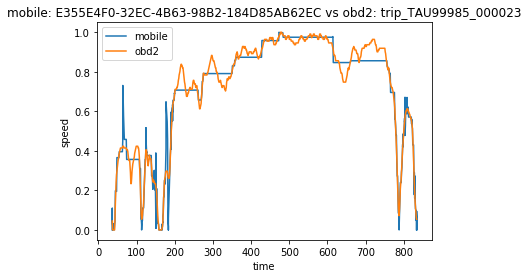

start point 1495814628.0021 36.472
end point 1495815467.0001 833.395
similarity distance 2.2629443407544394


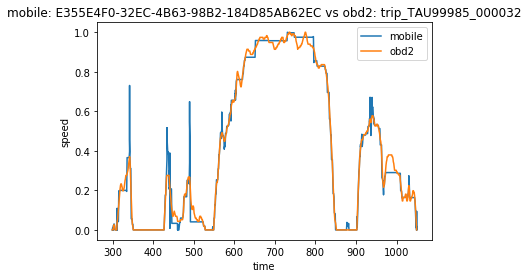

start point 1495814628.0021 299.283
end point 1495815467.0001 1049.473
similarity distance 1.8593844863273812


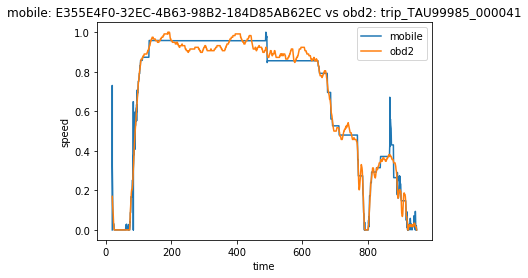

start point 1495814628.0021 19.307
end point 1495815467.0001 949.386
similarity distance 3.3387167451052315


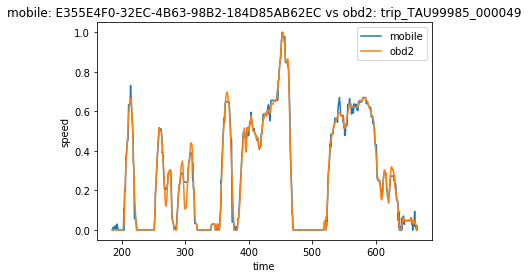

start point 1495814628.0021 185.362
end point 1495815467.0001 664.254
similarity distance 0.699112539161148


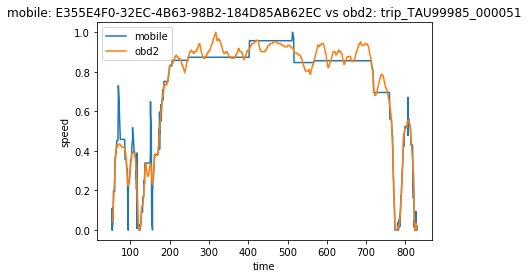

start point 1495814628.0021 53.806
end point 1495815467.0001 828.453
similarity distance 2.265442387731133


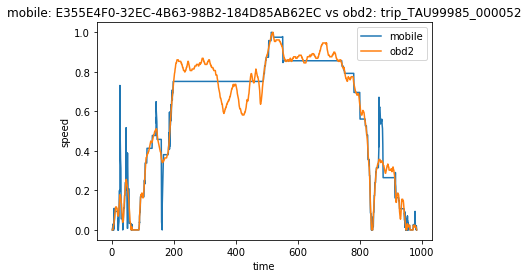

start point 1495814628.0021 1.33
end point 1495815467.0001 982.754
similarity distance 3.305299472380451


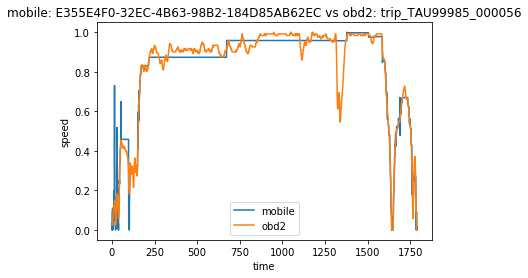

start point 1495814628.0021 1.332
end point 1495815467.0001 1788.075
similarity distance 3.209179062515327


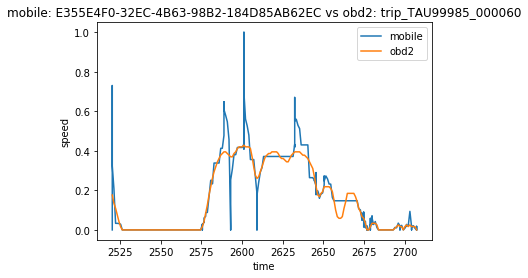

start point 1495814628.0021 2520.266
end point 1495815467.0001 2707.229
similarity distance 4.238348972512851


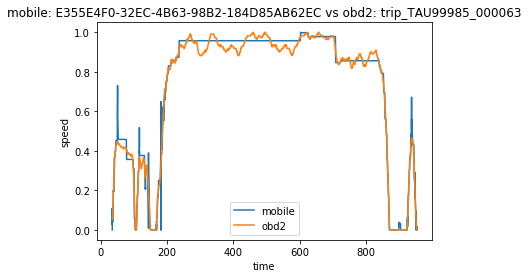

start point 1495814628.0021 34.953
end point 1495815467.0001 952.082
similarity distance 2.192381475824452


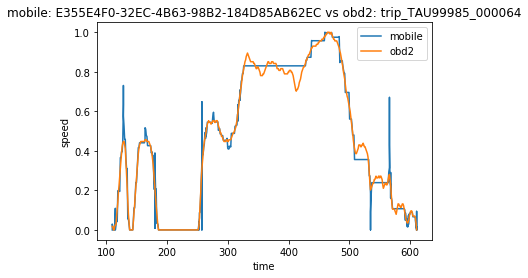

start point 1495814628.0021 109.547
end point 1495815467.0001 610.745
similarity distance 3.3910768070701636


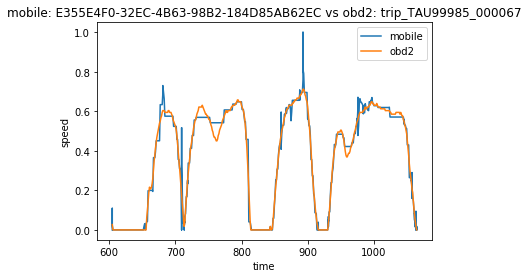

start point 1495814628.0021 604.538
end point 1495815467.0001 1064.831
similarity distance 1.8903948587417065


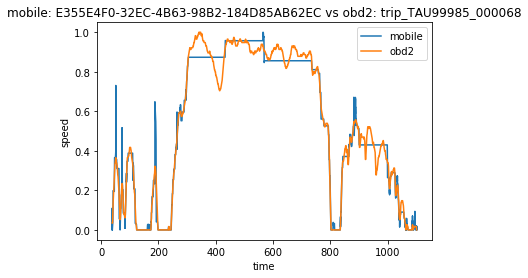

start point 1495814628.0021 38.845
end point 1495815467.0001 1101.148
similarity distance 2.141174672567111


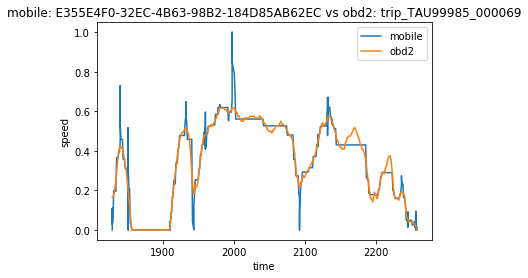

start point 1495814628.0021 1828.714
end point 1495815467.0001 2257.28
similarity distance 2.8642173479906465


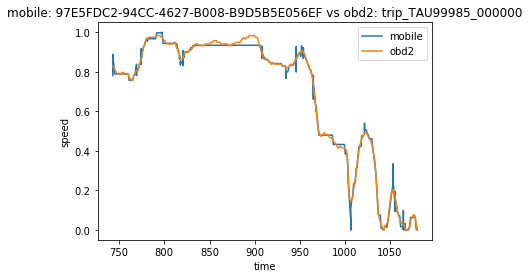

start point 1495837966.9999 742.844
end point 1495838780.9999 1079.914
similarity distance 0.9010114026526275


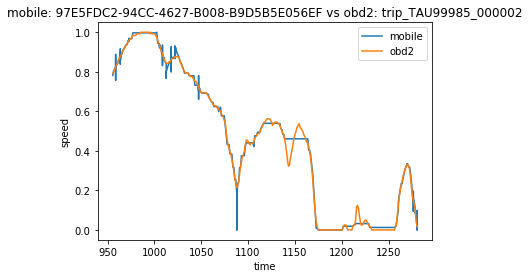

start point 1495837966.9999 955.559
end point 1495838780.9999 1280.375
similarity distance 1.1231630290552155


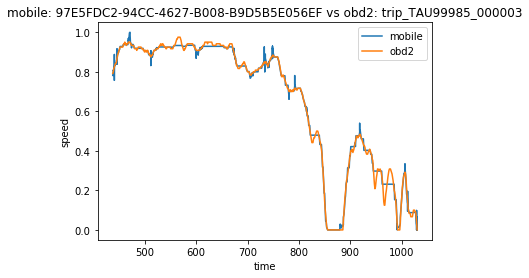

start point 1495837966.9999 437.695
end point 1495838780.9999 1030.204
similarity distance 0.7393989165045471


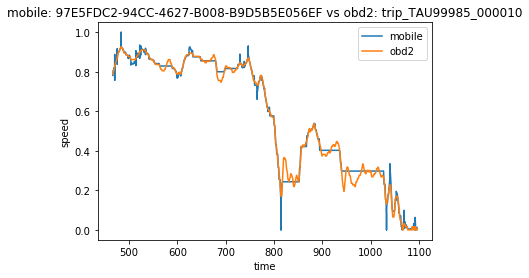

start point 1495837966.9999 466.463
end point 1495838780.9999 1095.847
similarity distance 1.0640947524923932


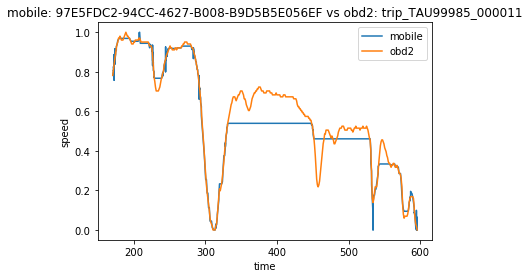

start point 1495837966.9999 170.647
end point 1495838780.9999 595.642
similarity distance 1.7477803849902358


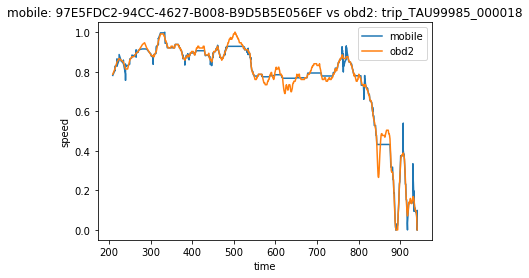

start point 1495837966.9999 209.004
end point 1495838780.9999 940.843
similarity distance 1.1303170709596697


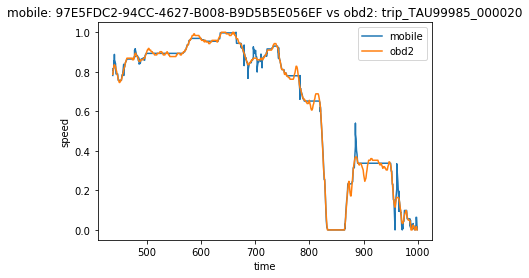

start point 1495837966.9999 436.999
end point 1495838780.9999 998.784
similarity distance 1.1367957224771883


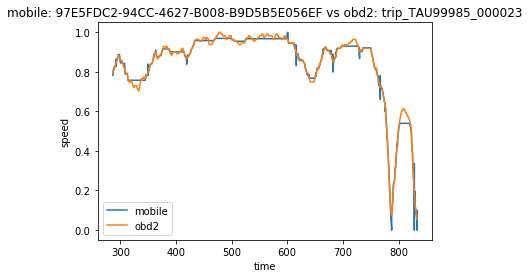

start point 1495837966.9999 286.362
end point 1495838780.9999 833.395
similarity distance 1.099880776943468


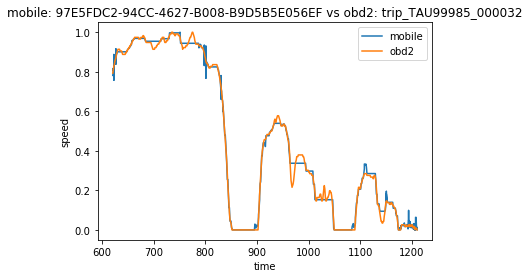

start point 1495837966.9999 621.148
end point 1495838780.9999 1209.828
similarity distance 0.9189226074842249


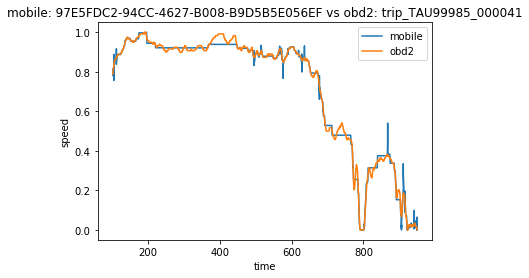

start point 1495837966.9999 101.919
end point 1495838780.9999 949.386
similarity distance 1.09806743231339


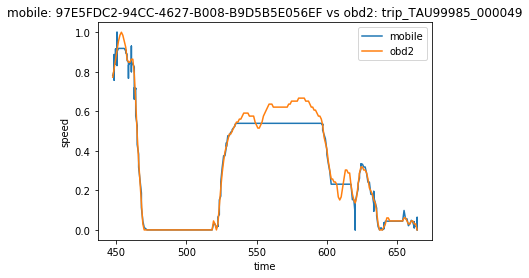

start point 1495837966.9999 447.577
end point 1495838780.9999 664.254
similarity distance 1.192306371141211


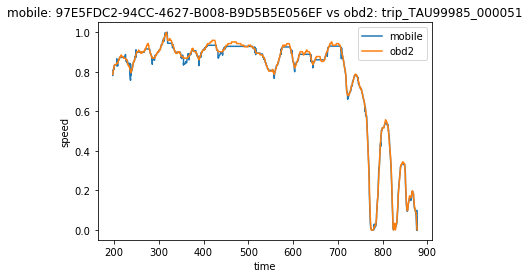

start point 1495837966.9999 197.335
end point 1495838780.9999 877.032
similarity distance 0.38474535688907285


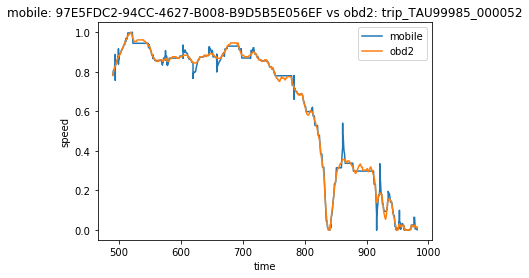

start point 1495837966.9999 489.752
end point 1495838780.9999 981.73
similarity distance 1.1358511977381844


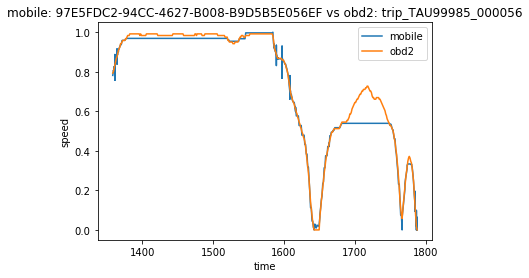

start point 1495837966.9999 1358.009
end point 1495838780.9999 1788.075
similarity distance 1.2704465368101487


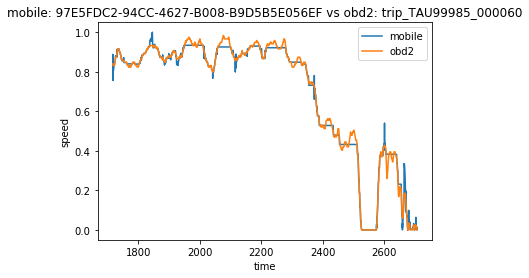

start point 1495837966.9999 1717.39
end point 1495838780.9999 2707.229
similarity distance 0.9461027150858612


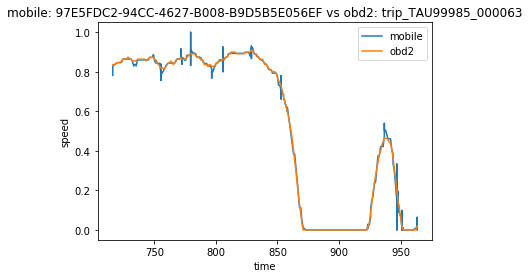

start point 1495837966.9999 716.233
end point 1495838780.9999 963.46
similarity distance 1.0404902607333373


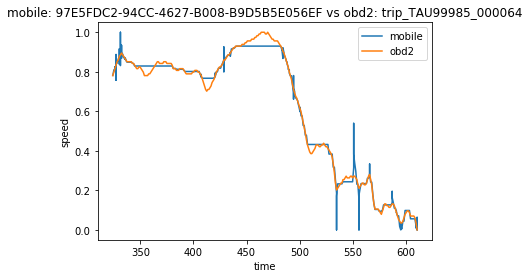

start point 1495837966.9999 323.971
end point 1495838780.9999 610.745
similarity distance 1.64337317207719


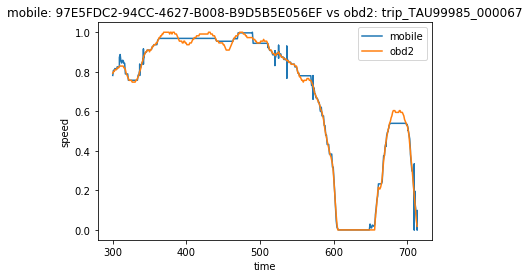

start point 1495837966.9999 299.935
end point 1495838780.9999 713.367
similarity distance 1.1072803466896146


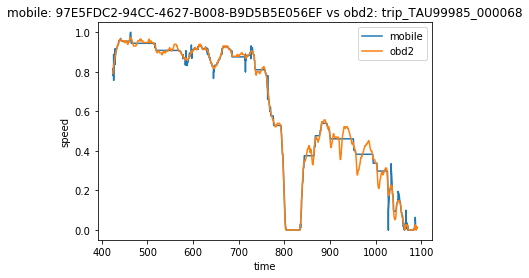

start point 1495837966.9999 424.332
end point 1495838780.9999 1090.813
similarity distance 0.9579952225927781


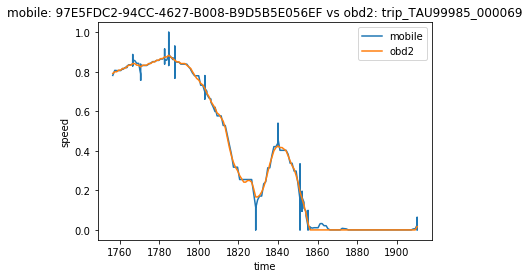

start point 1495837966.9999 1756.5
end point 1495838780.9999 1910.254
similarity distance 1.3089025766120443


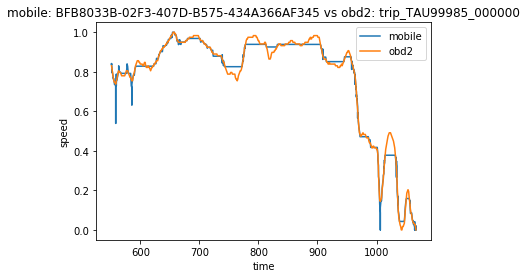

start point 1495841107.0001 551.106
end point 1495842047 1066.714
similarity distance 1.2892666128798111


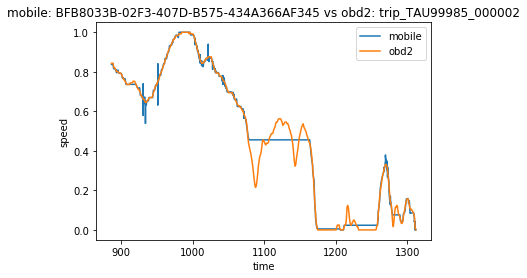

start point 1495841107.0001 886.751
end point 1495842047 1311.954
similarity distance 1.0867352127713747


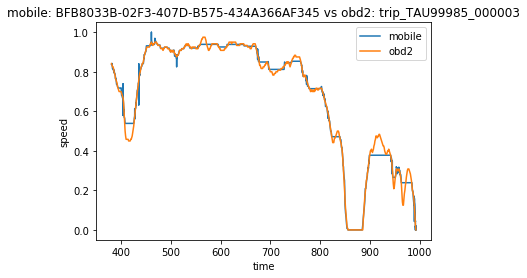

start point 1495841107.0001 380.972
end point 1495842047 992.377
similarity distance 0.866658172006794


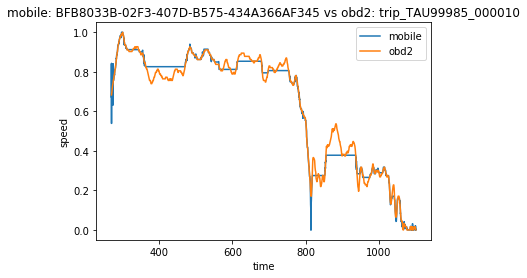

start point 1495841107.0001 269.704
end point 1495842047 1100.959
similarity distance 1.4464568005355563


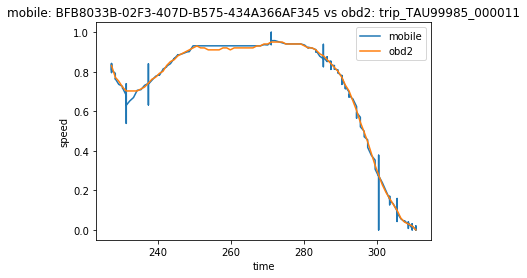

start point 1495841107.0001 227.285
end point 1495842047 310.583
similarity distance 1.3333942676839137


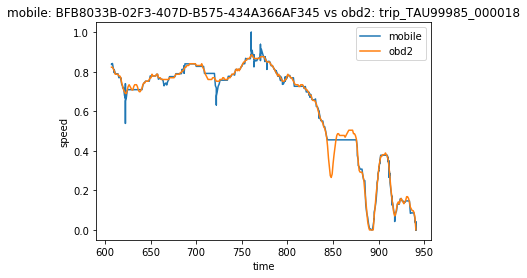

start point 1495841107.0001 607.22
end point 1495842047 940.843
similarity distance 1.03641988847021


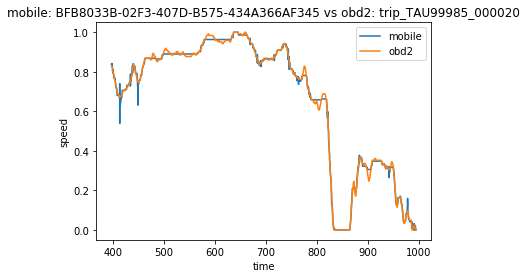

start point 1495841107.0001 396.857
end point 1495842047 994.674
similarity distance 0.7185752947097163


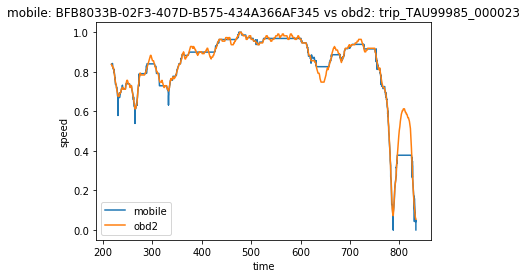

start point 1495841107.0001 217.678
end point 1495842047 833.395
similarity distance 1.457324144635603


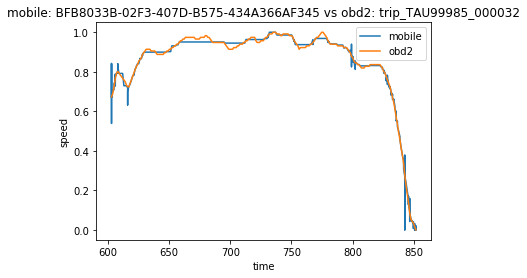

start point 1495841107.0001 602.875
end point 1495842047 851.8
similarity distance 1.366760835961138


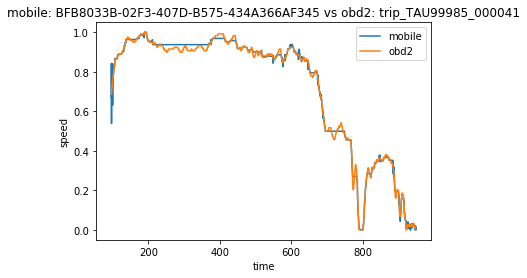

start point 1495841107.0001 96.743
end point 1495842047 949.386
similarity distance 1.0432720191890654


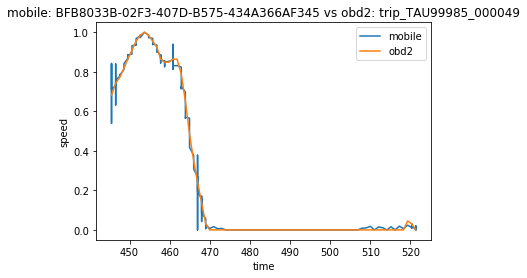

start point 1495841107.0001 445.504
end point 1495842047 521.37
similarity distance 1.4532488504986794


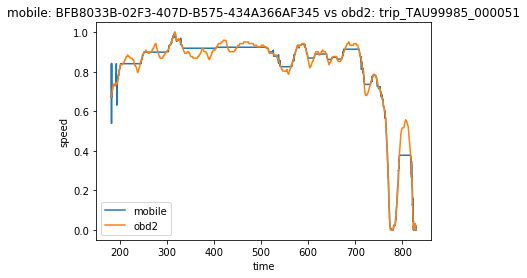

start point 1495841107.0001 182.16
end point 1495842047 828.453
similarity distance 1.2510896719400224


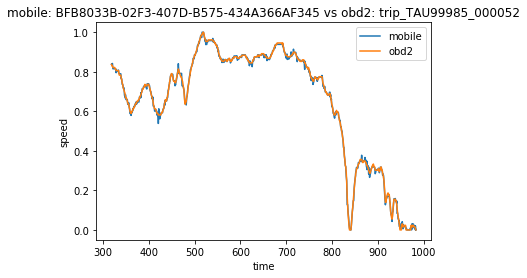

start point 1495841107.0001 318.612
end point 1495842047 982.754
similarity distance 0.2229875335036785


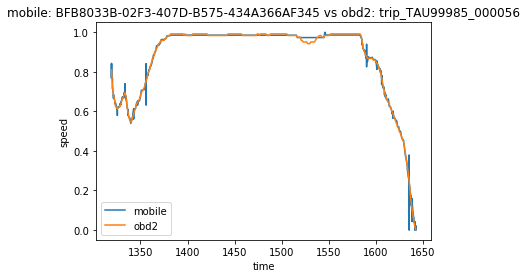

start point 1495841107.0001 1319.273
end point 1495842047 1642.564
similarity distance 1.1068836587733741


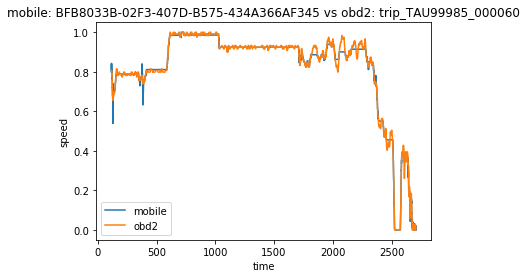

start point 1495841107.0001 116.671
end point 1495842047 2707.229
similarity distance 0.979151276987637


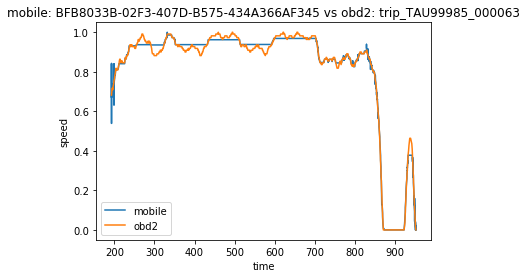

start point 1495841107.0001 192.807
end point 1495842047 952.082
similarity distance 1.1048990919332062


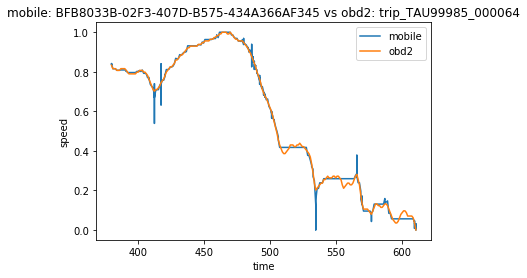

start point 1495841107.0001 379.978
end point 1495842047 610.745
similarity distance 1.141530433034608


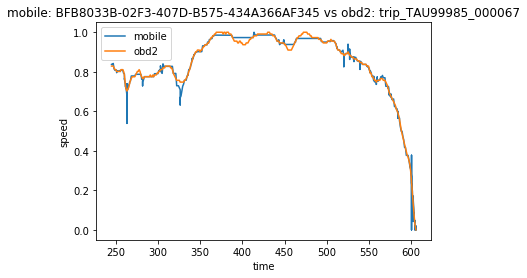

start point 1495841107.0001 244.956
end point 1495842047 605.576
similarity distance 1.3112446646382772


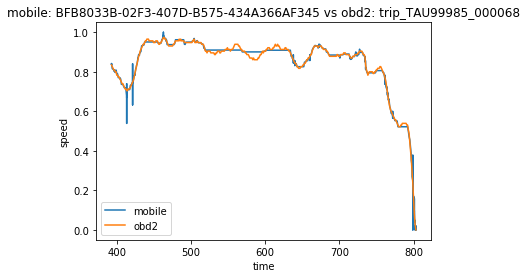

start point 1495841107.0001 392.845
end point 1495842047 802.932
similarity distance 1.3284012839584634


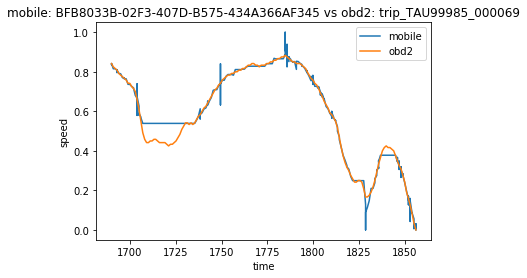

start point 1495841107.0001 1689.866
end point 1495842047 1856.192
similarity distance 1.0342850421569192


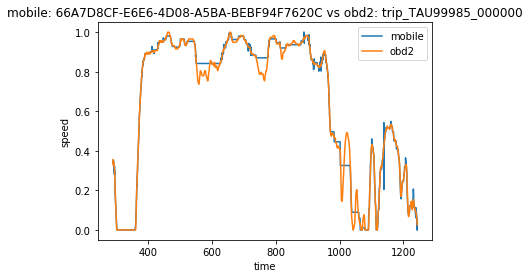

start point 1495980237.0163 288.527
end point 1495981153.0001 1243.374
similarity distance 1.2129134354914275


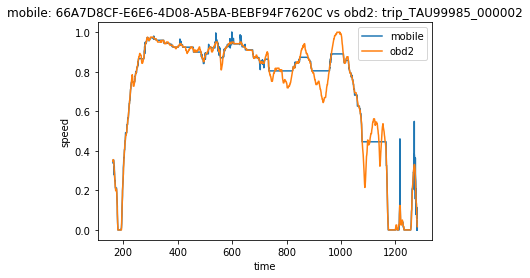

start point 1495980237.0163 161.851
end point 1495981153.0001 1280.375
similarity distance 2.116446622707318


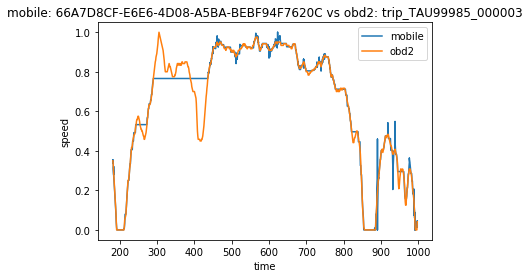

start point 1495980237.0163 181.628
end point 1495981153.0001 997.451
similarity distance 2.1697713541500017


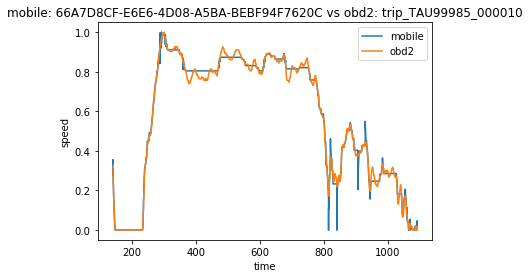

start point 1495980237.0163 139.991
end point 1495981153.0001 1091.83
similarity distance 1.7623258112290179


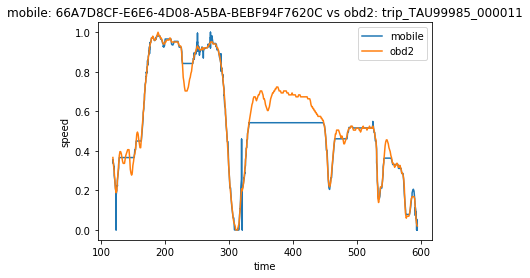

start point 1495980237.0163 118.268
end point 1495981153.0001 594.627
similarity distance 2.0550196534609837


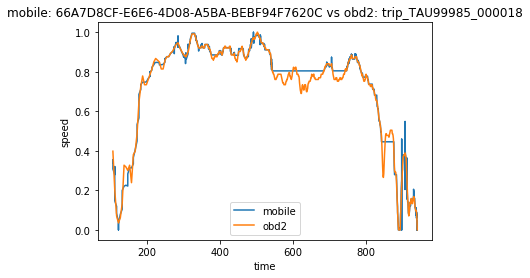

start point 1495980237.0163 107.133
end point 1495981153.0001 940.843
similarity distance 1.714282707644685


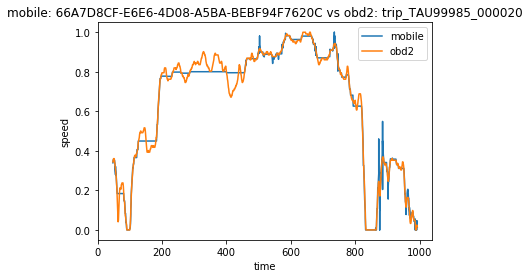

start point 1495980237.0163 47.11
end point 1495981153.0001 992.602
similarity distance 1.6645320068966314


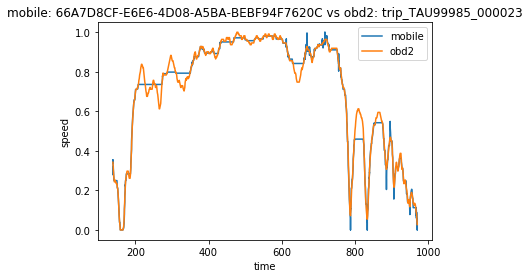

start point 1495980237.0163 138.499
end point 1495981153.0001 969.926
similarity distance 1.2089332105200263


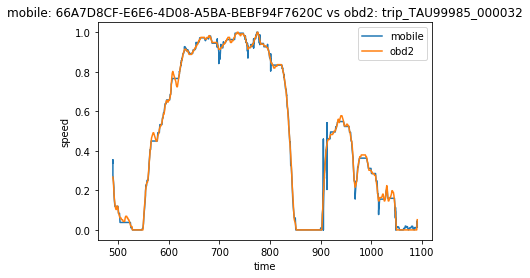

start point 1495980237.0163 489.844
end point 1495981153.0001 1090.45
similarity distance 1.3800651560954111


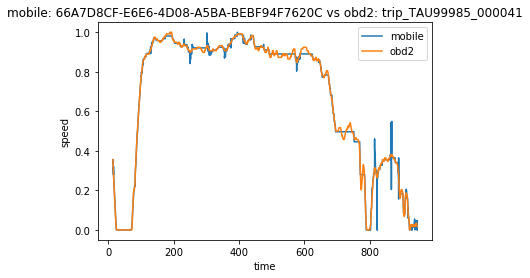

start point 1495980237.0163 14.409
end point 1495981153.0001 945.44
similarity distance 1.5012516353467429


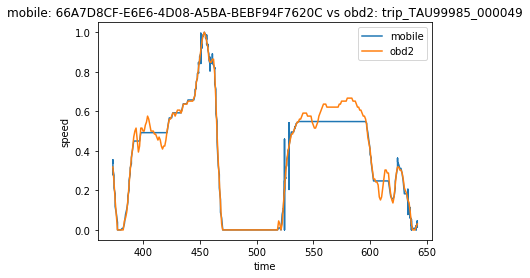

start point 1495980237.0163 373.011
end point 1495981153.0001 641.639
similarity distance 1.5441604297280158


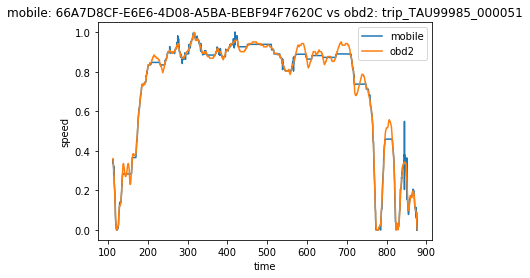

start point 1495980237.0163 112.517
end point 1495981153.0001 877.032
similarity distance 1.259578119097843


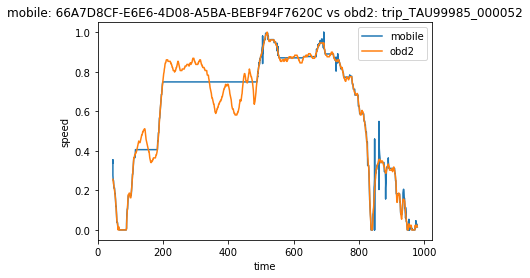

start point 1495980237.0163 46.345
end point 1495981153.0001 978.644
similarity distance 2.2251007636951106


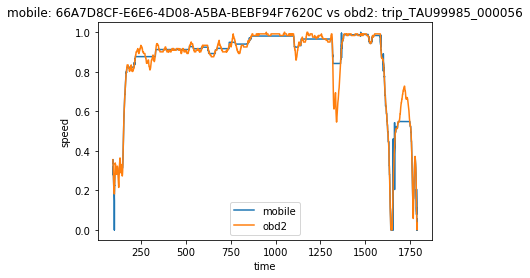

start point 1495980237.0163 93.808
end point 1495981153.0001 1789.112
similarity distance 2.2800061090051744


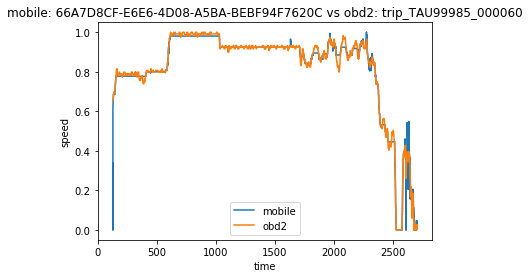

start point 1495980237.0163 127.827
end point 1495981153.0001 2704.133
similarity distance 4.148866559466549


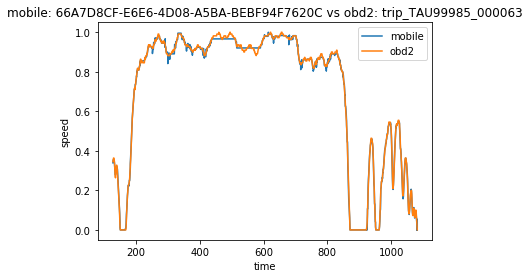

start point 1495980237.0163 126.796
end point 1495981153.0001 1081.929
similarity distance 0.37193805883182607


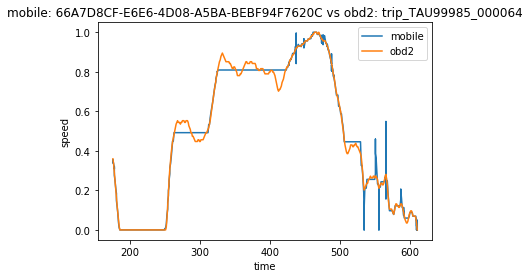

start point 1495980237.0163 175.788
end point 1495981153.0001 610.745
similarity distance 2.4219632379993614


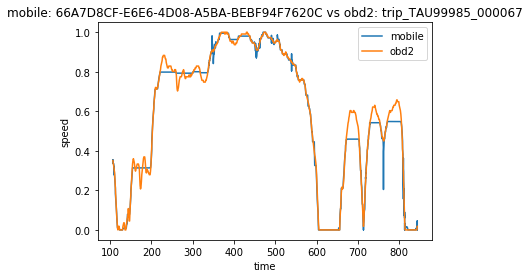

start point 1495980237.0163 106.622
end point 1495981153.0001 843.588
similarity distance 1.239567759024386


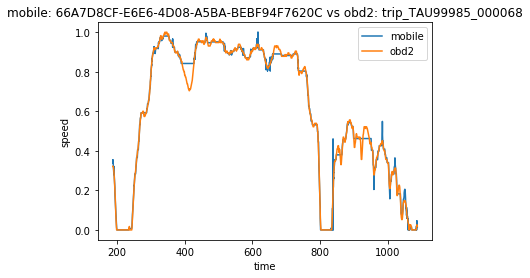

start point 1495980237.0163 187.64
end point 1495981153.0001 1087.736
similarity distance 1.4022382231906


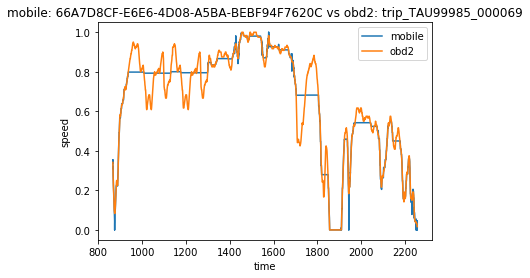

start point 1495980237.0163 866.288
end point 1495981153.0001 2256.314
similarity distance 2.6040904919825505


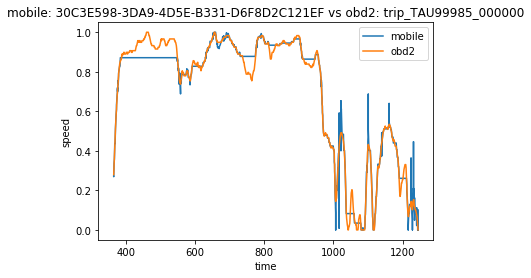

start point 1496001627.9992 365.076
end point 1496002829.0001 1244.412
similarity distance 2.904648209171461


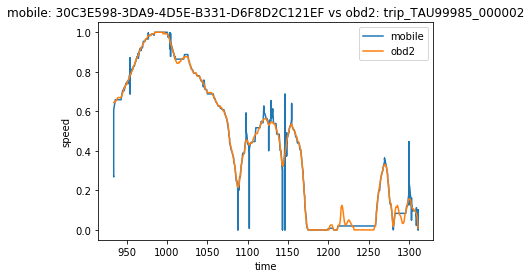

start point 1496001627.9992 934.159
end point 1496002829.0001 1310.964
similarity distance 3.933158542226014


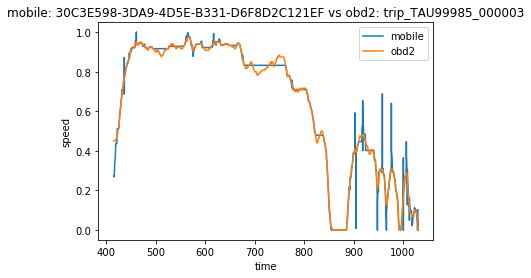

start point 1496001627.9992 415.337
end point 1496002829.0001 1030.204
similarity distance 4.046253377542289


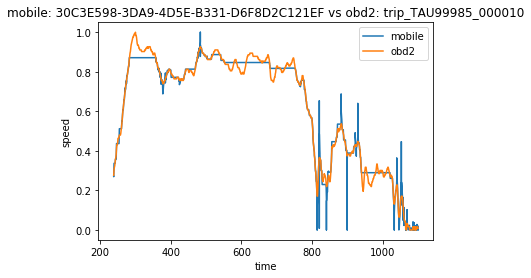

start point 1496001627.9992 238.654
end point 1496002829.0001 1099.923
similarity distance 3.9592459781738256


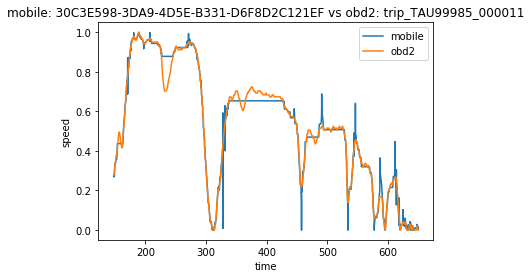

start point 1496001627.9992 147.58
end point 1496002829.0001 649.657
similarity distance 2.6872361256930146


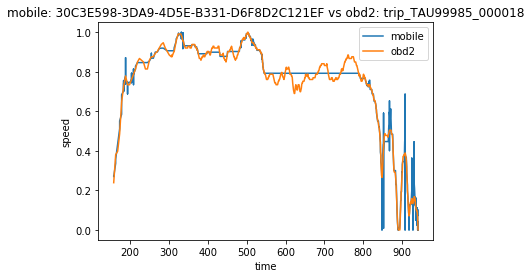

start point 1496001627.9992 158.079
end point 1496002829.0001 940.843
similarity distance 4.127460449948741


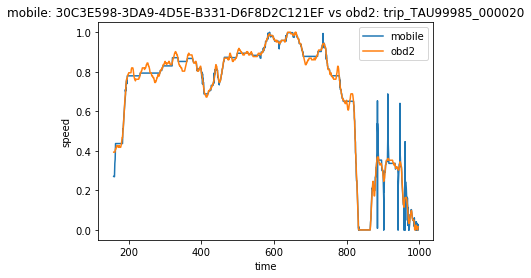

start point 1496001627.9992 158.278
end point 1496002829.0001 996.746
similarity distance 4.369650392984095


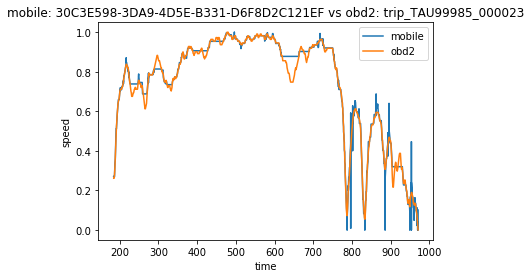

start point 1496001627.9992 184.319
end point 1496002829.0001 970.948
similarity distance 2.780635420055754


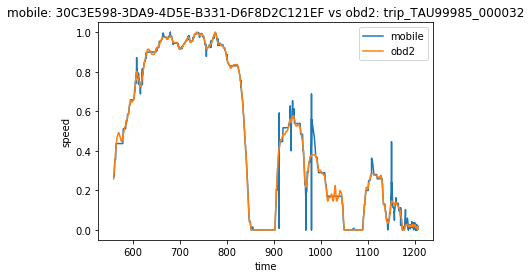

start point 1496001627.9992 559.179
end point 1496002829.0001 1206.765
similarity distance 3.67251023944598


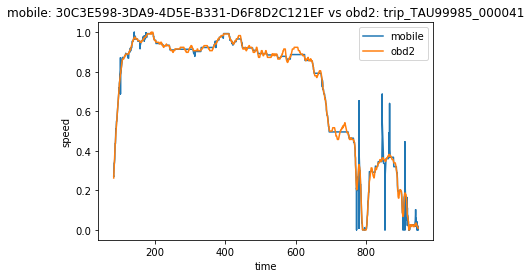

start point 1496001627.9992 82.674
end point 1496002829.0001 948.35
similarity distance 4.400778041314423


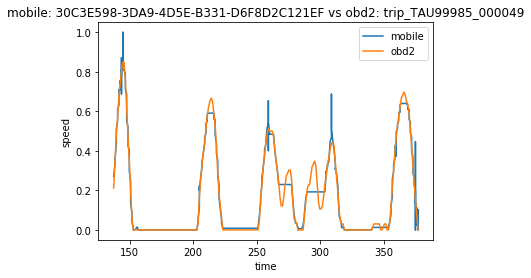

start point 1496001627.9992 137.386
end point 1496002829.0001 377.072
similarity distance 2.6614360593022965


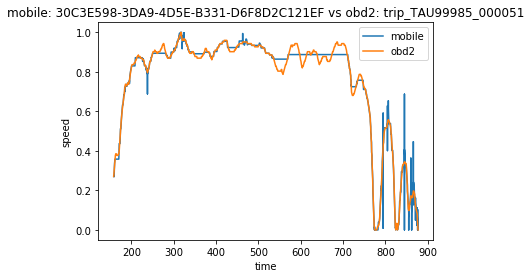

start point 1496001627.9992 158.215
end point 1496002829.0001 877.032
similarity distance 3.8282417923865917


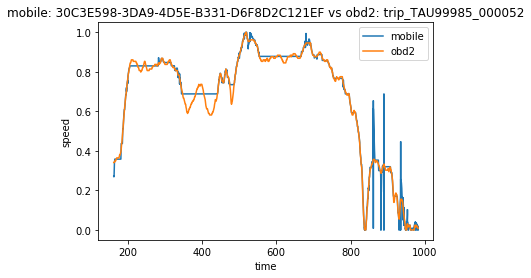

start point 1496001627.9992 162.445
end point 1496002829.0001 981.73
similarity distance 4.672798441398224


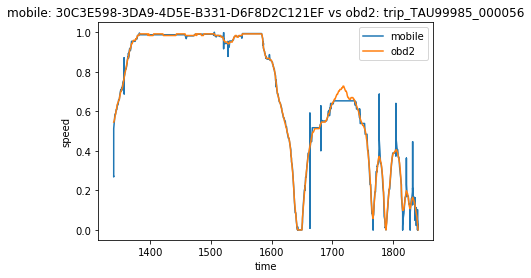

start point 1496001627.9992 1339.739
end point 1496002829.0001 1840.902
similarity distance 3.0772726386383913


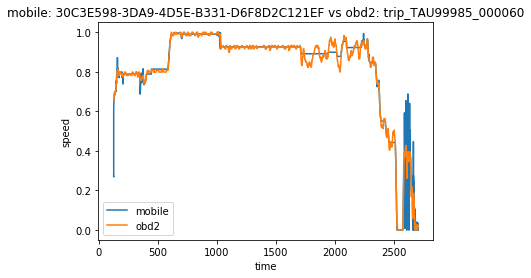

start point 1496001627.9992 127.827
end point 1496002829.0001 2704.133
similarity distance 4.038118420673264


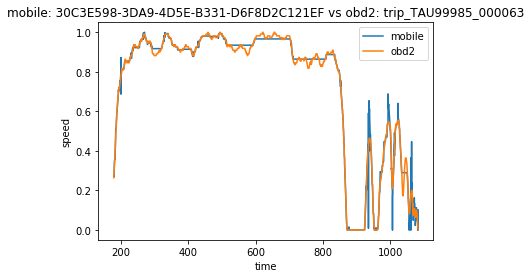

start point 1496001627.9992 179.499
end point 1496002829.0001 1081.929
similarity distance 2.4492554493915653


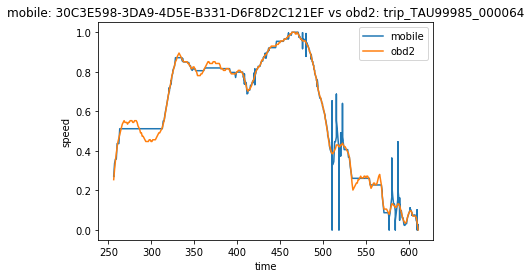

start point 1496001627.9992 256.092
end point 1496002829.0001 610.745
similarity distance 5.291986810193203


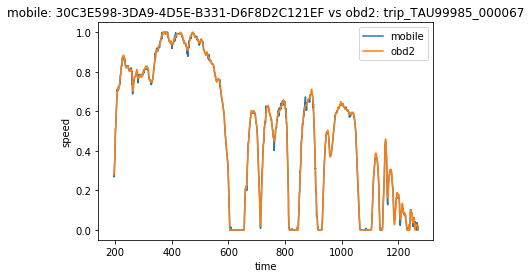

start point 1496001627.9992 195.714
end point 1496002829.0001 1269.078
similarity distance 0.36966358062368826


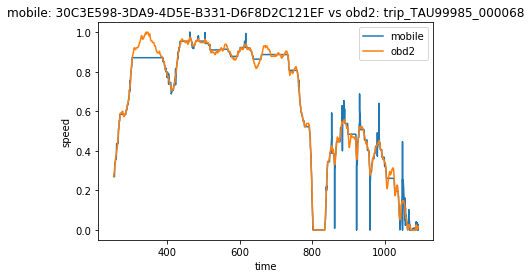

start point 1496001627.9992 252.687
end point 1496002829.0001 1091.848
similarity distance 3.4530973213361955


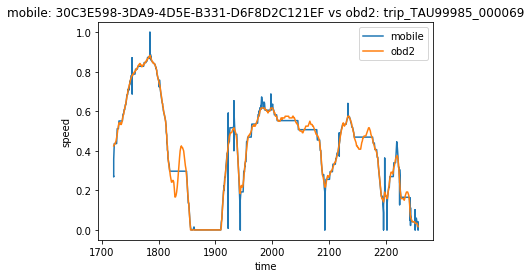

start point 1496001627.9992 1721.051
end point 1496002829.0001 2256.314
similarity distance 2.699194282914817


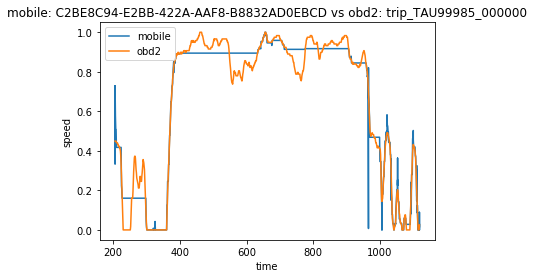

start point 1496141957.9999 205.351
end point 1496142610.0002 1118.994
similarity distance 2.6519592125344347


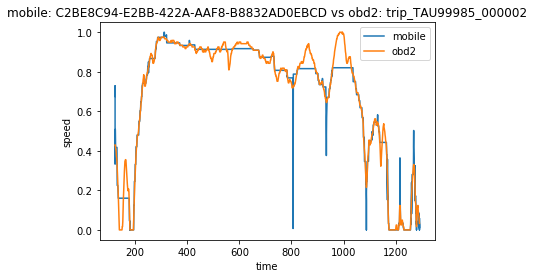

start point 1496141957.9999 122.946
end point 1496142610.0002 1291.566
similarity distance 2.616744668925861


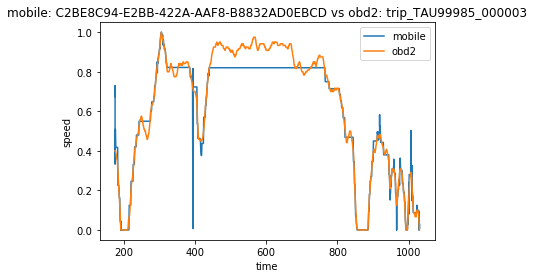

start point 1496141957.9999 175.565
end point 1496142610.0002 1030.204
similarity distance 2.7064087896538163


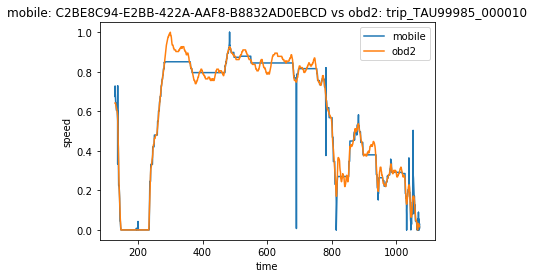

start point 1496141957.9999 128.895
end point 1496142610.0002 1072.22
similarity distance 2.0241037318466346


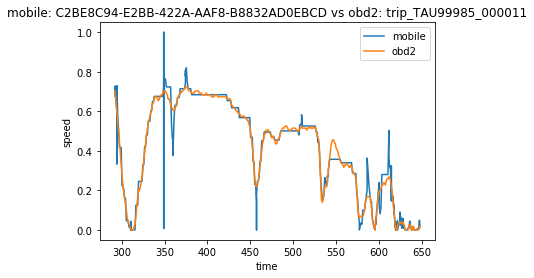

start point 1496141957.9999 292.294
end point 1496142610.0002 647.585
similarity distance 2.055043195807827


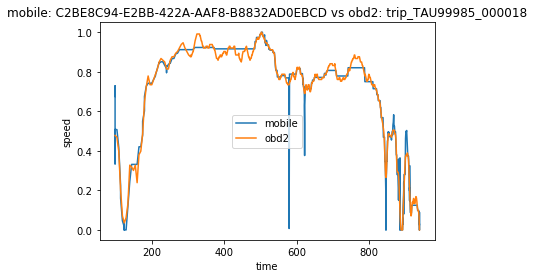

start point 1496141957.9999 96.948
end point 1496142610.0002 940.843
similarity distance 2.196543104782773


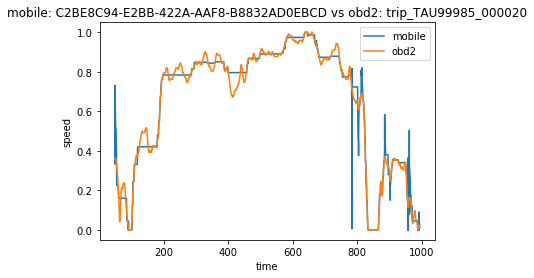

start point 1496141957.9999 49.172
end point 1496142610.0002 992.602
similarity distance 2.787456023915565


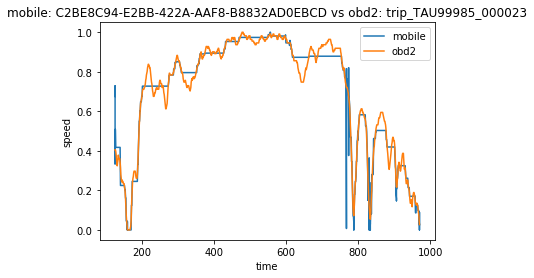

start point 1496141957.9999 124.514
end point 1496142610.0002 969.926
similarity distance 2.450488324732344


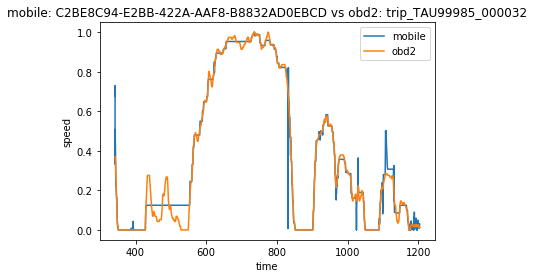

start point 1496141957.9999 341.925
end point 1496142610.0002 1203.657
similarity distance 2.5842250257466883


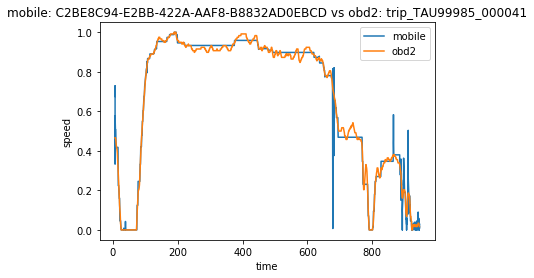

start point 1496141957.9999 6.423
end point 1496142610.0002 945.44
similarity distance 2.191336564306709


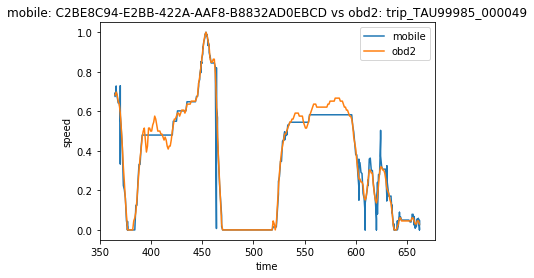

start point 1496141957.9999 364.925
end point 1496142610.0002 662.183
similarity distance 1.733427184984164


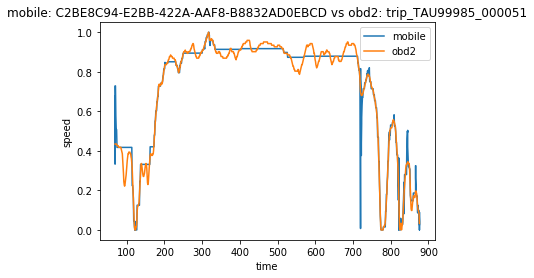

start point 1496141957.9999 69.195
end point 1496142610.0002 876.032
similarity distance 2.238715993538734


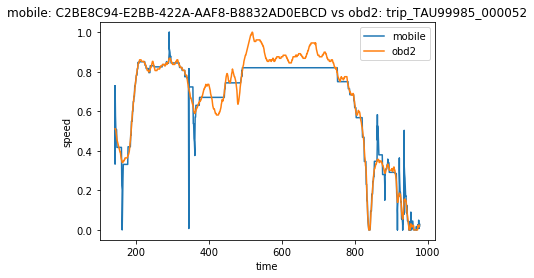

start point 1496141957.9999 142.988
end point 1496142610.0002 976.586
similarity distance 3.307332274209498


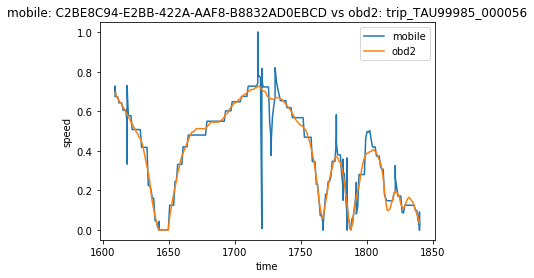

start point 1496141957.9999 1609.273
end point 1496142610.0002 1839.958
similarity distance 1.9999489012667873


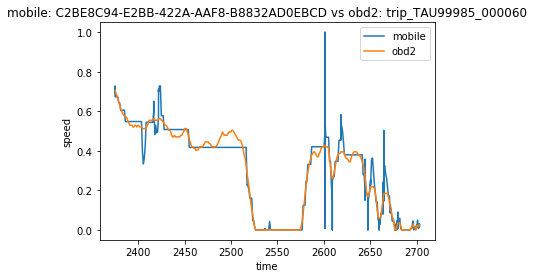

start point 1496141957.9999 2374.92
end point 1496142610.0002 2703.097
similarity distance 4.126930326787866


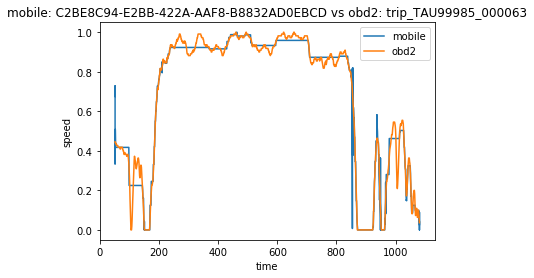

start point 1496141957.9999 50.947
end point 1496142610.0002 1080.89
similarity distance 2.336088601977078


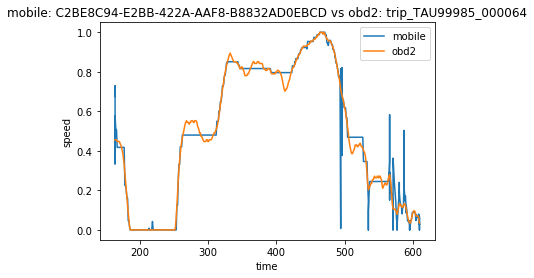

start point 1496141957.9999 163.516
end point 1496142610.0002 609.708
similarity distance 2.570560053691339


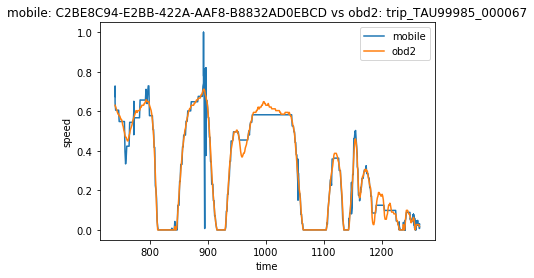

start point 1496141957.9999 740.642
end point 1496142610.0002 1264.947
similarity distance 1.822278065249378


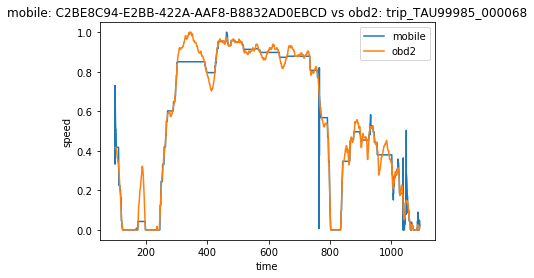

start point 1496141957.9999 99.626
end point 1496142610.0002 1091.848
similarity distance 2.7052094938092677


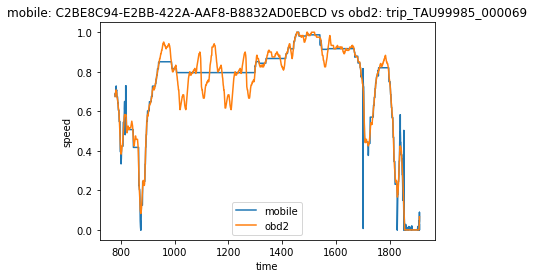

start point 1496141957.9999 778.77
end point 1496142610.0002 1911.289
similarity distance 2.5771260163343017


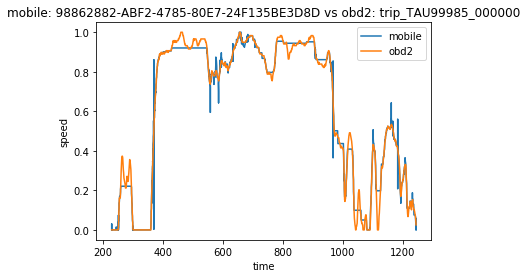

start point 1496346170.9989 229.671
end point 1496348283 1243.374
similarity distance 3.534585528824561


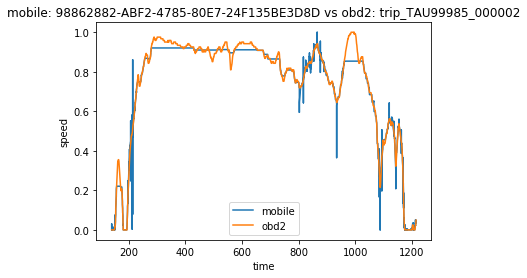

start point 1496346170.9989 139.384
end point 1496348283 1214.756
similarity distance 3.7184231627905304


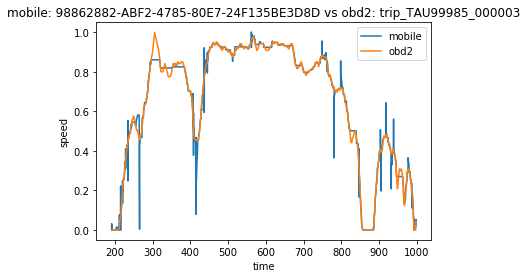

start point 1496346170.9989 191.686
end point 1496348283 997.451
similarity distance 3.1444720744479024


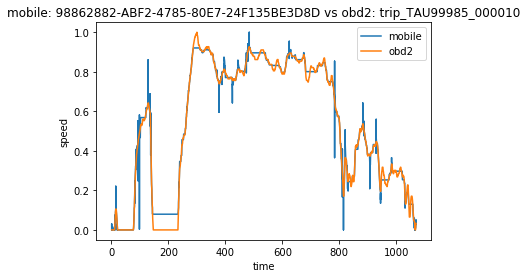

start point 1496346170.9989 1.144
end point 1496348283 1069.144
similarity distance 2.9791051440574305


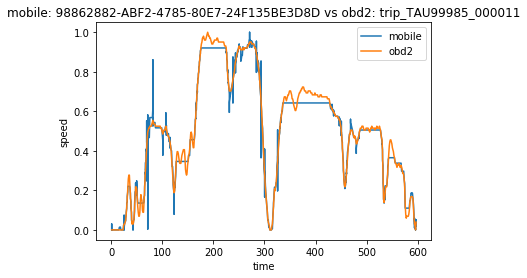

start point 1496346170.9989 1.163
end point 1496348283 596.664
similarity distance 2.7388947948667726


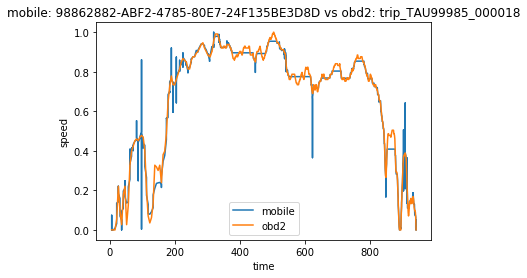

start point 1496346170.9989 5.261
end point 1496348283 940.843
similarity distance 3.6708011536021092


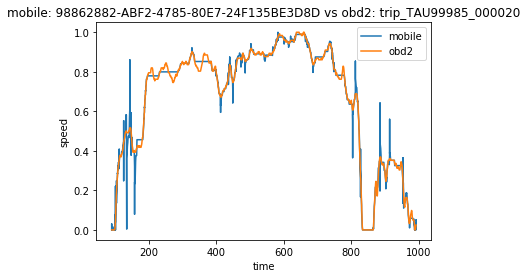

start point 1496346170.9989 90.598
end point 1496348283 991.579
similarity distance 3.591238692513471


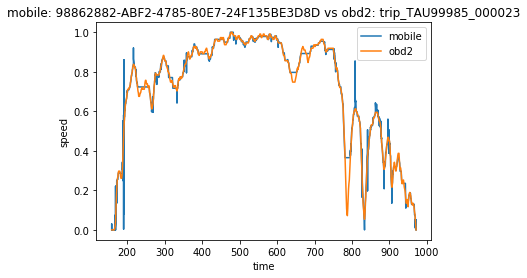

start point 1496346170.9989 158.678
end point 1496348283 970.948
similarity distance 3.340465854747201


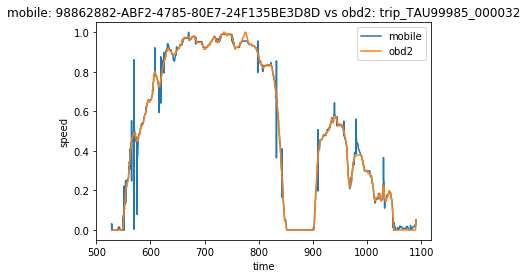

start point 1496346170.9989 528.492
end point 1496348283 1090.45
similarity distance 3.4623640073443607


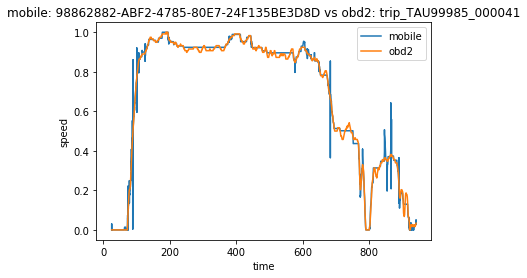

start point 1496346170.9989 25.377
end point 1496348283 941.4
similarity distance 4.080643554956491


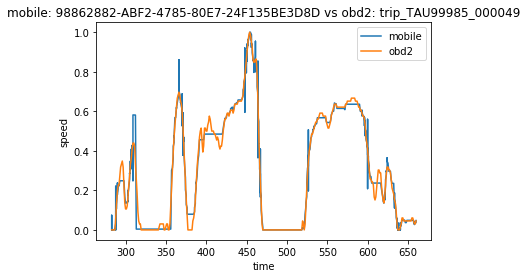

start point 1496346170.9989 282.499
end point 1496348283 660.109
similarity distance 2.890364593923167


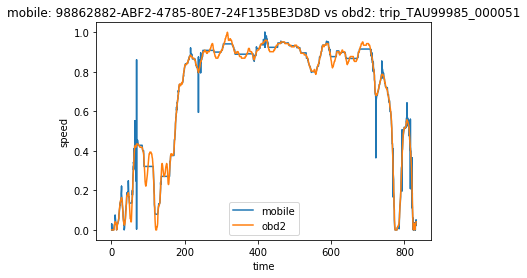

start point 1496346170.9989 1.329
end point 1496348283 831.561
similarity distance 3.475048251459959


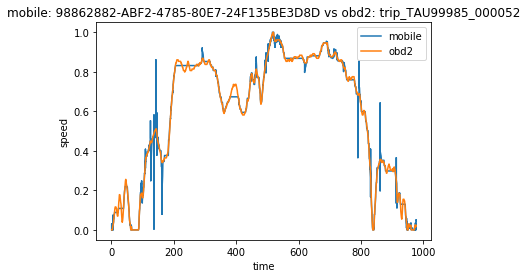

start point 1496346170.9989 1.33
end point 1496348283 976.586
similarity distance 3.73606893020007


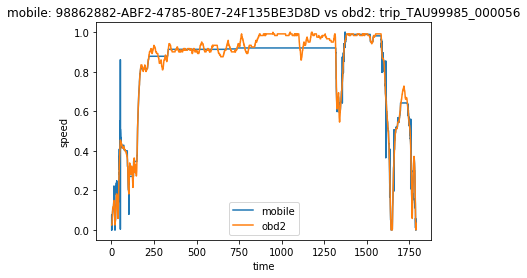

start point 1496346170.9989 1.332
end point 1496348283 1789.112
similarity distance 3.58890590189719


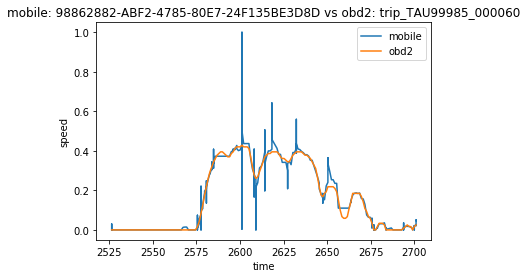

start point 1496346170.9989 2526.417
end point 1496348283 2701.024
similarity distance 11.75596025862635


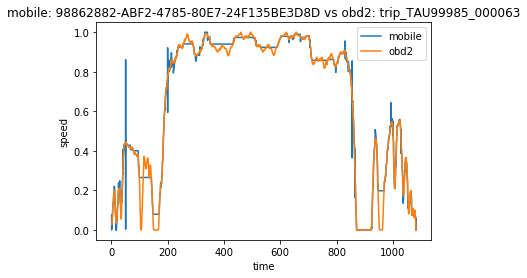

start point 1496346170.9989 1.465
end point 1496348283 1081.929
similarity distance 3.5444002727588795


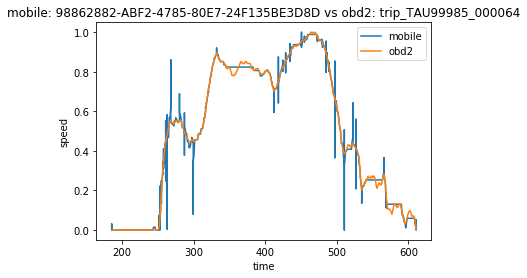

start point 1496346170.9989 185.762
end point 1496348283 610.745
similarity distance 4.585696937794088


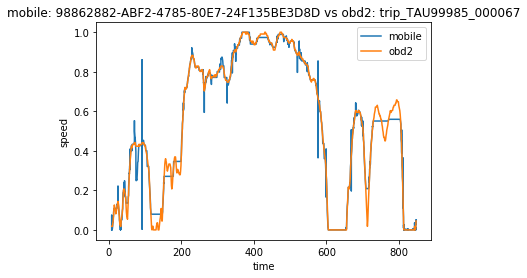

start point 1496346170.9989 7.614
end point 1496348283 847.694
similarity distance 3.332293438919722


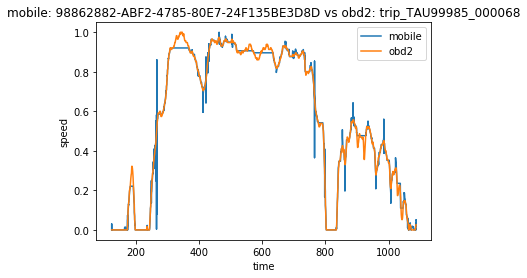

start point 1496346170.9989 124.171
end point 1496348283 1086.713
similarity distance 3.333870953547078


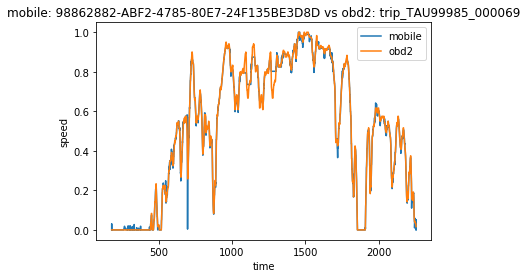

start point 1496346170.9989 178.768
end point 1496348283 2256.314
similarity distance 0.938651540342203


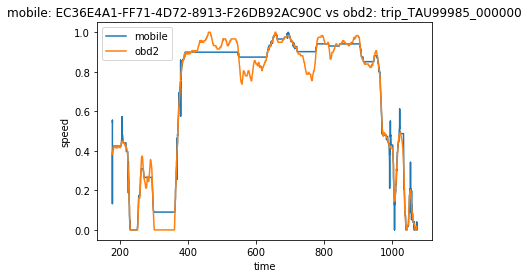

start point 1496356576.0001 177.59
end point 1496357466 1071.789
similarity distance 2.1455417868401487


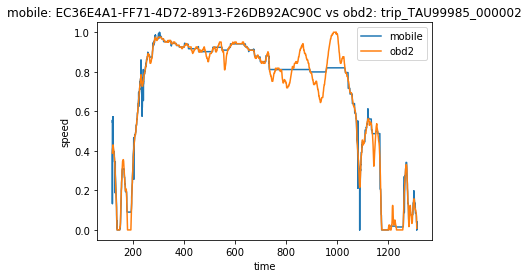

start point 1496356576.0001 120.966
end point 1496357466 1310.964
similarity distance 2.3070502246912388


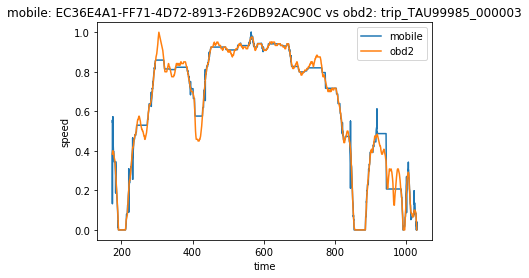

start point 1496356576.0001 174.529
end point 1496357466 1030.204
similarity distance 1.878569179304484


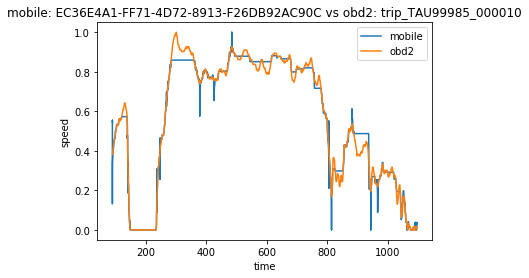

start point 1496356576.0001 88.305
end point 1496357466 1096.85
similarity distance 2.0492138995407645


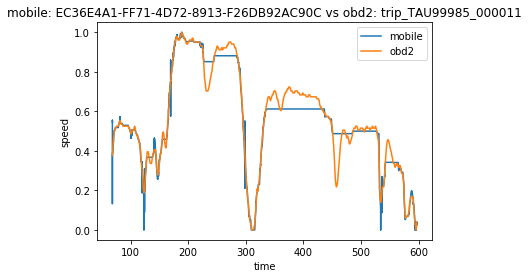

start point 1496356576.0001 68.563
end point 1496357466 596.664
similarity distance 2.1857529963508355


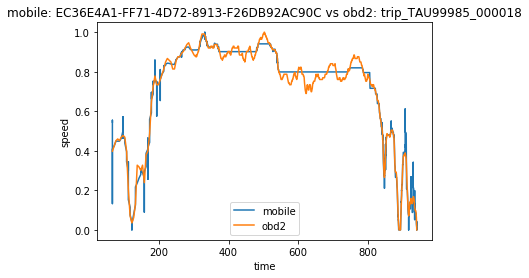

start point 1496356576.0001 66.371
end point 1496357466 940.843
similarity distance 1.8678022812193347


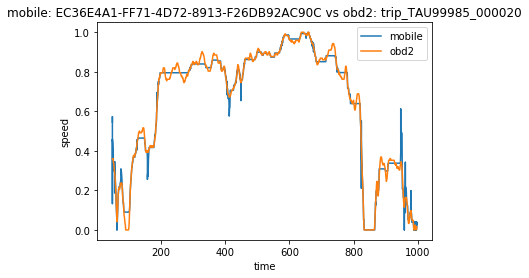

start point 1496356576.0001 49.172
end point 1496357466 996.746
similarity distance 2.244665539632527


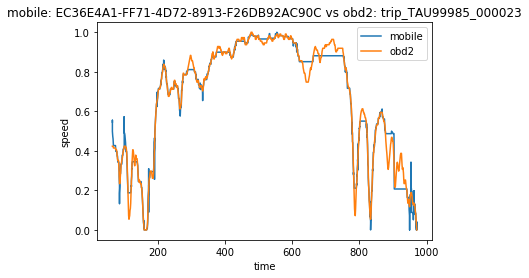

start point 1496356576.0001 63.961
end point 1496357466 970.948
similarity distance 1.6500958930862866


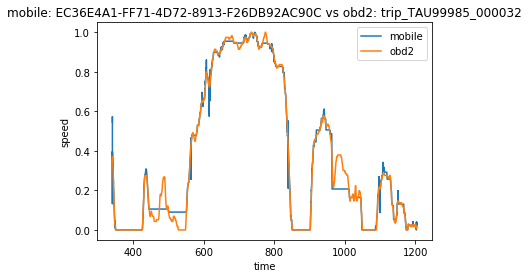

start point 1496356576.0001 341.925
end point 1496357466 1203.657
similarity distance 1.9843690105271194


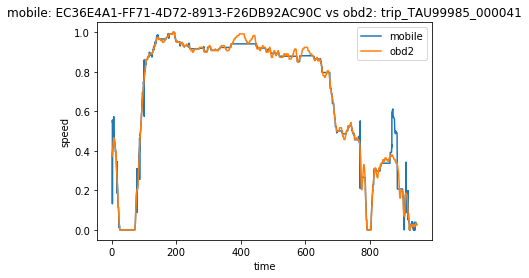

start point 1496356576.0001 2.371
end point 1496357466 944.403
similarity distance 1.9552348292065918


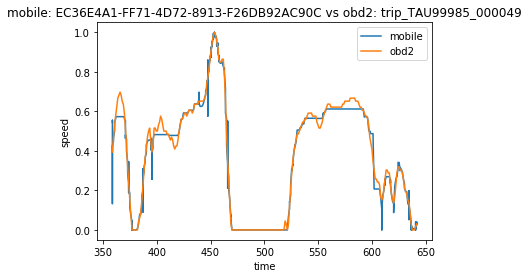

start point 1496356576.0001 358.843
end point 1496357466 641.639
similarity distance 1.7378516507288237


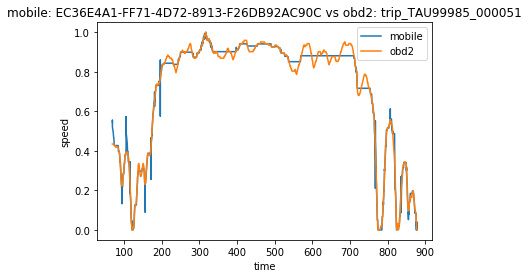

start point 1496356576.0001 69.195
end point 1496357466 877.032
similarity distance 1.6513422967448794


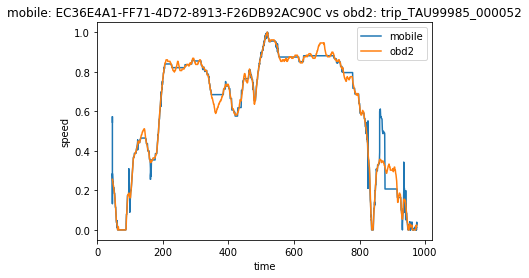

start point 1496356576.0001 46.345
end point 1496357466 974.513
similarity distance 2.6584130434714117


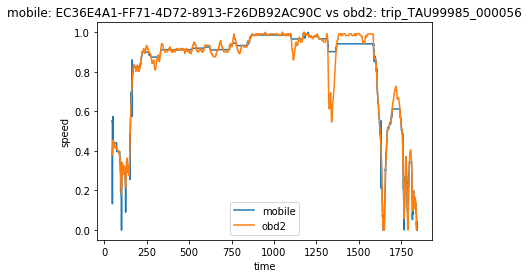

start point 1496356576.0001 48.138
end point 1496357466 1840.902
similarity distance 2.6286081065074014


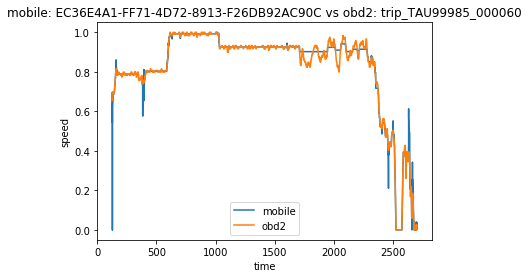

start point 1496356576.0001 127.827
end point 1496357466 2701.024
similarity distance 5.862664857115987


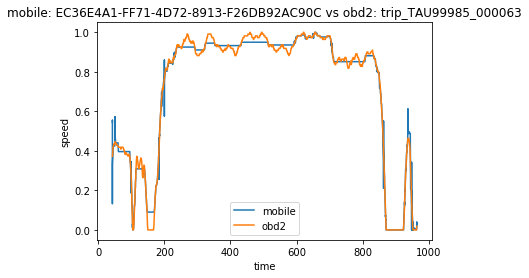

start point 1496356576.0001 42.846
end point 1496357466 963.46
similarity distance 1.9618595128780103


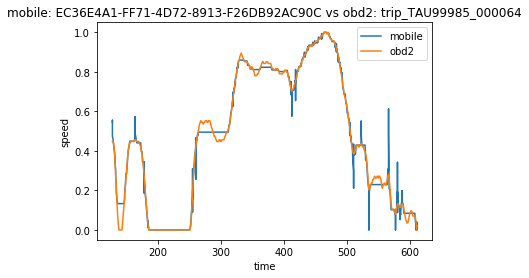

start point 1496356576.0001 127.9
end point 1496357466 610.745
similarity distance 2.266982773893298


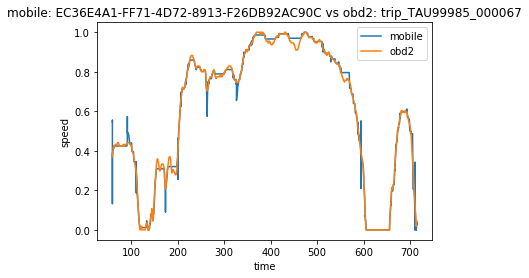

start point 1496356576.0001 59.239
end point 1496357466 714.382
similarity distance 1.745875298695757


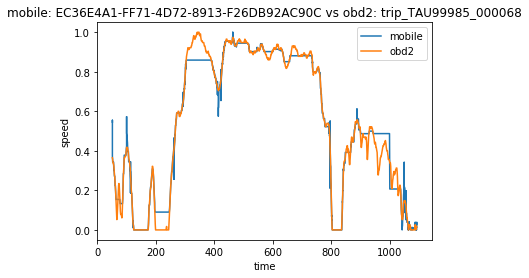

start point 1496356576.0001 51.04
end point 1496357466 1091.848
similarity distance 2.1133655247775174


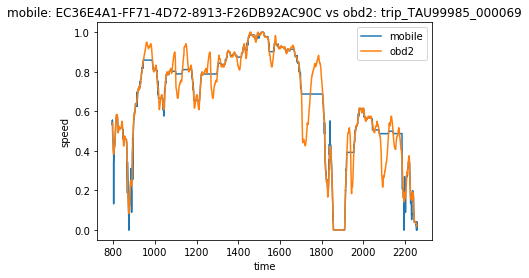

start point 1496356576.0001 795.04
end point 1496357466 2256.314
similarity distance 2.668658378500699


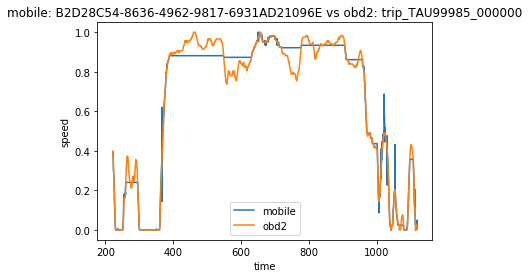

start point 1496427148.9999 221.5
end point 1496428080 1118.994
similarity distance 2.4326396862307416


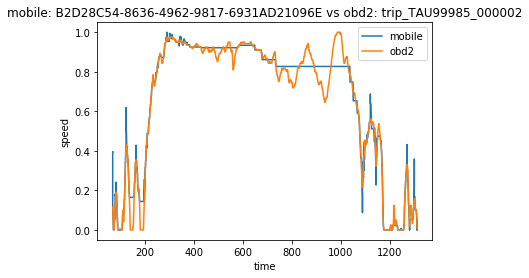

start point 1496427148.9999 67.622
end point 1496428080 1310.964
similarity distance 2.27340242479146


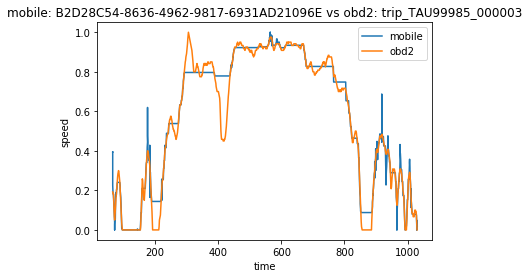

start point 1496427148.9999 65.108
end point 1496428080 1030.204
similarity distance 2.646132846443982


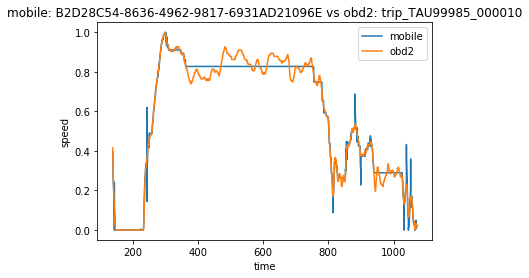

start point 1496427148.9999 138.953
end point 1496428080 1072.22
similarity distance 2.3490310165003945


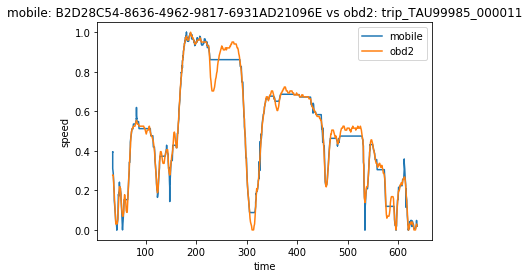

start point 1496427148.9999 34.689
end point 1496428080 637.25
similarity distance 1.4226302770989456


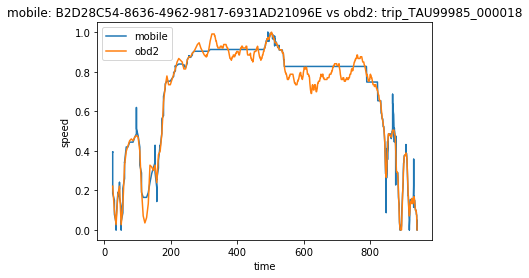

start point 1496427148.9999 25.631
end point 1496428080 940.843
similarity distance 1.9205864596994833


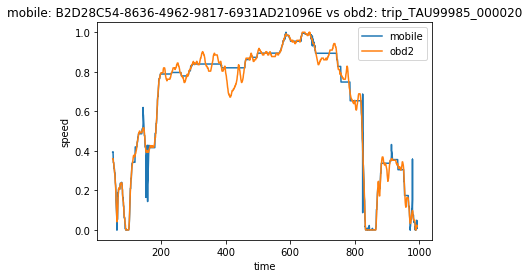

start point 1496427148.9999 50.187
end point 1496428080 992.602
similarity distance 2.763376371143116


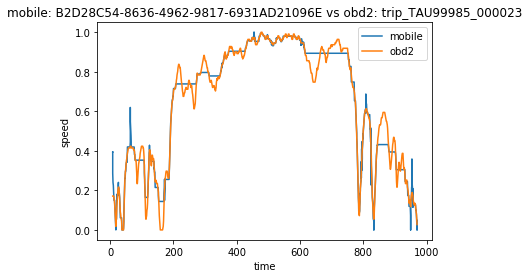

start point 1496427148.9999 8.33
end point 1496428080 969.926
similarity distance 1.9706018998708403


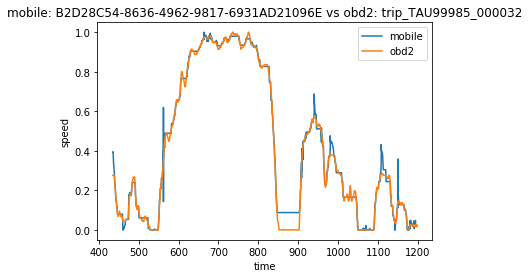

start point 1496427148.9999 435.078
end point 1496428080 1197.467
similarity distance 1.9022635888058292


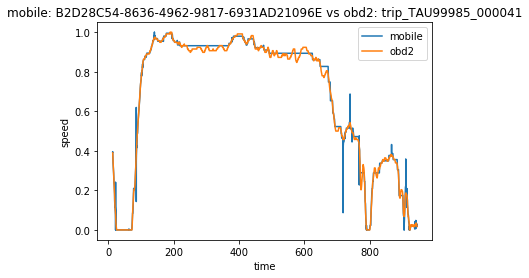

start point 1496427148.9999 13.465
end point 1496428080 945.44
similarity distance 2.660481390453838


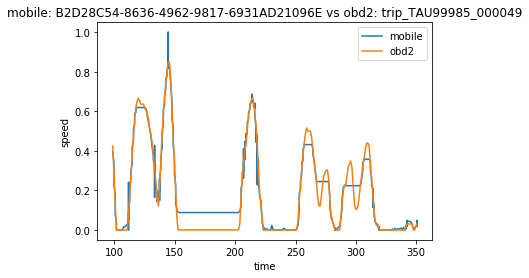

start point 1496427148.9999 98.558
end point 1496428080 350.651
similarity distance 1.7908108722270606


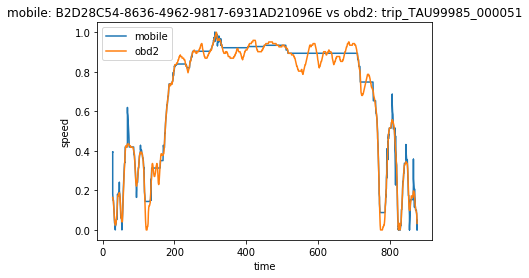

start point 1496427148.9999 28.132
end point 1496428080 876.032
similarity distance 1.707903998966384


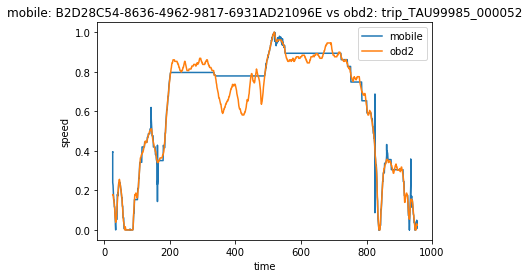

start point 1496427148.9999 25.992
end point 1496428080 954.15
similarity distance 2.9255460721528546


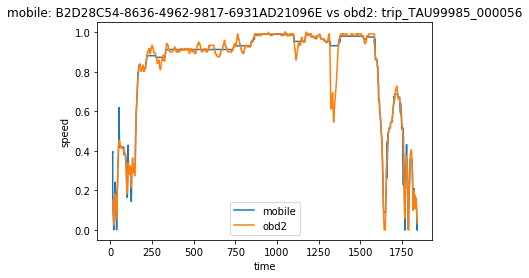

start point 1496427148.9999 14.582
end point 1496428080 1839.958
similarity distance 2.240512230316173


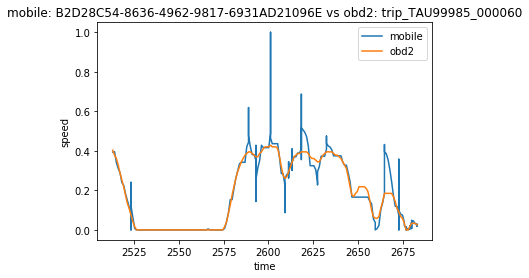

start point 1496427148.9999 2513.131
end point 1496428080 2682.848
similarity distance 6.751298854967399


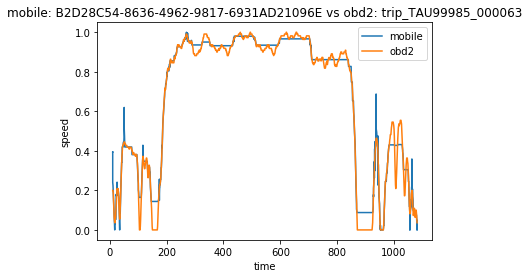

start point 1496427148.9999 10.416
end point 1496428080 1080.89
similarity distance 2.1659403809633972


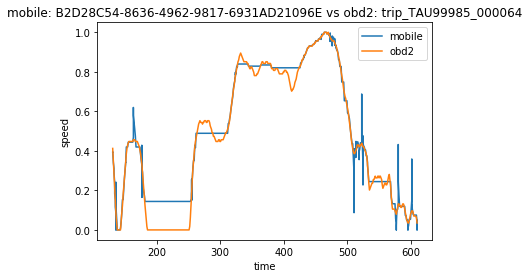

start point 1496427148.9999 130.996
end point 1496428080 609.708
similarity distance 2.911214292491098


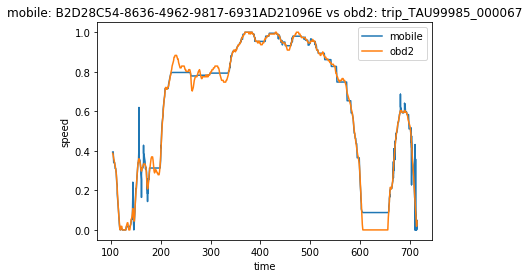

start point 1496427148.9999 103.618
end point 1496428080 714.382
similarity distance 2.3350778544116455


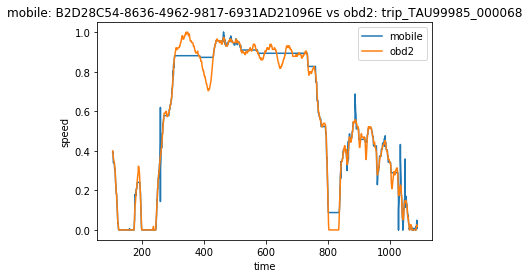

start point 1496427148.9999 104.702
end point 1496428080 1087.736
similarity distance 2.431772922298642


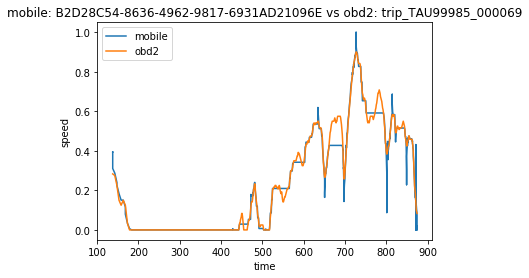

start point 1496427148.9999 138.006
end point 1496428080 874.37
similarity distance 2.60098504510056


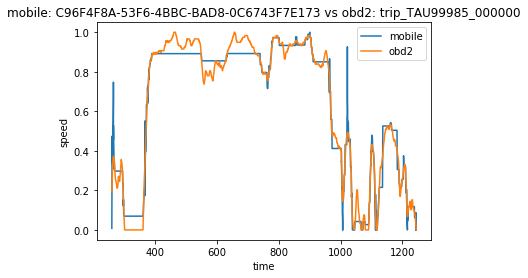

start point 1496747717.0015 259.093
end point 1496748663.0001 1244.412
similarity distance 2.681007176883231


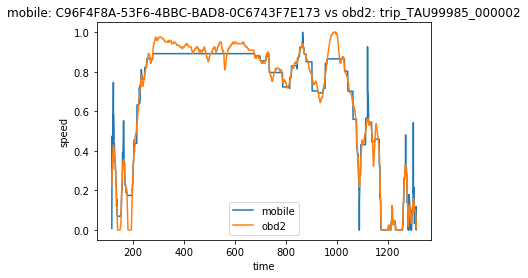

start point 1496747717.0015 116.834
end point 1496748663.0001 1310.964
similarity distance 2.758276322916478


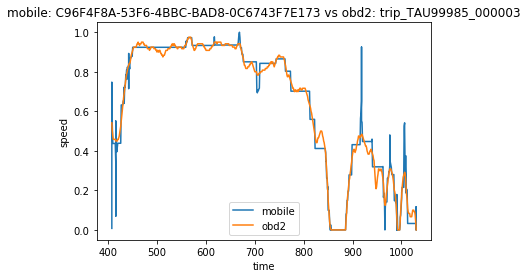

start point 1496747717.0015 407.311
end point 1496748663.0001 1030.204
similarity distance 2.644388858570245


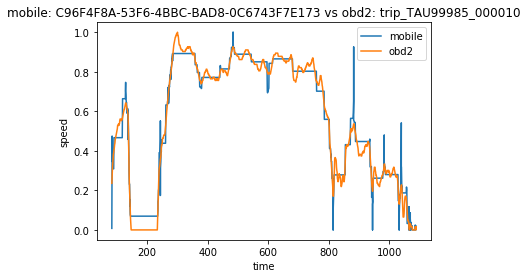

start point 1496747717.0015 83.251
end point 1496748663.0001 1088.743
similarity distance 2.6307872407249357


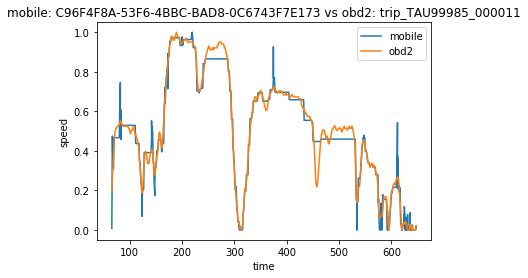

start point 1496747717.0015 65.468
end point 1496748663.0001 647.585
similarity distance 1.6949108647402997


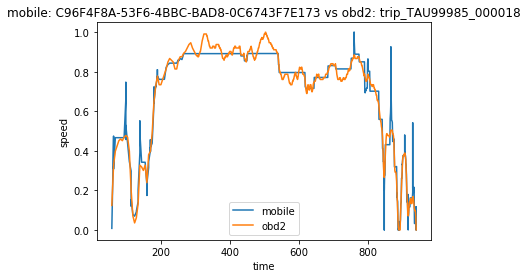

start point 1496747717.0015 56.186
end point 1496748663.0001 940.843
similarity distance 2.724096449771025


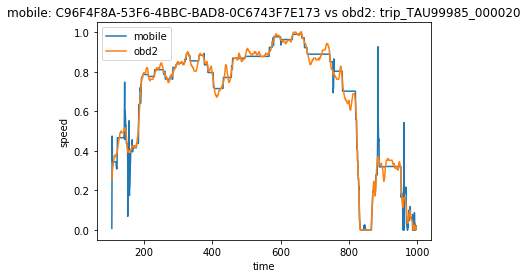

start point 1496747717.0015 106.815
end point 1496748663.0001 996.746
similarity distance 3.174210233574033


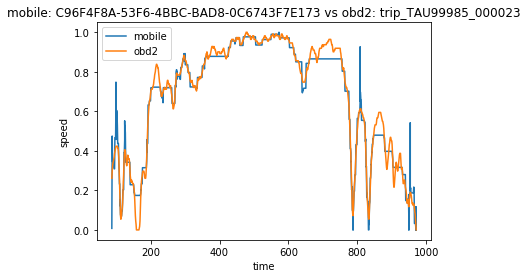

start point 1496747717.0015 87.2
end point 1496748663.0001 970.948
similarity distance 2.25392123576825


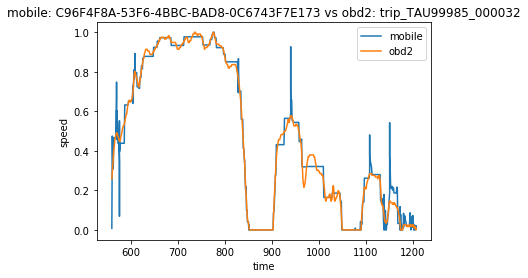

start point 1496747717.0015 559.179
end point 1496748663.0001 1206.765
similarity distance 2.365367541828065


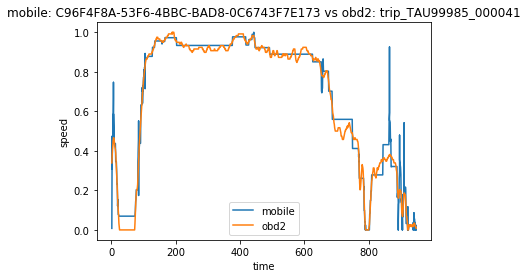

start point 1496747717.0015 1.356
end point 1496748663.0001 948.35
similarity distance 3.0414263577999074


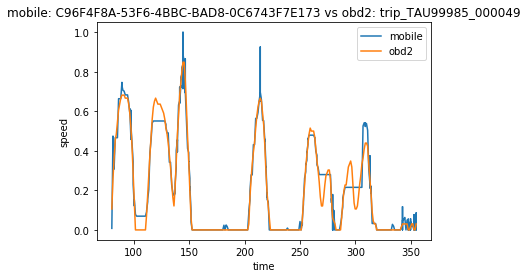

start point 1496747717.0015 80.358
end point 1496748663.0001 354.711
similarity distance 1.3080468577581774


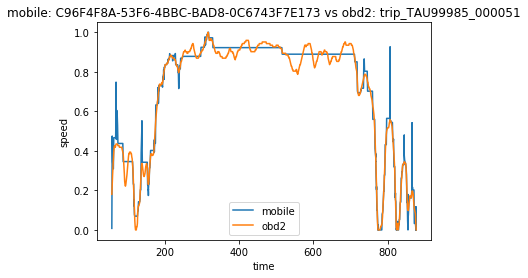

start point 1496747717.0015 57.822
end point 1496748663.0001 877.032
similarity distance 2.2286772132046497


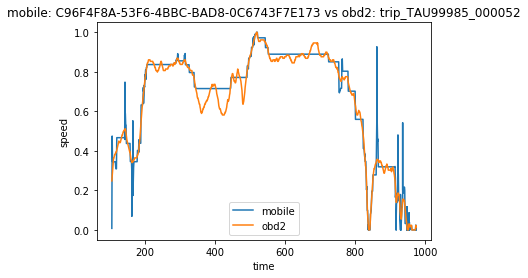

start point 1496747717.0015 105.434
end point 1496748663.0001 973.477
similarity distance 3.2214086752467885


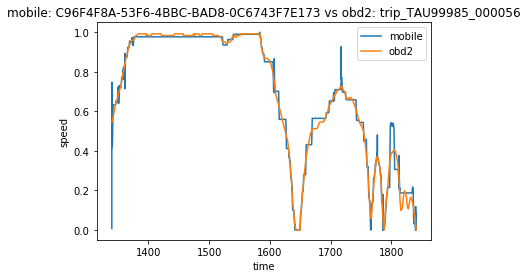

start point 1496747717.0015 1339.739
end point 1496748663.0001 1840.902
similarity distance 2.2677733556816038


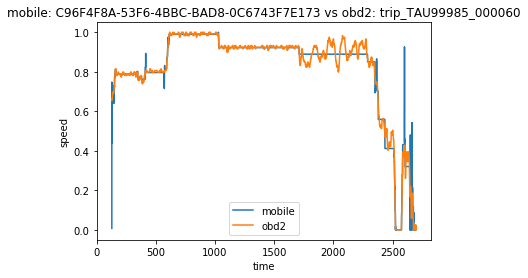

start point 1496747717.0015 127.827
end point 1496748663.0001 2700.001
similarity distance 3.772398893380785


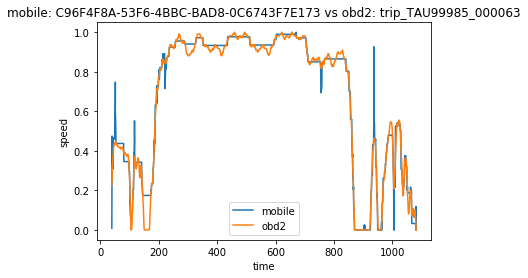

start point 1496747717.0015 38.993
end point 1496748663.0001 1081.929
similarity distance 2.5485963475523667


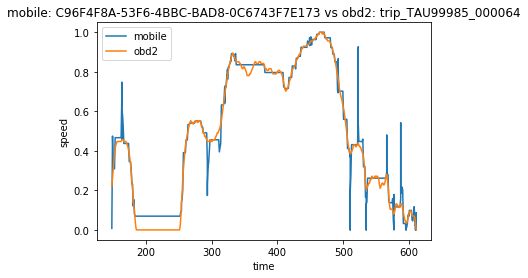

start point 1496747717.0015 148.381
end point 1496748663.0001 610.745
similarity distance 3.5517284351698626


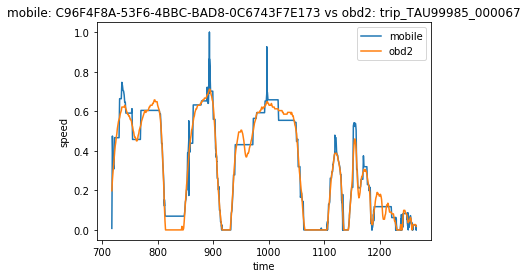

start point 1496747717.0015 717.446
end point 1496748663.0001 1264.947
similarity distance 1.8822106165899946


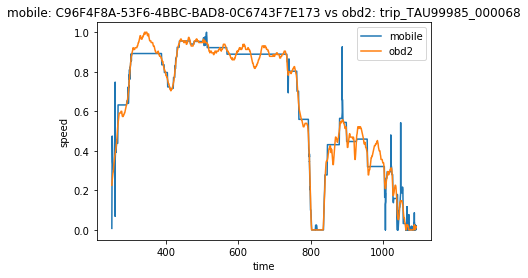

start point 1496747717.0015 250.615
end point 1496748663.0001 1091.848
similarity distance 2.7677609348069376


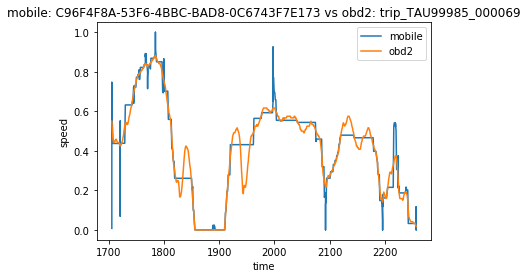

start point 1496747717.0015 1705.936
end point 1496748663.0001 2256.314
similarity distance 2.5874124865840273


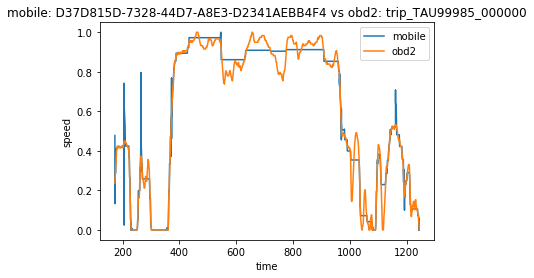

start point 1496778545 172.558
end point 1496779206.0001 1244.412
similarity distance 2.5038731197075874


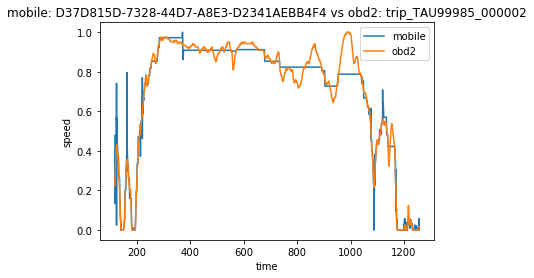

start point 1496778545 116.834
end point 1496779206.0001 1257.255
similarity distance 2.942760949202274


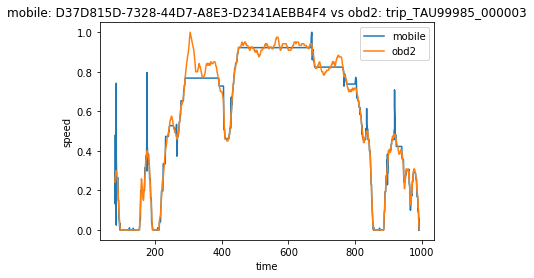

start point 1496778545 79.524
end point 1496779206.0001 992.377
similarity distance 2.6872777041424696


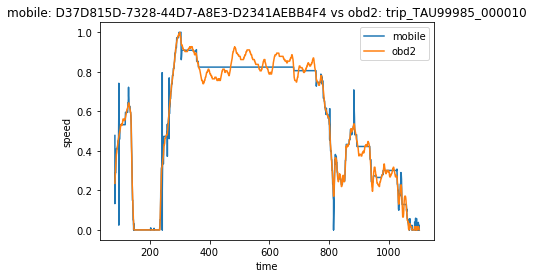

start point 1496778545 83.251
end point 1496779206.0001 1100.959
similarity distance 2.671280426988597


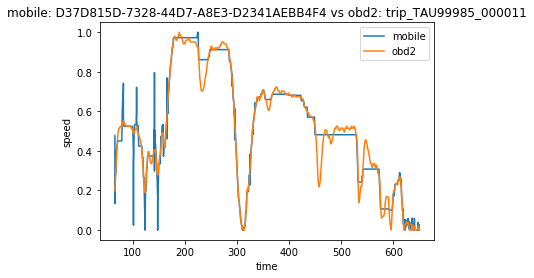

start point 1496778545 65.468
end point 1496779206.0001 649.657
similarity distance 2.4287359187546462


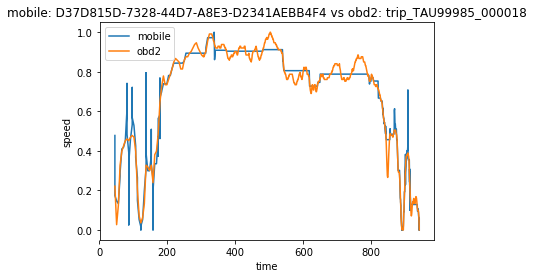

start point 1496778545 46.001
end point 1496779206.0001 940.843
similarity distance 2.8574247379342155


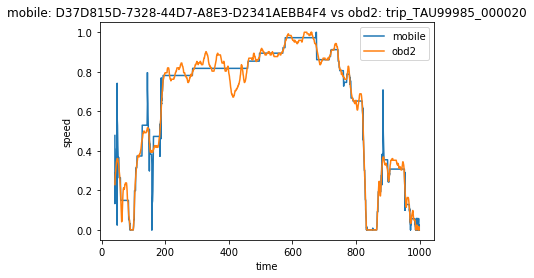

start point 1496778545 42.035
end point 1496779206.0001 998.784
similarity distance 3.1838636796370126


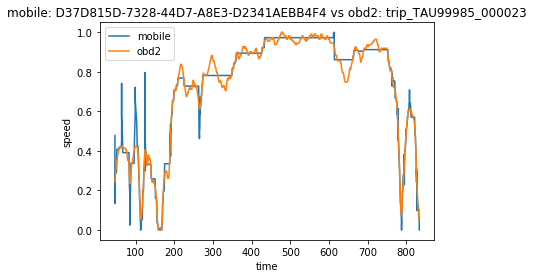

start point 1496778545 46.6
end point 1496779206.0001 833.395
similarity distance 2.0747596351271795


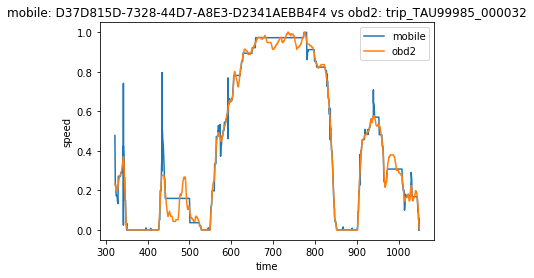

start point 1496778545 321.583
end point 1496779206.0001 1049.473
similarity distance 2.423330964250567


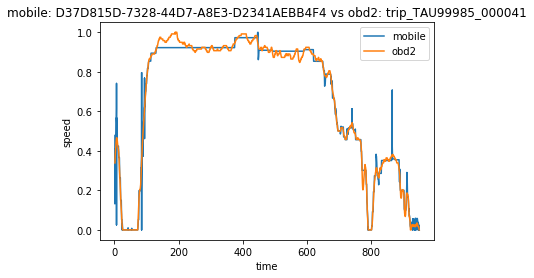

start point 1496778545 1.356
end point 1496779206.0001 949.386
similarity distance 2.9346017179167885


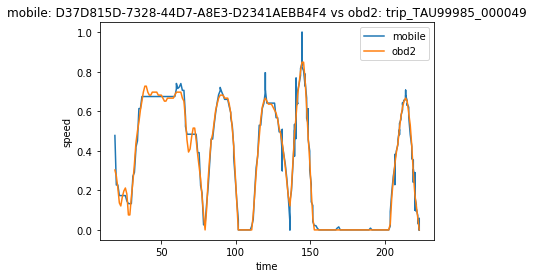

start point 1496778545 18.675
end point 1496779206.0001 223.319
similarity distance 1.0286837802341384


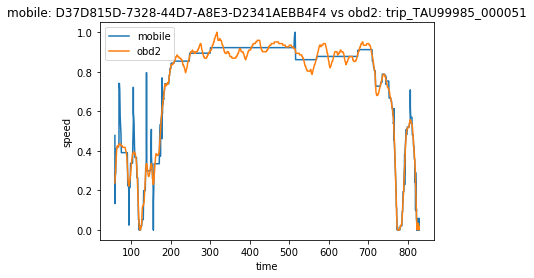

start point 1496778545 58.858
end point 1496779206.0001 829.49
similarity distance 2.2499996335519814


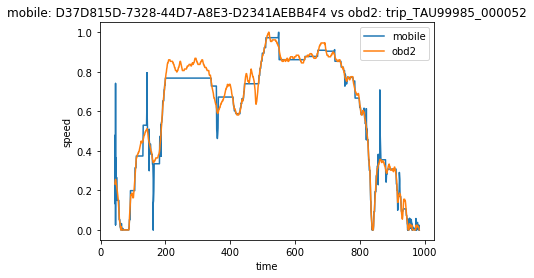

start point 1496778545 44.306
end point 1496779206.0001 982.754
similarity distance 3.418715479040986


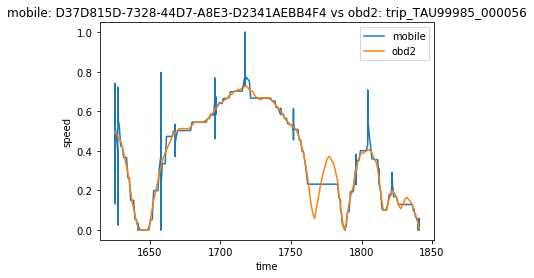

start point 1496778545 1625.238
end point 1496779206.0001 1840.902
similarity distance 2.949461900163165


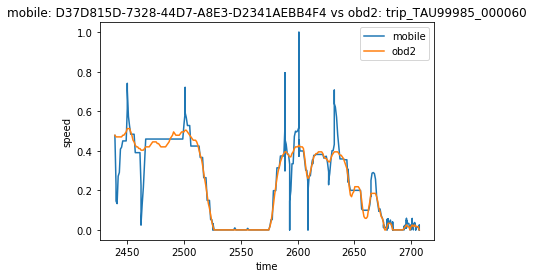

start point 1496778545 2438.945
end point 1496779206.0001 2707.229
similarity distance 4.169741325008889


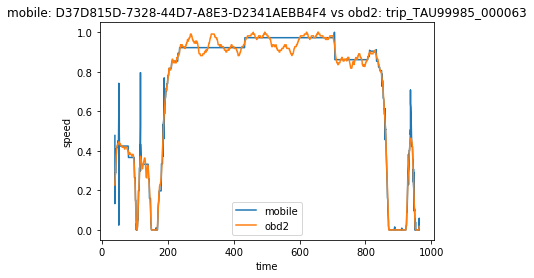

start point 1496778545 38.993
end point 1496779206.0001 963.46
similarity distance 2.338063714481466


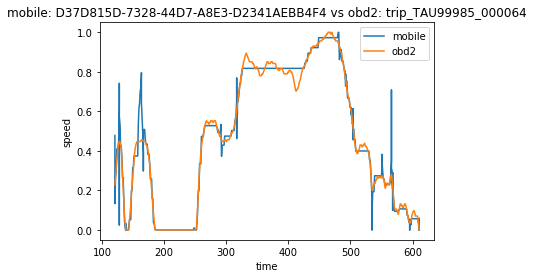

start point 1496778545 120.782
end point 1496779206.0001 610.745
similarity distance 3.4030860529659472


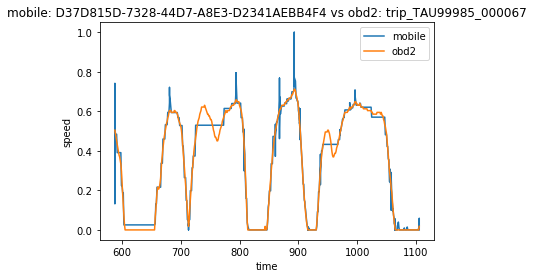

start point 1496778545 588.236
end point 1496779206.0001 1105.381
similarity distance 1.5805924777044593


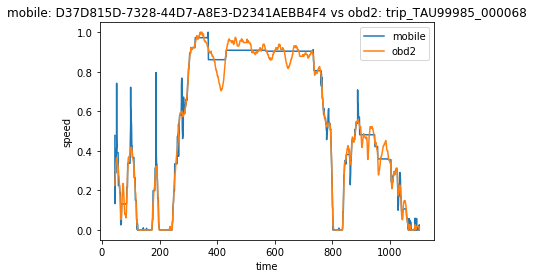

start point 1496778545 44.958
end point 1496779206.0001 1101.148
similarity distance 2.3119893608939512


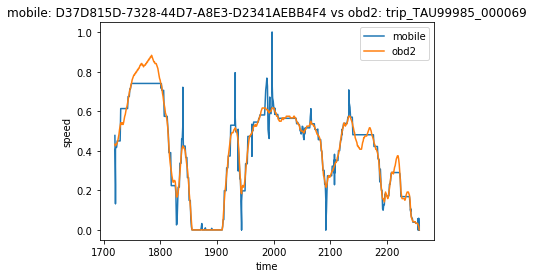

start point 1496778545 1720.036
end point 1496779206.0001 2257.28
similarity distance 2.5767711025587325


In [57]:
output= []

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    
    x1 = [value['timestamp'] for value in mobile[i] if value['accuracy'] < 100]
    y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 100]
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    if sum(y1)==0 and np.var(y1)<0.1:
        continue
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]
        
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))

        if sum(y2)==0 and np.var(y2)<0.1:
            continue

        # search optimal sub path
        p, d = dtw_subsequence_path(y1, y2) 
        
        
        # take the index
        mobile_index= [o[0] for o in p]
        obd2_index= [o[1] for o in p]        
        
        
        # make plot
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        
        plt.plot([x2[i] for i in obd2_index], [y1[i] for i in mobile_index] , label='mobile')
        plt.plot([x2[i] for i in obd2_index], [y2[i] for i in obd2_index], label='obd2')
        
        plt.legend()
        plt.savefig(path + 'Root_project/figure/' + mobile_id +'-'+ obd2_id)
        plt.show()
        
        # save start and end time
        print('start point', x1[p[0][0]], x2[p[0][1]])
        print('end point', x1[p[-1][0]], x2[p[-1][1]])
        print('similarity distance', d)
        
        # save start and end time
        ids= [mobile_id, obd2_id]
        start_time= [x1[p[0][0]], x2[p[0][1]]]
        end_time= [x1[p[-1][0]], x2[p[-1][1]]]
        
        output.append([ids, start_time, end_time])
        

In [63]:
with open(path + 'Root_project/matched_interval.txt', 'w') as outfile:
    json.dump(tuple(output), outfile)

## output

1. figures: a series of plots, each corresponding to a matched trip, with two lines plotted on it: the OBDII speed profile and the mobile speed profile. The time axes would be scaled to a common time and use the OBDII timestamp as the reference.

2. a list of matched intervals, [(mobile_trip_id, obd2_trip_id), (mobile_start_timestampe, obd2_start_timestamp), (mobile_end_timestamp, obd2_end_timestamp)]

#### rewrite my code in object-oriented programming way

In [54]:
import pdb
from tslearn.metrics import dtw_subsequence_path
class pair (object):
    def __init__(self, mobile, obd2_time, obd2_speed,threshold=None,scaling = False):
        self.obd2_time = obd2_time
        self.obd2_speed = obd2_speed
        self.optim_path = None
        self.dist = None
        self.__populate_mobile(mobile,threshold,scaling)
    
    def __populate_mobile(self, mobile,threshold=None,scaling=False):
        self.mobile_speed = []
        self.mobile_time  = []
        for point in mobile:
            accuracy = point['accuracy']
            if threshold is not None and accuracy > threshold:
                continue
            self.mobile_speed.append(point['speed'])
            self.mobile_time.append(point['timestamp'])
        if scaling:
            self.__scaling()

    def __scaling(self):
        self.mobile_speed = np.asarray(self.mobile_speed)
        self.obd2_speed = np.asarray(self.obd2_speed)
        self.mobile_speed = \
            self.mobile_speed - min(self.mobile_speed)/ (max(self.mobile_speed)-min(self.mobile_speed))
        self.obd2_speed = \
            self.obd2_speed - min(self.obd2_speed)/ (max(self.obd2_speed)-min(self.obd2_speed))
    
    def calculate(self, threshold=None, scaling=False):
        self.optim_path, self.dist = dtw_subsequence_path(self.mobile_speed,self.obd2_speed)
        

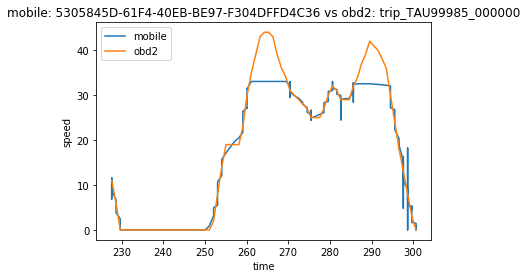

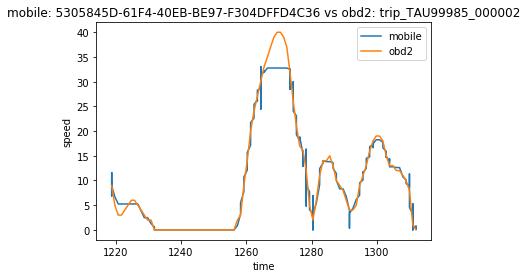

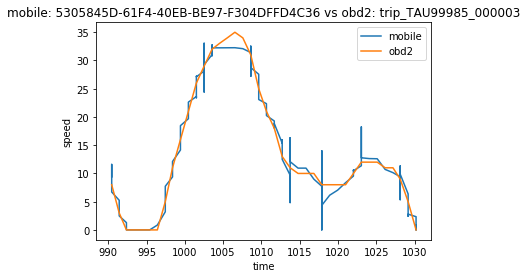

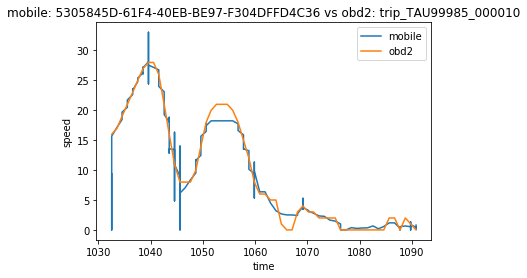

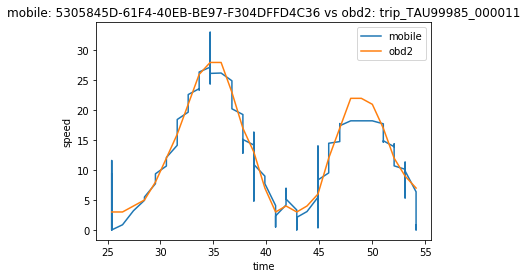

...

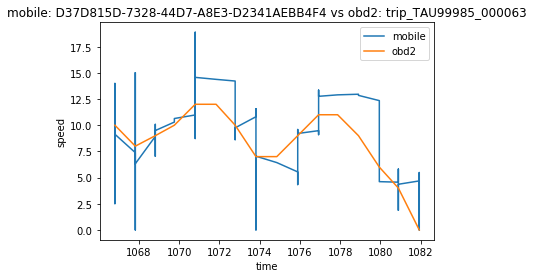

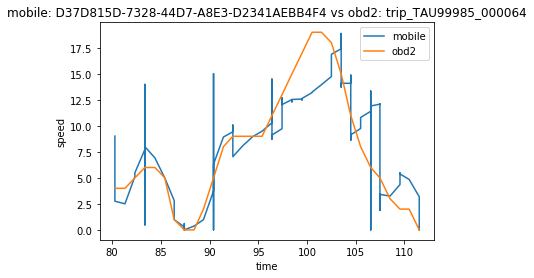

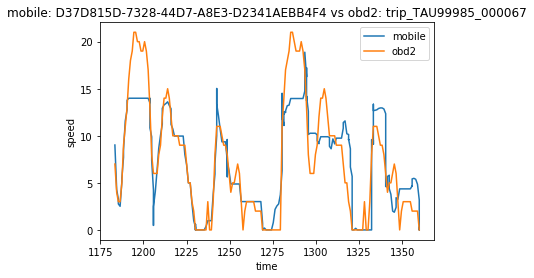

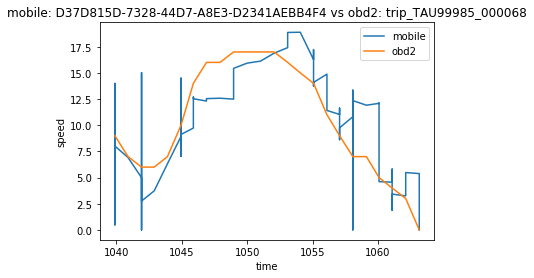

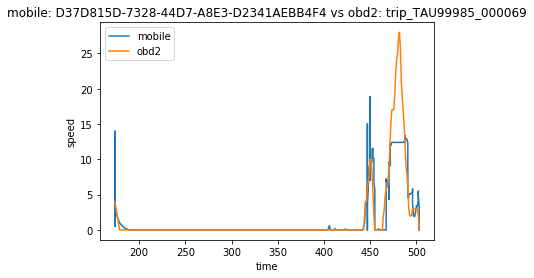

In [56]:
output= []


for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    x1 = [value['timestamp'] for value in mobile[i]]
    y1 = [value['speed'] for value in mobile[i]]
    if False:
        y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
        y1= np.asarray(y1)
        y1= (y1-min(y1))/(max(y1)-min(y1))
    
    if sum(y1)==0 and np.var(y1)<0.1:
        continue
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]
        
        
        curr_pair = pair(mobile[i],x2,y2,threshold = 17.5, scaling = True)
        curr_pair.calculate()
        
        if False:
            y2= np.asarray(y2)
            y2= (y2-min(y2))/(max(y2)-min(y2))

            if sum(y2)==0 and np.var(y2)<0.1:
                continue

            # search optimal sub path
            p, d = dtw_subsequence_path(y1, y2) 
        
        p,d = curr_pair.optim_path, curr_pair.dist
        
        # take the index
        mobile_index= [o[0] for o in p]
        obd2_index= [o[1] for o in p]
        
        # make plot
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        
        plt.plot([x2[i] for i in obd2_index], [y1[i] for i in mobile_index] , label='mobile')
        plt.plot([x2[i] for i in obd2_index], [y2[i] for i in obd2_index], label='obd2')
        
        plt.legend()
        #plt.savefig(path + 'Root_project/figure/' + mobile_id +'-'+ obd2_id)
        plt.show()
        
        
        # save start and end time
        ids= [mobile_id, obd2_id]
        start_time= [x1[p[0][0]], x2[p[0][1]]]
        end_time= [x1[p[-1][0]], x2[p[-1][1]]]
        
        output.append([ids, start_time, end_time])
        